<a href="https://colab.research.google.com/github/Lim-Calculus/Deep-Learning-Specialization/blob/main/LeNet-5%20and%20CNNs%20in%20MNIST.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# LENET-5 

In [1]:
import tensorflow as tf

Import CIFAR10 datasets & Preprocessing : import_cifar10_datasets()

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
import timeit
import gc
gc.collect()

print("Using TensorFlow version %s" % tf.__version__)

Using TensorFlow version 2.8.0


## Import MNIST datasets : import_mnist_datasets(n_valid = 2000)

In [3]:
def import_mnist_datasets(n_valid = 2000):
  tf.keras.backend.clear_session()
  gc.collect()
  
  (x_train, y_train), (x_test, y_test) = tf.keras.datasets.mnist.load_data()

## Splitting the datasets into x_train,x_test, and x_val (training,testing and validation datasets)
## Split the datasets into training datasets, testing datasets and validation datasets
## Training datasets : 58000 image samples
## Validation datasets : 2000 image samples
## Testing datasets : 10000 image samples

  x_train = tf.expand_dims(x_train, axis=3, name=None)
  x_test  = tf.expand_dims(x_test, axis=3, name= None)
  x_train = tf.repeat(x_train, 3, axis=3)
  x_test  = tf.repeat(x_test,3, axis=3, name=None)


  x_val   = x_train[-2000:,:,:,:]
  x_train = x_train[:-2000,:,:,:]

  y_val   = y_train[-2000:]
  y_train = y_train[:-2000]


  ## Display warning if the dimensions are incorrect
  assert(x_train.shape ==(58000,28,28,3)),"Incorrect x_train dimensions"
  assert(x_val.shape ==(2000,28,28,3)),"Incorrect x_val dimensions"
  assert(x_test.shape ==(10000,28,28,3)),"Incorrect x_test dimensions"

  # One-hot encoding 
  y_train = tf.keras.utils.to_categorical(y_train)
  y_test  = tf.keras.utils.to_categorical(y_test)
  y_val   = tf.keras.utils.to_categorical(y_val)

  
  print(f"x_train.shape = {x_train.shape}")
  print(f"x_val.shape = {x_val.shape}")
  print(f"x_test.shape = {x_test.shape}")
  print(f"y_train.shape = {y_train.shape}")
  print(f"y_val.shape = {y_val.shape}")
  print(f"y_test.shape = {y_test.shape}")

 

  if n_valid > 0 :
    assert x_train.shape == (60000-n_valid,28,28,3), "Incorret x_train.shape"
    assert x_val.shape == (n_valid,28,28,3) , "Incorret x_val.shape"
    assert x_test.shape == (10000,28,28,3),"Incorret x_test.shape"

    assert y_train.shape == (60000-n_valid,10),"Incorrect y_train.shape"
    assert y_val.shape == (n_valid,10), "Incorrect y_val.shape"
    assert y_test.shape == (10000,10),"Incorrect y_test.shape"
    return x_train,y_train,x_val,y_val,x_test,y_test
  else:
    assert x_train.shape == (60000, 28, 28, 3), "Incorret x_train.shape"
    assert x_test.shape == (10000, 28, 28, 3),"Incorret x_test.shape"
    assert y_train.shape == (60000, 10),"Incorrect y_train.shape"
    assert y_test.shape == (10000, 10),"Incorrect y_test.shape"
    assert x_val.shape == (10000, 28, 28, 3),"Incorret x_val.shape"
    assert y_val.shape == (10000,10),"Incorrect y_tval.shape"
    return x_train,y_train,x_test,y_test,x_test,y_test

x_train,y_train,x_val,y_val,x_test,y_test = import_mnist_datasets(n_valid=2000)
print(f"x_train.shape = {x_train.shape}")
print(f"x_val.shape = {x_val.shape}")
print(f"x_test.shape = {x_test.shape}")
print(f"y_train.shape = {y_train.shape}")
print(f"y_val.shape = {y_val.shape}")
print(f"y_test.shape = {y_test.shape}")

11501568/11490434 [==============================] - 0s 0us/step
x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)
x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


## Functions for Ploting 25 images from Training, Validation,Testing and Predictions Image : plotTrainImages(), plotValImages(), plotTestImages(), predictTestImages()

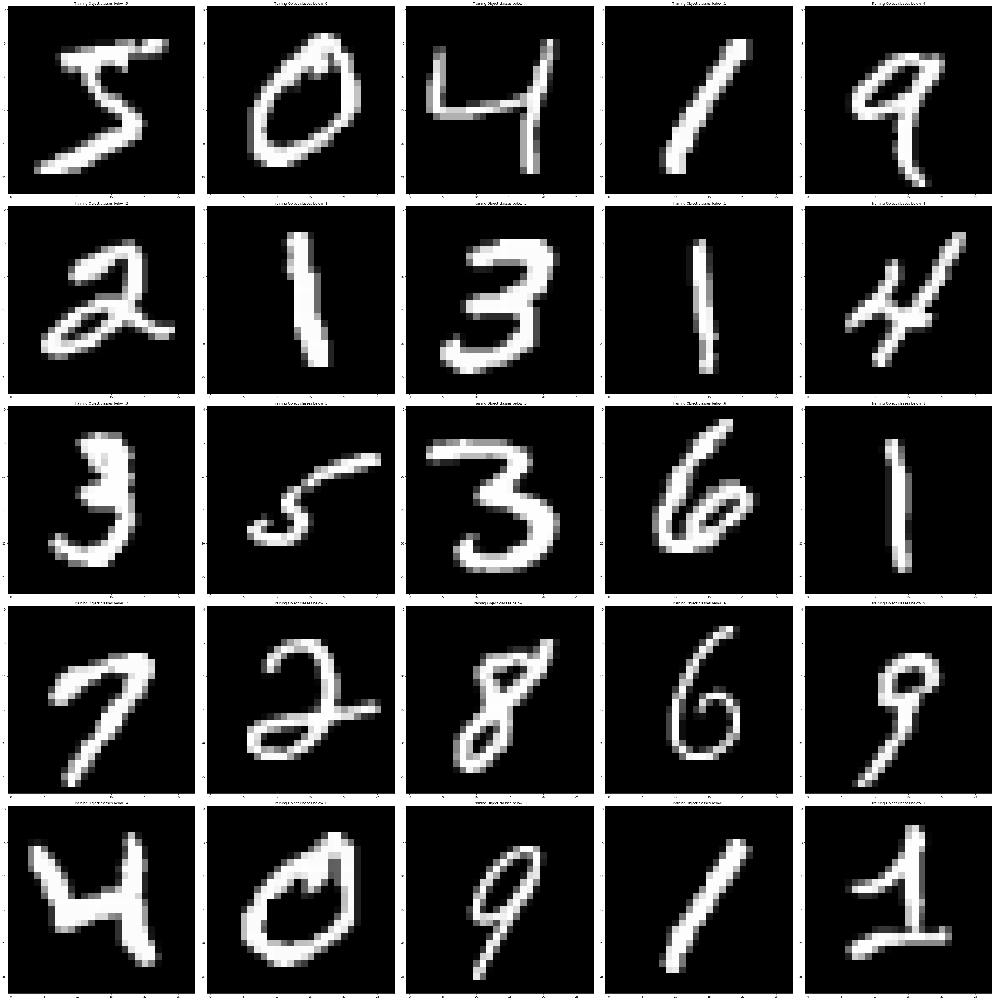

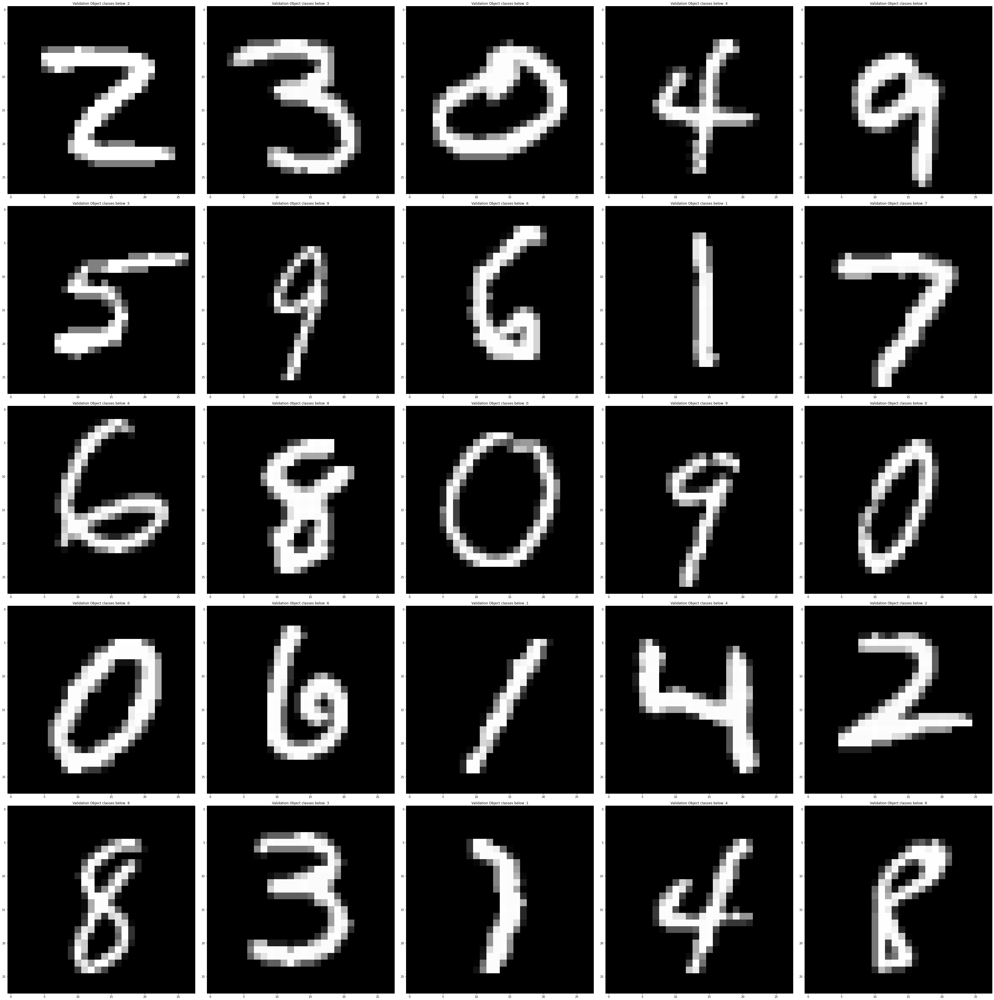

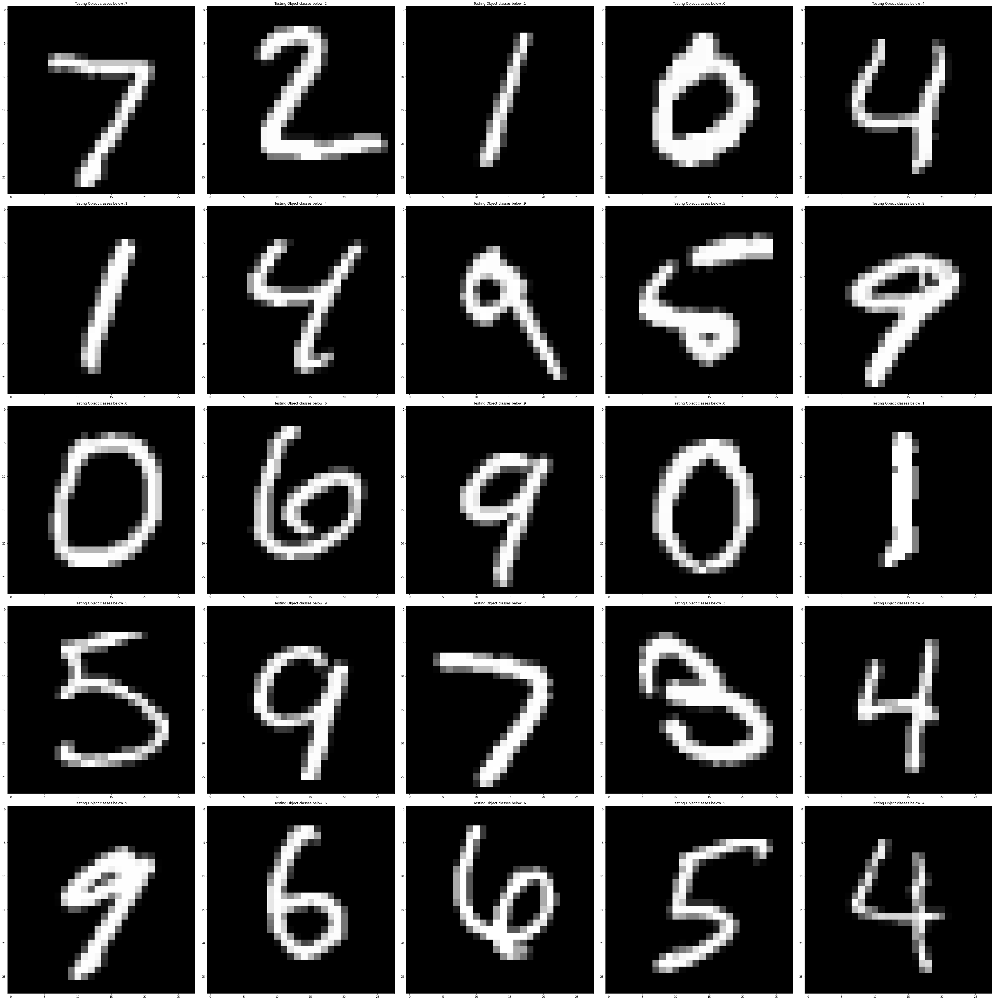

In [4]:
import numpy as np
import matplotlib.pyplot as plt 
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()
cm_classes=['0','1','2','3','4','5','6','7','8','9']
# This function will plot images in the form of a grid with 1 row and 5 columns where images are placed in each column.
# Plotting Training Images 5 x 5 images (25 images)
def plotTrainImages(x_train=x_train,y_train=y_train):   
    fig, axes = plt.subplots(5, 5, figsize=(50,50))    
    axes = axes.flatten()
    for i in range(len(x_train)):
        axes[i].title.set_text(f"Training Object classes below :{cm_classes[int(np.argmax(y_train[i,:], axis=0))]}")
        axes[i].imshow(x_train[i])
    plt.tight_layout()    
    plt.show()

# Plotting Validation Images 5 x 5 images (25 images)
def plotValImages(x_val=x_val,y_val=y_val):   
    fig, axes = plt.subplots(5, 5, figsize=(50,50))    
    axes = axes.flatten()
    for i in range(len(x_val)):
        axes[i].title.set_text(f"Validation Object classes below :{cm_classes[int(np.argmax(y_val[i,:], axis=0))]}")
        axes[i].imshow(x_val[i])
    plt.tight_layout()    
    plt.show()

# Plotting Testing Images 5 x 5 images (25 images)
def plotTestImages(x_test=x_test,y_test=y_test):   
    fig, axes = plt.subplots(5, 5, figsize=(50,50))    
    axes = axes.flatten()
    for i in range(len(x_test)):
        axes[i].title.set_text(f"Testing Object classes below :{cm_classes[int(np.argmax(y_test[i,:], axis=0))]}")
        axes[i].imshow(x_test[i])
    plt.tight_layout()    
    plt.show()

# Plotting Prediction Images 5 x 5 images (25 images) 
# Title : Model predicted label and True label
def predictTestImages(model,x_test=x_test,y_test=y_test):   
    fig, axes = plt.subplots(5, 5, figsize=(50,50))    
    axes = axes.flatten()
    for i in range(len(x_test)):
        axes[i].title.set_text(f"Predicted Object classes below,y_pred :{cm_classes[int(np.argmax(model.predict(x_test[i].reshape(-1,28,28,3)), axis=1))]}, True Object Classes below, y_true: {cm_classes[int(np.argmax(y_test[i,:], axis=0))]}")
        axes[i].imshow(x_test[i])
    plt.tight_layout()    
    plt.show()

plotTrainImages(x_train=x_train[:25,:,:,:]/255,y_train=y_train[:25,:])
plotValImages(x_val=x_val[:25,:,:,:]/255,y_val=y_val[:25,:])
plotTestImages(x_test=x_test[:25,:,:,:]/255,y_test=y_test[:25,:])
##predictTestImages(model=Alex_TL_model,x_test=x_test[:25,:,:,:].reshape(-1,32,32,3),y_test=y_test[:25])

## LeNet-5 Model : LeNet5(learning_rate = 0.001)


In [5]:
## Declare Resize and Rescale Layer : Resize first, then rescale
import tensorflow as tf
resize_and_rescale = tf.keras.Sequential([tf.keras.layers.Resizing(32,32, interpolation="bilinear", crop_to_aspect_ratio=True,input_shape=x_train.shape[1:],name="Resizing_Layer"),
                                         tf.keras.layers.Rescaling(1./255)])

def LeNet5(learning_rate=0.001):

    ### LeNet Architecture (The ancestor of convolutional neural networks and is a well-known model among the computer vision community.)
  ###Creating a Sequential model (Conv-> Pool -> Sigmoid -> Conv -> Pool -> Sigmoid -> Flatten(Flatten the input before propogate to FC) -> FC -> FC -> Output)
  LeNet_model = tf.keras.models.Sequential()

  ## Input Layer, input_shape=(32,32,3)
  LeNet_model.add(tf.keras.layers.InputLayer(input_shape=x_train.shape[1:]))
  ## Set the input size to 32 x 32 x 3
  LeNet_model.add(resize_and_rescale)

  ## Convolutional Layer with 6 filter, the size of the filter is 5x5, with the activation function of tanh ( hyperbolic tangent function)
  LeNet_model.add(tf.keras.layers.Conv2D(6,5, activation='tanh'))

  ## Average pooling with pool size of (2,2), strides = 2
  LeNet_model.add(tf.keras.layers.AveragePooling2D(2,2))

  ## Add a Sigmoid non-linearity after Average pooling
  LeNet_model.add(tf.keras.layers.Activation('sigmoid'))

  ## Convolutional Layer with 16 filter, the size of the filter is 5x5, with the activation function of tanh ( hyperbolic tangent function) 
  LeNet_model.add(tf.keras.layers.Conv2D(16, 5, activation='tanh'))

  ## Average pooling with pool size of (2,2), strides  = 2
  LeNet_model.add(tf.keras.layers.AveragePooling2D(2,2))

  ## Add a Sigmoid non-linearity after Average pooling
  LeNet_model.add(tf.keras.layers.Activation('sigmoid'))

  ## Flatten the input before connected to Fully Connected Layer 
  LeNet_model.add(tf.keras.layers.Flatten())

  ## Fully Connected Layer (FC) with 120 neurons, activation function of tanh ( hyperbolic tangent function)
  LeNet_model.add(tf.keras.layers.Dense(120,activation='tanh'))

  ## Fully Connected Layer (FC) with 84 neurons, activation function of tanh ( hyperbolic tangent function)
  LeNet_model.add(tf.keras.layers.Dense(84, activation='tanh'))

  ## Output layer with number of classes (0-9) and activation function of softmax
  LeNet_model.add(tf.keras.layers.Dense(10, activation='softmax'))

  ## Print the model summary()
  LeNet_model.summary()  
  LeNet_model.compile(loss="categorical_crossentropy",   # Loss function
                         optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),        # Optimization technique
                         metrics=['accuracy']) # Accuracy matrix
    
  return LeNet_model


## Train Model function : train_LeNet_model()



              train_LeNet_model(learning_rate = LEARNING_RATE,
                data_augmentation=True,
                epochs=10,
                model = "LeNet-5",
                methods = "DA",
                datasets = "MNIST",
                batch_size = 64,
                x_train = x_train,
                y_train = y_train,
                x_val = x_val,
                y_val = y_val,
                x_test = x_test,
                y_test = y_test,
                logs_dir = LOGS_DIR)

In [6]:
## Default Setting (learning rate = 1e-3, training epochs = 10, batch size = 64, Methods = "DA", Datasets = "MNIST")
LEARNING_RATE = 0.001
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "LeNet-5"
METHODS = "DA"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{METHODS}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{METHODS}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{METHODS}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with {METHODS} and learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{METHODS}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{METHODS}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

In [7]:
def train_LeNet_model(learning_rate = LEARNING_RATE,
                data_augmentation=True,
                epochs=10,
                model = "LeNet-5",
                methods = "DA",
                datasets = "MNIST",
                batch_size = 64,
                x_train = x_train,
                y_train = y_train,
                x_val = x_val,
                y_val = y_val,
                x_test = x_test,
                y_test = y_test,
                logs_dir = LOGS_DIR):
  ## Data Augmentation
## Rotating the image randomly by 10 degrees using the rotation_range parameter.
## Translating the image randomly horizontally or vertically by a 0.1 factor of the image's width or height using the width_shift_range and the height_shift_range parameters.
## Applying shear-based transformations randomly using the shear_range parameter
  ## Data Augmentation
# Augmentation
  from tensorflow.keras.preprocessing.image import ImageDataGenerator
  train_datagen = ImageDataGenerator(rotation_range=10,  # rotation 10 degrees
                                   width_shift_range=0.1,  # horizontal shift
                                   height_shift_range=0.1,
                                   zoom_range=0.2,  # zoom                                   
                                   )

  train_datagen.fit(x_train)
  logger=tf.keras.callbacks.TensorBoard( 
    log_dir=logs_dir,
    histogram_freq=5,
    write_graph=True
    )

  LeNet_model = LeNet5(learning_rate = learning_rate)

  if data_augmentation == True:
    
    
    LeNet_history = LeNet_model.fit_generator(train_datagen.flow(x_train,y_train, batch_size = batch_size), 
                                             epochs = epochs,
                                             shuffle=True,
                                             callbacks=[logger], 
                                             validation_data = (x_val,y_val),
                                             steps_per_epoch=len(x_train)//batch_size,
                                             validation_steps=len(x_val)//batch_size)
    LeNet_model.evaluate(x_test,y_test)
  else:
  
    LeNet_history = LeNet_model.fit(x_train,y_train, batch_size = batch_size, 
                                             epochs = epochs,
                                             shuffle=True,
                                             callbacks=[logger], 
                                             validation_data = (x_val,y_val)
                                            )
    ## AlexNet model Evaluation: Accuracy and Crossentropy Loss
  print("LeNet-5 Model Evaluation, Accuracy and Loss")
  LeNet_model.evaluate(x_test,y_test,verbose=1)
   
  print("Saving LeNet-5 Model and weights ....")      
  # Declare Saved Model filename in h5py
  SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
  SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Save LeNet-5 model's trained weights 
  LeNet_model.save_weights(SAVED_WEIGHT)

# Save AlexNet_model's trained model 
  LeNet_model.save(SAVED_MODEL)
  print(f"{SAVED_MODEL} and {SAVED_WEIGHT} saved to disk.")  
    

 

  return LeNet_model,LeNet_history

##Alex_TL_model,Alex_history = train_model(Alex_TL_model = Alex_TL_model,
                ##learning_rate = learning_rate,
                ##data_augmentation=True,
                ##epochs=10,
                ##model = "AlexNet",
                ##methods = "Transfer Learning + DA",
                ##datasets = "CIFAR10",
                ##batch_size=64,
               ## x_train = x_train,
                ##y_train = y_train,
                ##x_val = x_val,
                ##y_val = y_val,
                ##x_test = x_test,
                ##y_test = y_test)
  




## Define Model Evaluation Function : evaluation()
    evaluation(model = model_saved,title = title,x_test = x_test,y_test=y_test):

In [8]:
import itertools
import numpy as np
import sklearn
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.metrics import plot_confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import roc_auc_score, auc, roc_curve
from sklearn.metrics import plot_confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import roc_auc_score, auc, roc_curve

def evaluation(model = SAVED_MODEL,title = CONFUSION_MATRIX_TITLE,x_test = x_test,y_test=y_test):
## Load the Trained Model
    CNN_model = tf.keras.models.load_model(model)

## Make Prediction for the test datasets
    predictions=CNN_model.predict(x_test)

## Convert from one-hot(2D) encoding to 1D
    predictions=np.argmax(predictions, axis=1)
    labels=np.argmax(y_test, axis=1)
    confusion_matrix = tf.math.confusion_matrix(labels=labels, predictions=predictions)
    confusion_matrix_original = confusion_matrix
    confusion_matrix = confusion_matrix.numpy()

    def precision(label, confusion_matrix):
        col = confusion_matrix[:, label]
        return confusion_matrix[label, label] / col.sum()
    
    def recall(label, confusion_matrix):
        row = confusion_matrix[label, :]
        return confusion_matrix[label, label] / row.sum()

    def precision_macro_average(confusion_matrix):
        rows, columns = confusion_matrix.shape
        sum_of_precisions = 0
        for label in range(rows):
            sum_of_precisions += precision(label, confusion_matrix)
        return float(sum_of_precisions / rows)

    def recall_macro_average(confusion_matrix):
        rows, columns = confusion_matrix.shape
        sum_of_recalls = 0
        for label in range(columns):
            sum_of_recalls += recall(label, confusion_matrix)
        return float(sum_of_recalls / columns)

    def F1(label,confusion_matrix):      
        F1=2*(precision(label,confusion_matrix)*(recall(label,confusion_matrix)))/(precision(label,confusion_matrix)+recall(label,confusion_matrix))
        return F1

    print("label precision recall F1")
    for label in range(10):
        print(f"{label:5d} {precision(label, confusion_matrix):9.3f} {recall(label, confusion_matrix):6.3f} {F1(label,confusion_matrix):6.3f}")

    def F1_macro_average(confusion_matrix):
        rows,columns = confusion_matrix.shape
        sum_of_F1=0
        for label in range(rows):
            sum_of_F1+=F1(label,confusion_matrix)        
        return float(sum_of_F1/columns)

    print("precision total:", precision_macro_average(confusion_matrix))

    print("recall total:", recall_macro_average(confusion_matrix))

    print("F1 total:", F1_macro_average(confusion_matrix))

    def accuracy(confusion_matrix):
        diagonal_sum = confusion_matrix.trace()
        sum_of_all_elements = confusion_matrix.sum()
        return diagonal_sum / sum_of_all_elements 

    cm_classes=['0','1','2','3','4','5','6','7','8','9']

    def plot_confusion_matrix(cm, classes,
                        normalize=False,
                        title=title):
    ##"""
    ##This function prints and plots the confusion matrix.
    ##Normalization can be applied by setting `normalize=True`.
    ##"""
        import matplotlib.pyplot as plt
        plt.rcParams["figure.figsize"] = (15,15)
        plt.imshow(cm, interpolation='nearest',  cmap=plt.cm.Blues)
        plt.title(title)
        plt.colorbar()
        tick_marks = np.arange(len(classes))
        plt.xticks(tick_marks, classes, rotation=45)
        plt.yticks(tick_marks, classes)

        if normalize:
            cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
            print("Normalized confusion matrix")
        else:
            print('Confusion matrix, without normalization')

        print(cm)

        thresh = cm.max() / 2.
        for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
            plt.text(j, i, cm[i, j],
                horizontalalignment="center",
                color="white" if cm[i, j] > thresh else "black")

        plt.tight_layout()
        plt.ylabel('True label')
        plt.xlabel('Predicted label')

    

    import sklearn
    from sklearn import metrics
    predictions=CNN_model.predict(x_test)

    predictions=CNN_model.predict(x_test)
    ##predictions_list=[]
    ##predictions_list=[[1 if predictions[j][i]>0.5 else 0 for i in range(10)] for j in range(10000)]
    predictions=np.argmax(predictions, axis=1)
    labels=np.argmax(y_test, axis=1)
    report = sklearn.metrics.classification_report(labels, predictions, digits=3)
    print(report)

    # Compute ROC curve and ROC area for each class
    ### roc_curve and auc is only support for one-hot encoding 
    import matplotlib.pyplot as plt

    disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix,display_labels=cm_classes)
    disp.plot()
    plt.title(title)
    plt.show()
    from sklearn.preprocessing import label_binarize
    from scipy import interp
    from itertools import cycle
    fpr = dict()
    tpr = dict()
    predictions=CNN_model.predict(x_test)
    roc_auc = dict()
    for i in range(10):
        fpr[i], tpr[i], _ = roc_curve(y_test[:,i]
                                  , predictions[:,i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Compute micro-average ROC curve and ROC area
    fpr["micro"], tpr["micro"], _ = roc_curve(y_test.ravel(),predictions.ravel())
    roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

    n_classes=10
    lw=3
    # First aggregate all false positive rates
    all_fpr = np.unique(np.concatenate([fpr[i] for i in range(n_classes)]))

# Then interpolate all ROC curves at this points
    mean_tpr = np.zeros_like(all_fpr)
    for i in range(n_classes):
        mean_tpr += interp(all_fpr, fpr[i], tpr[i])

# Finally average it and compute AUC
    mean_tpr /= n_classes

    fpr["macro"] = all_fpr
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

    # Plot all ROC curves
    plt.figure()
    plt.plot(
    fpr["micro"],
    tpr["micro"],
    label="micro-average ROC curve (area = {0:0.2f})".format(roc_auc["micro"]),
    color="deeppink",
    linestyle=":",
    linewidth=4,
    )

    plt.plot(
    fpr["macro"],
    tpr["macro"],
    label="macro-average ROC curve (area = {0:0.2f})".format(roc_auc["macro"]),
    color="navy",
    linestyle=":",
    linewidth=4,
    )

    colors = cycle(["aqua", "darkorange", "cornflowerblue"])
    for i, color in zip(range(n_classes), colors):
        plt.plot(
        fpr[i],
        tpr[i],
        color=color,
        lw=lw,
        label="ROC curve of class {0} (area = {1:0.2f})".format(i, roc_auc[i]),
        )

    plt.plot([0, 1], [0, 1], "k--", lw=lw)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("Some extension of Receiver operating characteristic to multiclass")
    plt.legend(loc="lower right")
    plt.show()
    ## Plot confusion Matrix
    plot_confusion_matrix(cm=confusion_matrix,classes=cm_classes,title=title)

## Plot Training and Validation Function : plot_LeNet_graph()
    plot_LeNet_graph(LeNet_history, train_title = PLOT_TITLE[0], val_title = PLOT_TITLE[1])

In [9]:
def plot_LeNet_graph(LeNet_history, train_title = PLOT_TITLE[0], val_title = PLOT_TITLE[1]):
  import matplotlib.pyplot as plt
  fig, axs = plt.subplots(2, 1, figsize=(15,15))
  axs[0].plot(LeNet_history.history['loss'])
  axs[0].plot(LeNet_history.history['val_loss'])
  axs[0].title.set_text('Training Loss vs Validation Loss')
  axs[0].set_xlabel('Epochs')
  axs[0].set_ylabel('Loss')
  axs[0].legend([train_title, val_title])
  axs[1].plot(LeNet_history.history['accuracy'])
  axs[1].plot(LeNet_history.history['val_accuracy'])
  axs[1].title.set_text('Training Accuracy vs Validation Accuracy')
  axs[1].set_xlabel('Epochs')
  axs[1].set_ylabel('Accuracy')
  axs[1].legend([train_title, val_title])

##plot_graph(Alex_history = Alex_history, train_title = plot_title[0], val_title = plot_title[1])

## Full function : train_and_evaluate_LeNet_mnist()

In [10]:
import keras.backend as K
def train_and_evaluate_LeNet_mnist(learning_rate=0.001,
                               model = "LeNet-5 + DA",                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               method=METHODS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = True):
  
  ## Import datasets and split it to training, testing and validation datasets
  x_train,y_train,x_val,y_val,x_test,y_test = import_mnist_datasets(n_valid=2000)  
  
  ## Plot 25 Training, Validation and Testing Images   
  plotTrainImages(x_train=x_train[:25,:,:,:]/255,y_train=y_train[:25,:])
  plotValImages(x_val=x_val[:25,:,:,:]/255,y_val=y_val[:25,:])
  plotTestImages(x_test=x_test[:25,:,:,:]/255,y_test=y_test[:25,:])
  
  print(f"Is data augmentation applied : {data_augmentation}") 

 
  
# Declare Saved Model filename in h5py
  SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
  SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
  LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
  CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
  PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]
  
  LeNet_model = LeNet5(               
               learning_rate = LEARNING_RATE,
              )
  print(f"Model learning rate is set to :{K.eval(LeNet_model.optimizer.lr)}")
  ## Train Model
  LeNet_model,LeNet_history = train_LeNet_model(
                learning_rate = LEARNING_RATE,
                data_augmentation=data_augmentation,
                epochs=EPOCHS,
                model = MODEL,
                methods = METHODS,
                datasets = DATASETS,
                batch_size= BATCH_SIZE,
                x_train = x_train,
                y_train = y_train,
                x_val = x_val,
                y_val = y_val,
                x_test = x_test,
                y_test = y_test,
                logs_dir = LOGS_DIR)
  
  ## Plot graph
  plot_LeNet_graph(LeNet_history = LeNet_history, train_title = PLOT_TITLE[0], val_title = PLOT_TITLE[1])

  ## Model Evaluations
  evaluation(model=SAVED_MODEL,title=CONFUSION_MATRIX_TITLE,x_test = x_test,y_test=y_test)

  ## Plot predicted test images
  predictTestImages(model = LeNet_model,x_test = x_test[:25,:,:,:],y_test=y_test[:25,:])




In [11]:
print(x_train.shape)
print(x_test.shape)

(58000, 28, 28, 3)
(10000, 28, 28, 3)


##  Data Augmentation

In [33]:
## Data Augmentation
# Augmentation
from tensorflow.keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator(rotation_range=10,  # rotation 10 degrees
                                   width_shift_range=0.1,  # horizontal shift
                                   height_shift_range=0.1,
                                   zoom_range=0.2,  # zoom                                   
                                   )

train_datagen.fit(x_train)

# CNN

## CNN Model : CNN(learning_rate = 0.001)

In [13]:
## Declare Resize and Rescale Layer : Resize first, then rescale
import tensorflow as tf
resize_and_rescale = tf.keras.Sequential([tf.keras.layers.Resizing(32,32, interpolation="bilinear", crop_to_aspect_ratio=True,input_shape=x_train.shape[1:],name="Resizing_Layer"),
                                         tf.keras.layers.Rescaling(1./255)])

def CNN(learning_rate=0.001):

   ### CNN Architecture (I try to modify theconvolutional neural networks and is a well-known model among the computer vision community.)
###Creating a Sequential model (Conv-> Pool  -> Conv -> Pool -> Flatten(Flatten the input before propogate to FC) -> FC -> FC -> Output)
  CNN_model = tf.keras.models.Sequential()

## Input Layer, input_shape=(32,32,3)
  CNN_model.add(tf.keras.layers.InputLayer(input_shape=x_train.shape[1:]))

## Set the input size to 32 x 32 x 1
  CNN_model.add(resize_and_rescale)

## Convolutional Layer with 6 filter, the size of the filter is 5x5, with the activation function of tanh ( rectified linear unit function)
  CNN_model.add(tf.keras.layers.Conv2D(6,5, activation='relu'))

## Average pooling with pool size of (2,2), strides = 2
  CNN_model.add(tf.keras.layers.MaxPooling2D(pool_size=(2,2),strides=2))

## Convolutional Layer with 16 filter, the size of the filter is 5x5, with the activation function of relu ( rectified linear unit function) 
  CNN_model.add(tf.keras.layers.Conv2D(16, 5, activation='relu'))

## Average pooling with pool size of (2,2), strides  = 2
  CNN_model.add(tf.keras.layers.MaxPooling2D(pool_size=2,strides=2))


## Flatten the input before connected to Fully Connected Layer 
  CNN_model.add(tf.keras.layers.Flatten())

## Fully Connected Layer (FC) with 120 neurons, activation function of relu (rectified linear unit function)
  CNN_model.add(tf.keras.layers.Dense(120,activation='relu'))

## Fully Connected Layer (FC) with 84 neurons, activation function of relu (rectified linear unit function)
  CNN_model.add(tf.keras.layers.Dense(84, activation='relu'))

## Output layer with number of classes (0-9) and activation function of softmax
  CNN_model.add(tf.keras.layers.Dense(10, activation='softmax'))

## Print the model summary()
  CNN_model.summary()

  CNN_model.compile(loss="categorical_crossentropy",   # Loss function
                         optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate),        # Optimization technique
                         metrics=['accuracy']) # Accuracy matrix

  return CNN_model

## Plot Training and Validation Function : plot_CNN_graph()
    plot_CNN_graph(CNN_history, train_title = PLOT_TITLE[0], val_title = PLOT_TITLE[1])

In [14]:
def plot_CNN_graph(CNN_history, train_title = PLOT_TITLE[0], val_title = PLOT_TITLE[1]):
  import matplotlib.pyplot as plt
  fig, axs = plt.subplots(2, 1, figsize=(15,15))
  axs[0].plot(CNN_history.history['loss'])
  axs[0].plot(CNN_history.history['val_loss'])
  axs[0].title.set_text('Training Loss vs Validation Loss')
  axs[0].set_xlabel('Epochs')
  axs[0].set_ylabel('Loss')
  axs[0].legend([train_title, val_title])
  axs[1].plot(CNN_history.history['accuracy'])
  axs[1].plot(CNN_history.history['val_accuracy'])
  axs[1].title.set_text('Training Accuracy vs Validation Accuracy')
  axs[1].set_xlabel('Epochs')
  axs[1].set_ylabel('Accuracy')
  axs[1].legend([train_title, val_title])

##plot_graph(Alex_history = Alex_history, train_title = plot_title[0], val_title = plot_title[1])

In [15]:
## Default CNN setting (learning rate = 1e-3, epochs =10, batch size = 54, model = "CNN", methods = "DA", datasets = "MNIST")
LEARNING_RATE = 0.001
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "CNN"
METHODS = "DA"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

## Train Model function : train_CNN_model()



              train_CNN_model(learning_rate = LEARNING_RATE,
                data_augmentation=True,
                epochs=10,
                model = "CNN",
                methods = "DA",
                datasets = "MNIST",
                batch_size = 64,
                x_train = x_train,
                y_train = y_train,
                x_val = x_val,
                y_val = y_val,
                x_test = x_test,
                y_test = y_test,

In [16]:
def train_CNN_model(learning_rate = LEARNING_RATE,
                data_augmentation=True,
                epochs=10,
                model = "CNN",
                methods = "DA",
                datasets = "MNIST",
                batch_size = 64,
                x_train = x_train,
                y_train = y_train,
                x_val = x_val,
                y_val = y_val,
                x_test = x_test,
                y_test = y_test,
                logs_dir = LOGS_DIR):
  ## Data Augmentation
## Rotating the image randomly by 10 degrees using the rotation_range parameter.
## Translating the image randomly horizontally or vertically by a 0.1 factor of the image's width or height using the width_shift_range and the height_shift_range parameters.
## Applying shear-based transformations randomly using the shear_range parameter
  ## Data Augmentation
# Augmentation
  from tensorflow.keras.preprocessing.image import ImageDataGenerator
  train_datagen = ImageDataGenerator(rotation_range=10,  # rotation 10 degrees
                                   width_shift_range=0.1,  # horizontal shift
                                   height_shift_range=0.1,
                                   zoom_range=0.2,  # zoom                                   
                                   )

  train_datagen.fit(x_train)
  logger=tf.keras.callbacks.TensorBoard( 
    log_dir=logs_dir,
    histogram_freq=5,
    write_graph=True
    )

  CNN_model = CNN(learning_rate = learning_rate)

  if data_augmentation == True:
    
    
    CNN_history = CNN_model.fit_generator(train_datagen.flow(x_train,y_train, batch_size = batch_size), 
                                             epochs = epochs,
                                             shuffle=True,
                                             callbacks=[logger], 
                                             validation_data = (x_val,y_val),
                                             steps_per_epoch=len(x_train)//batch_size,
                                             validation_steps=len(x_val)//batch_size)
    CNN_model.evaluate(x_test,y_test)
  else:
  
    CNN_history = CNN_model.fit(x_train,y_train, batch_size = batch_size, 
                                             epochs = epochs,
                                             shuffle=True,
                                             callbacks=[logger], 
                                             validation_data = (x_val,y_val)
                                            )
    ## AlexNet model Evaluation: Accuracy and Crossentropy Loss
  print("CNN Model Evaluation, Accuracy and Loss")
  CNN_model.evaluate(x_test,y_test,verbose=1)
   
  print("Saving CNN Model and weights ....")      
  # Declare Saved Model filename in h5py
  SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
  SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Save LeNet-5 model's trained weights 
  CNN_model.save_weights(SAVED_WEIGHT)

# Save AlexNet_model's trained model 
  CNN_model.save(SAVED_MODEL)
  print(f"{SAVED_MODEL} and {SAVED_WEIGHT} saved to disk.")  
    

 

  return CNN_model,CNN_history

##Alex_TL_model,Alex_history = train_model(Alex_TL_model = Alex_TL_model,
                ##learning_rate = learning_rate,
                ##data_augmentation=True,
                ##epochs=10,
                ##model = "AlexNet",
                ##methods = "Transfer Learning + DA",
                ##datasets = "CIFAR10",
                ##batch_size=64,
               ## x_train = x_train,
                ##y_train = y_train,
                ##x_val = x_val,
                ##y_val = y_val,
                ##x_test = x_test,
                ##y_test = y_test)
  




In [17]:
import keras.backend as K
def train_and_evaluate_CNN_mnist(learning_rate=0.001,
                               model = "CNN + DA",                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               method=METHODS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = True):
  
  ## Import datasets and split it to training, testing and validation datasets
  x_train,y_train,x_val,y_val,x_test,y_test = import_mnist_datasets(n_valid=2000)  
  
  ## Plot 25 Training, Validation and Testing Images   
  plotTrainImages(x_train=x_train[:25,:,:,:]/255,y_train=y_train[:25,:])
  plotValImages(x_val=x_val[:25,:,:,:]/255,y_val=y_val[:25,:])
  plotTestImages(x_test=x_test[:25,:,:,:]/255,y_test=y_test[:25,:])
  
  print(f"Is data augmentation applied : {data_augmentation}") 

 
  
# Declare Saved Model filename in h5py
  SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
  SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
  LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
  CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
  PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]
  
  CNN_model = CNN(               
               learning_rate = LEARNING_RATE,
              )
  print(f"Model learning rate is set to :{K.eval(CNN_model.optimizer.lr)}")
  ## Train Model
  CNN_model,CNN_history = train_CNN_model(
                learning_rate = LEARNING_RATE,
                data_augmentation=data_augmentation,
                epochs=EPOCHS,
                model = MODEL,
                methods = METHODS,
                datasets = DATASETS,
                batch_size= BATCH_SIZE,
                x_train = x_train,
                y_train = y_train,
                x_val = x_val,
                y_val = y_val,
                x_test = x_test,
                y_test = y_test,
                logs_dir = LOGS_DIR)
  
  ## Plot graph
  plot_CNN_graph(CNN_history = CNN_history, train_title = PLOT_TITLE[0], val_title = PLOT_TITLE[1])

  ## Model Evaluations
  evaluation(model=SAVED_MODEL,title=CONFUSION_MATRIX_TITLE,x_test = x_test,y_test=y_test)

  ## Plot predicted test images
  predictTestImages(model = CNN_model,x_test = x_test[:25,:,:,:],y_test=y_test[:25,:])




# MODEL TRAINING ( LENET-5 MODEL & CNN MODEL )

## Model 1. LeNet-5 WITH DATA AUGMENTATION (LEARNING RATE = 1E-3)


*   learning rate  = 0.001
*   Data Augmentation : True



x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


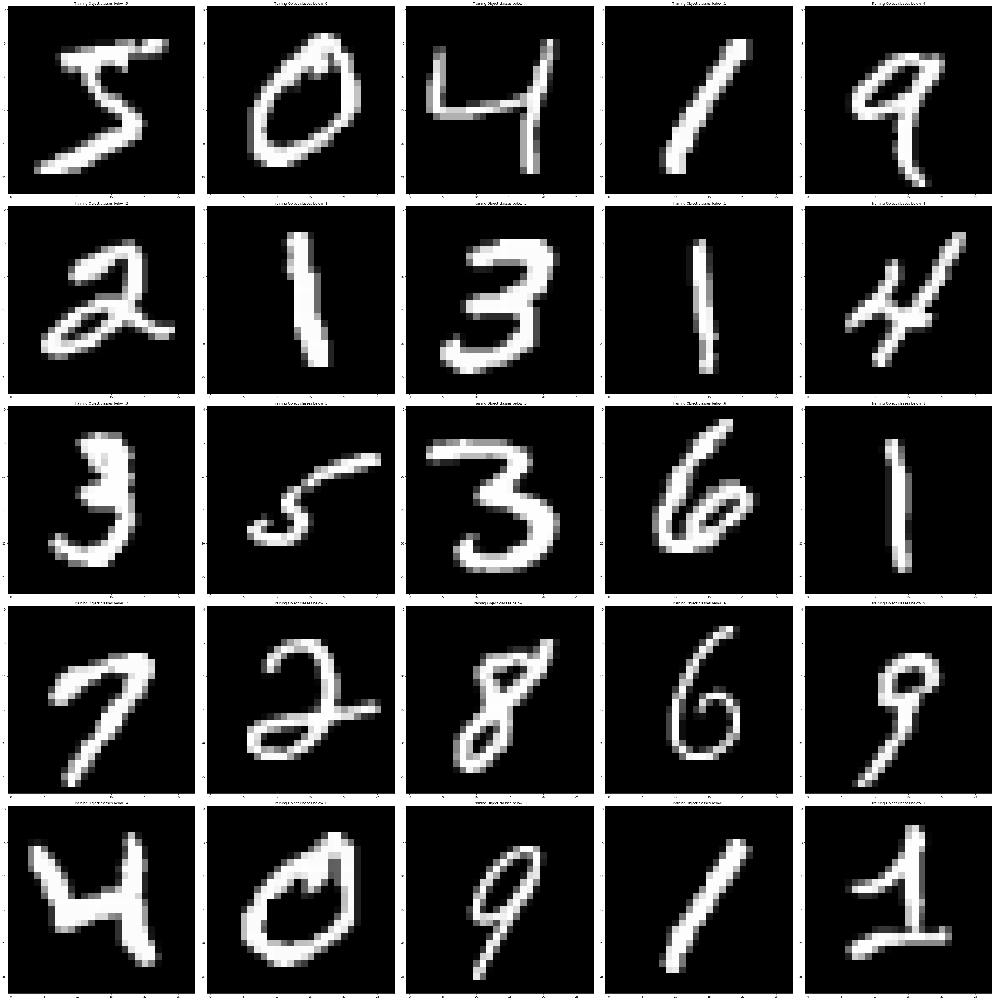

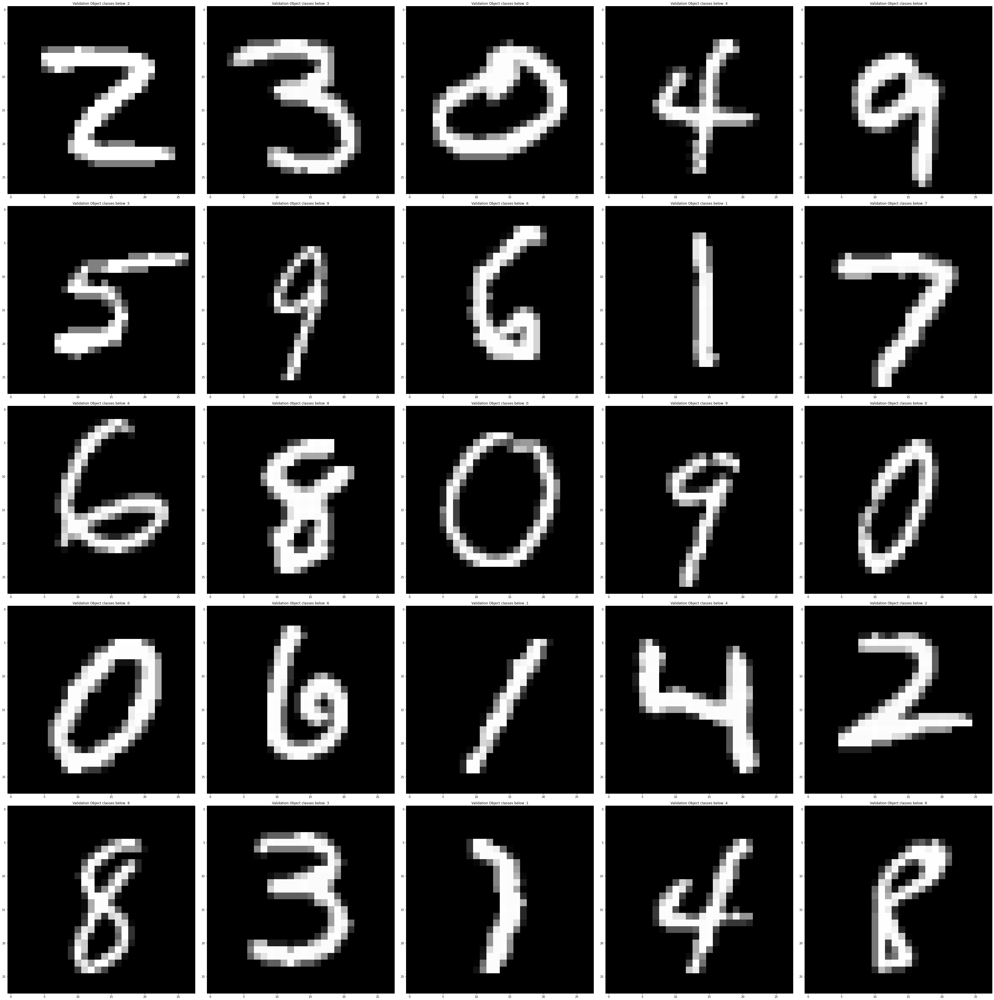

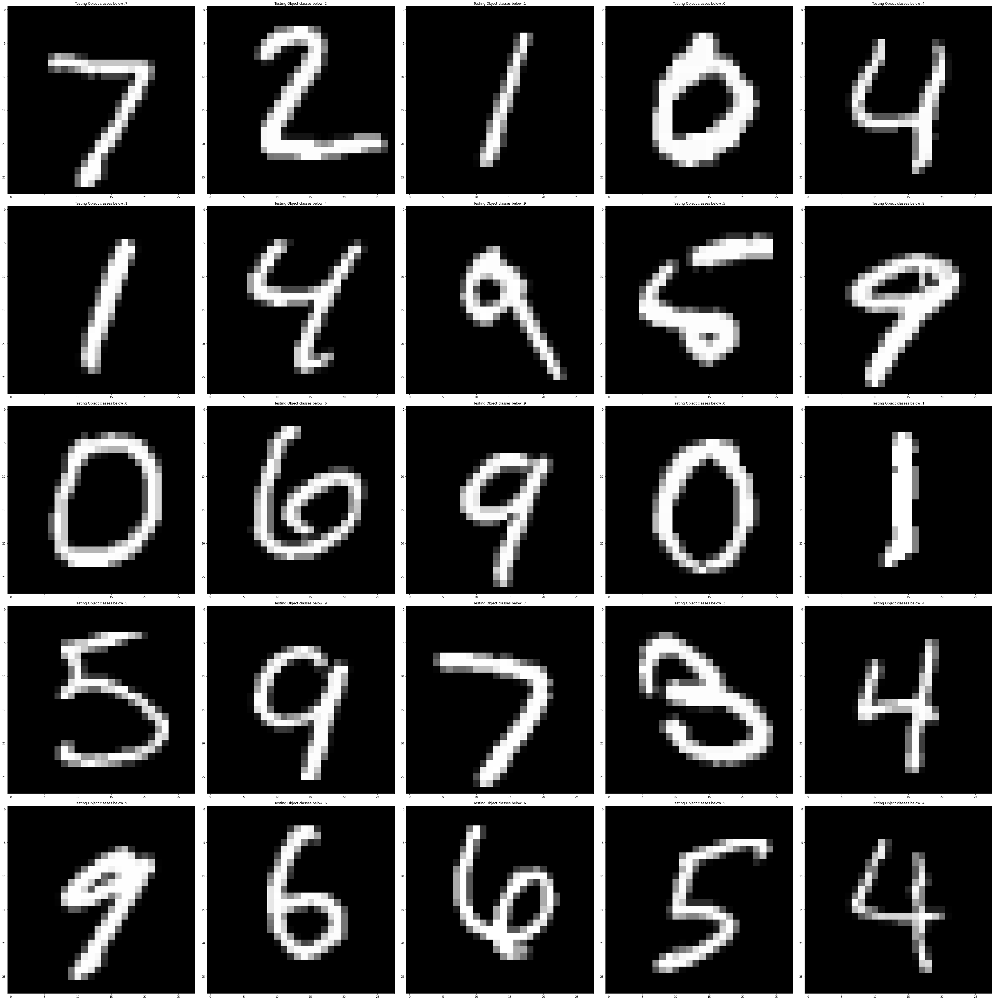

Is data augmentation applied : True
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 average_pooling2d (AverageP  (None, 14, 14, 6)        0         
 ooling2D)                                                       
                                                                 
 activation (Activation)     (None, 14, 14, 6)         0         
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)        

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:46: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


Epoch 1/10
906/906 [==============================] - 37s 28ms/step - loss: 1.4901 - accuracy: 0.4734 - val_loss: 0.4216 - val_accuracy: 0.8980
Epoch 2/10
906/906 [==============================] - 25s 28ms/step - loss: 0.6964 - accuracy: 0.7782 - val_loss: 0.1908 - val_accuracy: 0.9555
Epoch 3/10
906/906 [==============================] - 26s 28ms/step - loss: 0.4095 - accuracy: 0.8718 - val_loss: 0.1478 - val_accuracy: 0.9670
Epoch 4/10
906/906 [==============================] - 25s 28ms/step - loss: 0.3147 - accuracy: 0.9007 - val_loss: 0.1025 - val_accuracy: 0.9735
Epoch 5/10
906/906 [==============================] - 25s 28ms/step - loss: 0.2669 - accuracy: 0.9162 - val_loss: 0.1063 - val_accuracy: 0.9730
Epoch 6/10
906/906 [==============================] - 26s 28ms/step - loss: 0.2450 - accuracy: 0.9221 - val_loss: 0.0934 - val_accuracy: 0.9755
Epoch 7/10
906/906 [==============================] - 25s 28ms/step - loss: 0.2146 - accuracy: 0.9320 - val_loss: 0.0780 - val_accuracy:

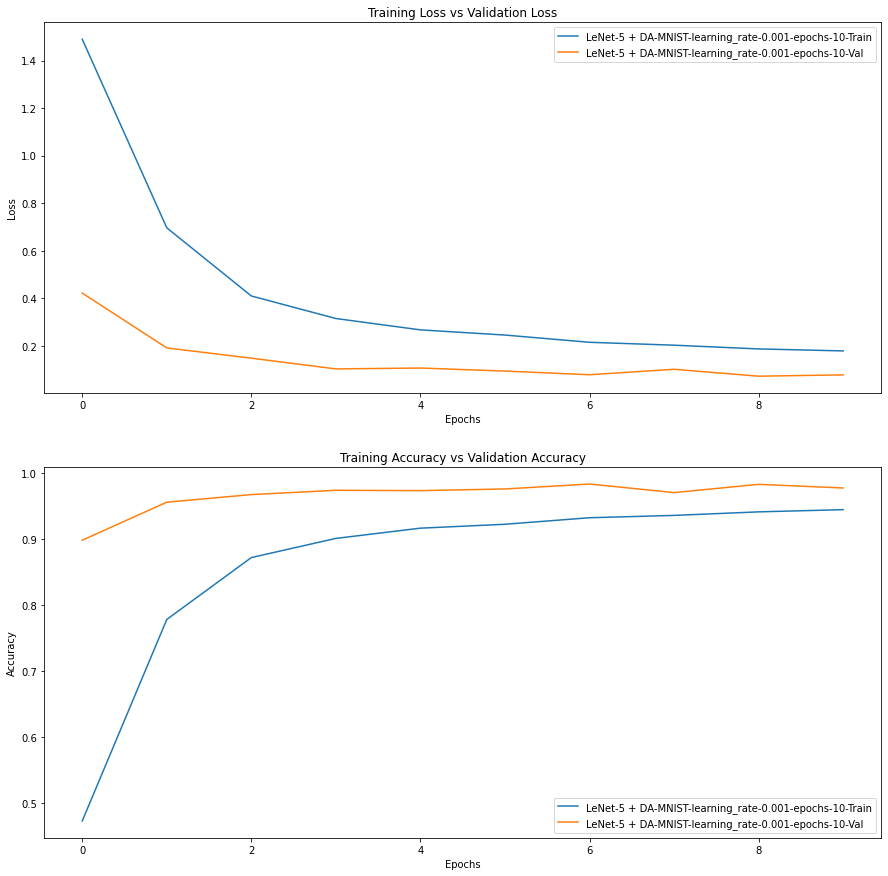

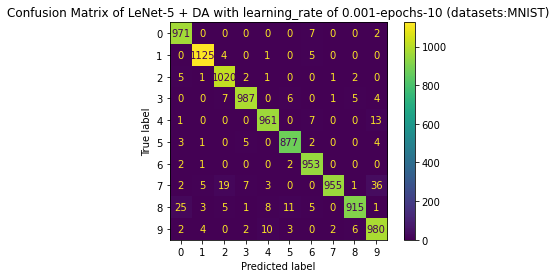

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


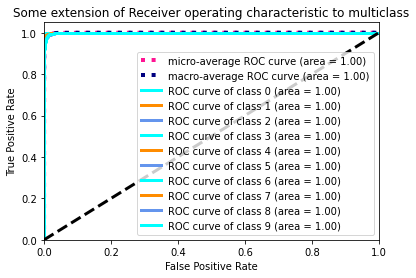

Confusion matrix, without normalization
[[ 971    0    0    0    0    0    7    0    0    2]
 [   0 1125    4    0    1    0    5    0    0    0]
 [   5    1 1020    2    1    0    0    1    2    0]
 [   0    0    7  987    0    6    0    1    5    4]
 [   1    0    0    0  961    0    7    0    0   13]
 [   3    1    0    5    0  877    2    0    0    4]
 [   2    1    0    0    0    2  953    0    0    0]
 [   2    5   19    7    3    0    0  955    1   36]
 [  25    3    5    1    8   11    5    0  915    1]
 [   2    4    0    2   10    3    0    2    6  980]]


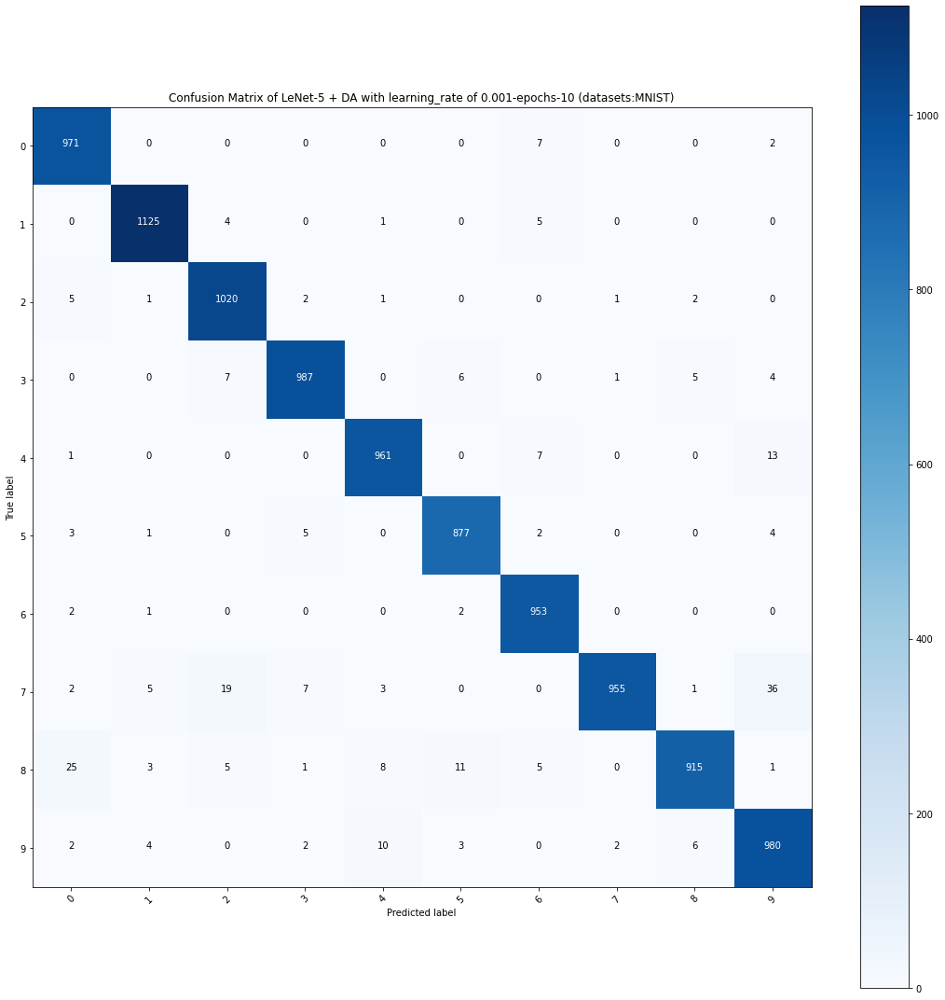

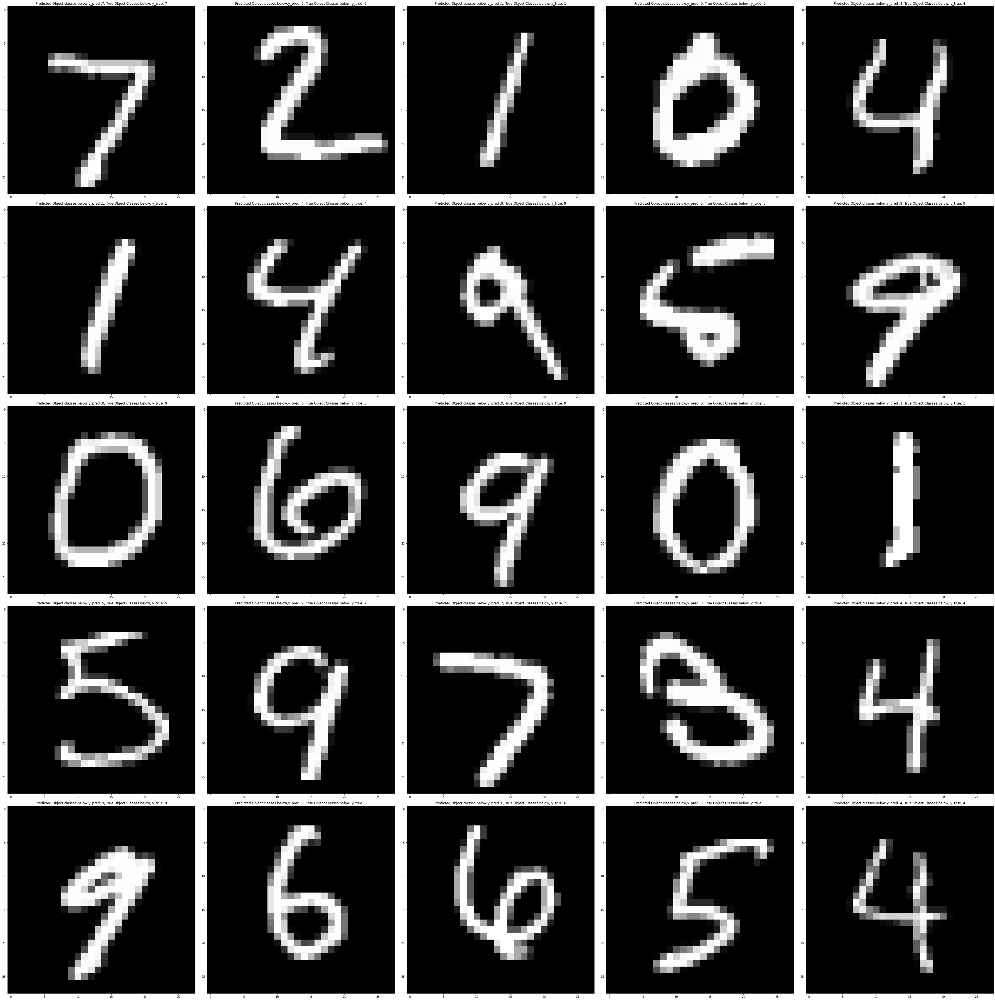

In [18]:
LEARNING_RATE = 0.001
DATA_AUGMENTATION = True
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "LeNet-5 + DA"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{METHODS}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_LeNet_mnist(learning_rate=0.001,
                               model = "LeNet-5 + DA",                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               method=METHODS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 2. CNN WITH DATA AUGMENTATION (LEARNING RATE = 1E-3)


*   learning rate  = 0.001
*   Data Augmentation : True

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


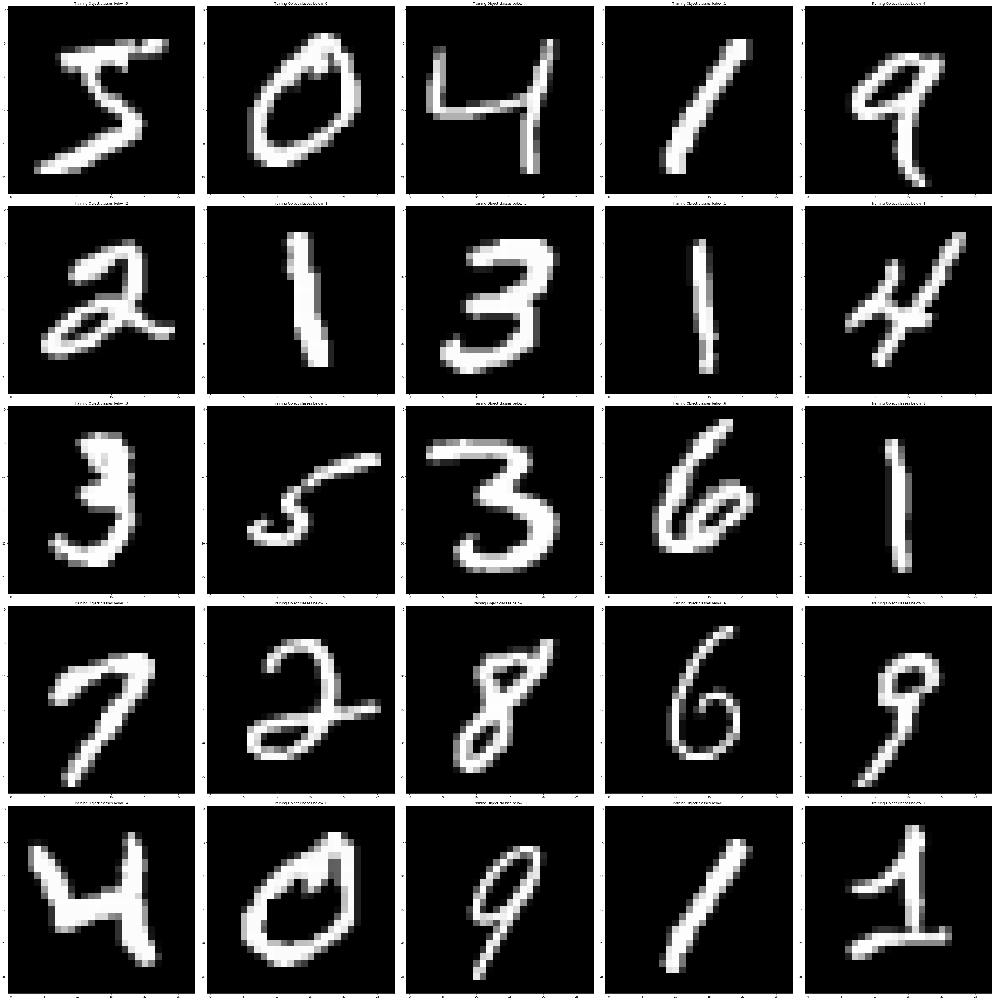

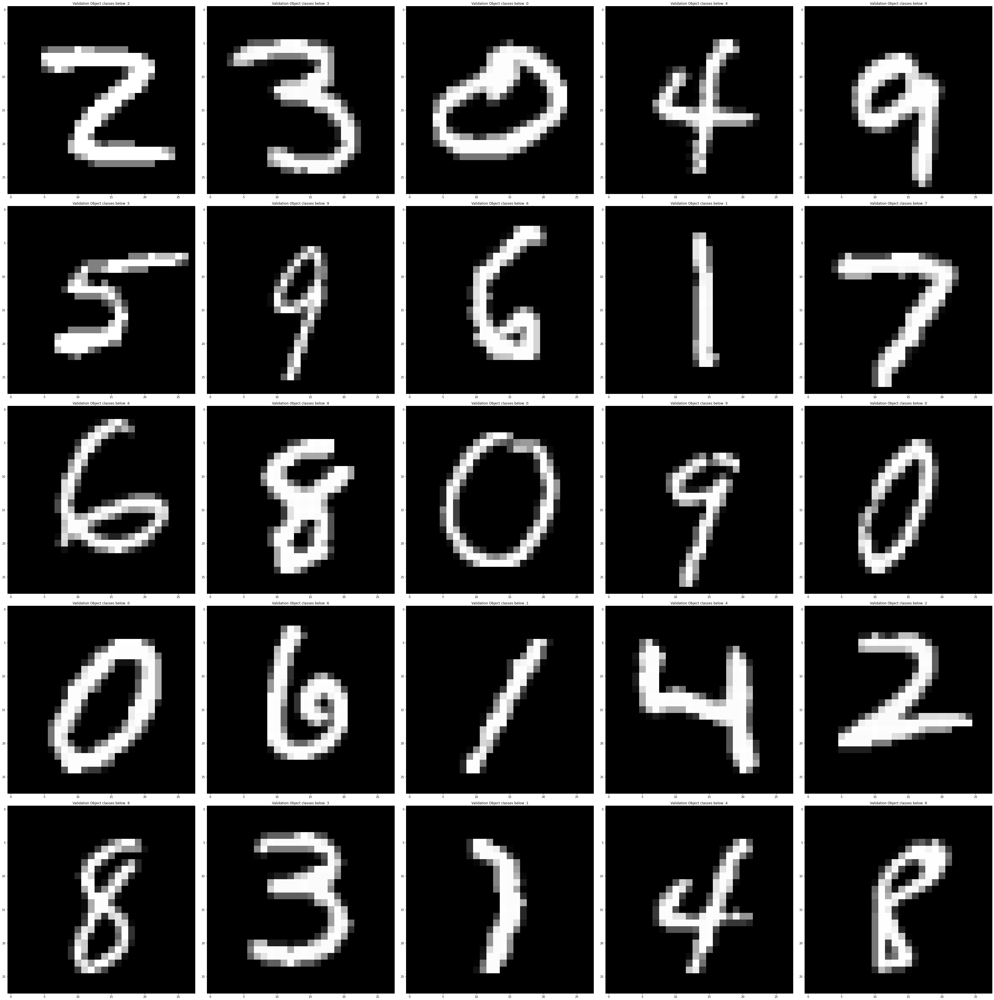

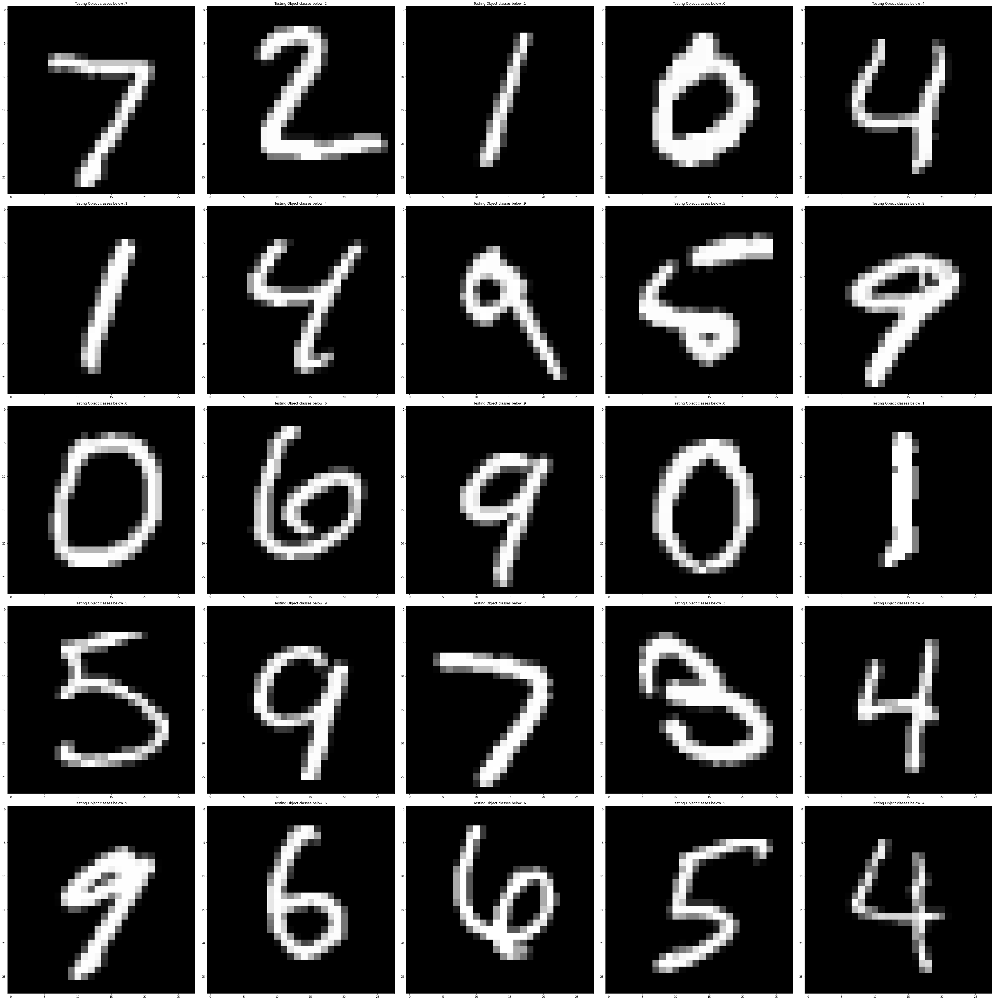

Is data augmentation applied : True
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 6)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 5, 5, 16)         0         
 2D)                                                             
                                                                 
 flatten (Flatten)  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:46: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


906/906 [==============================] - 26s 27ms/step - loss: 0.3986 - accuracy: 0.8739 - val_loss: 0.0663 - val_accuracy: 0.9835
Epoch 2/10
906/906 [==============================] - 25s 27ms/step - loss: 0.1498 - accuracy: 0.9538 - val_loss: 0.0493 - val_accuracy: 0.9875
Epoch 3/10
906/906 [==============================] - 25s 27ms/step - loss: 0.1118 - accuracy: 0.9650 - val_loss: 0.0389 - val_accuracy: 0.9890
Epoch 4/10
906/906 [==============================] - 25s 27ms/step - loss: 0.0956 - accuracy: 0.9706 - val_loss: 0.0367 - val_accuracy: 0.9925
Epoch 5/10
906/906 [==============================] - 25s 27ms/step - loss: 0.0858 - accuracy: 0.9733 - val_loss: 0.0428 - val_accuracy: 0.9895
Epoch 6/10
906/906 [==============================] - 25s 28ms/step - loss: 0.0763 - accuracy: 0.9759 - val_loss: 0.0370 - val_accuracy: 0.9915
Epoch 7/10
906/906 [==============================] - 25s 27ms/step - loss: 0.0696 - accuracy: 0.9782 - val_loss: 0.0408 - val_accuracy: 0.9880
Epo

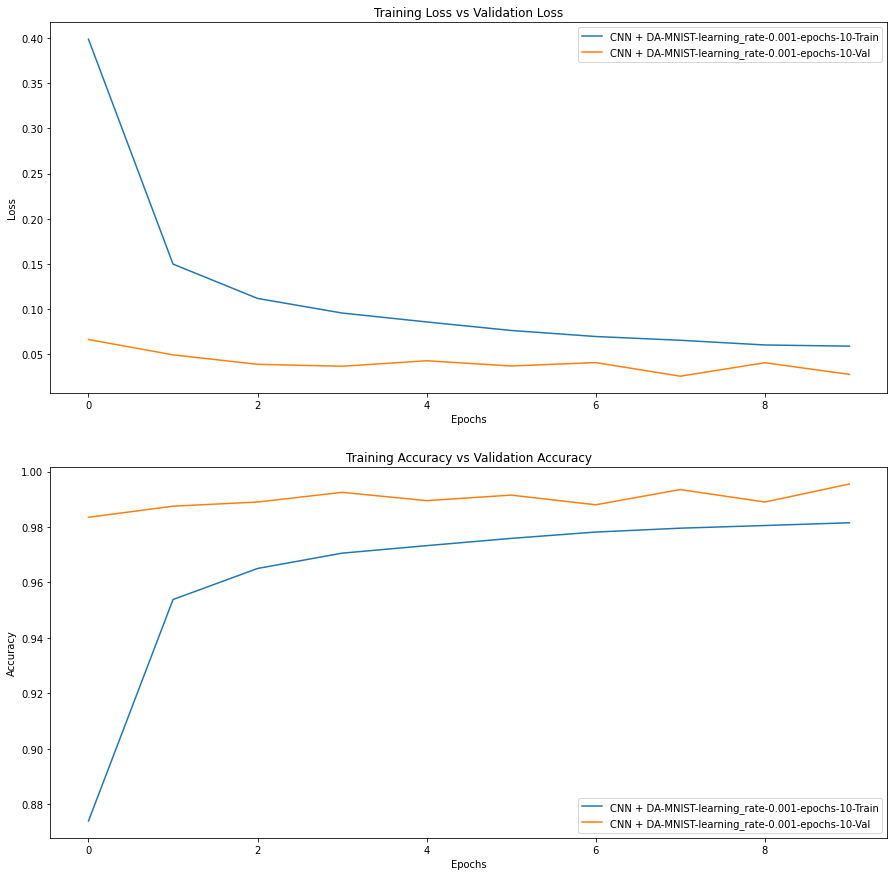

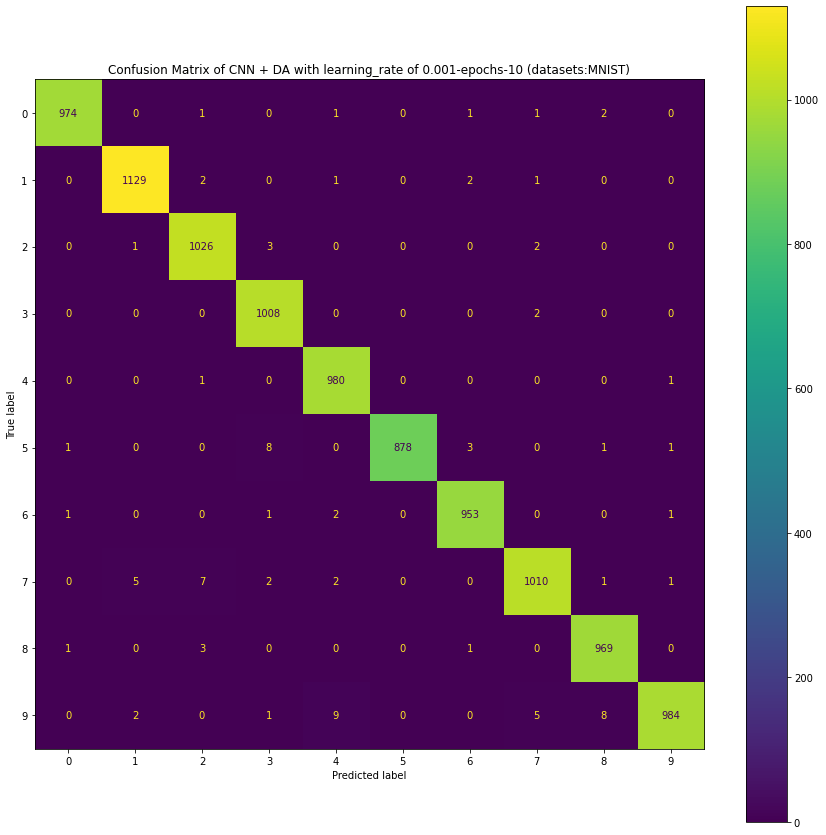

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


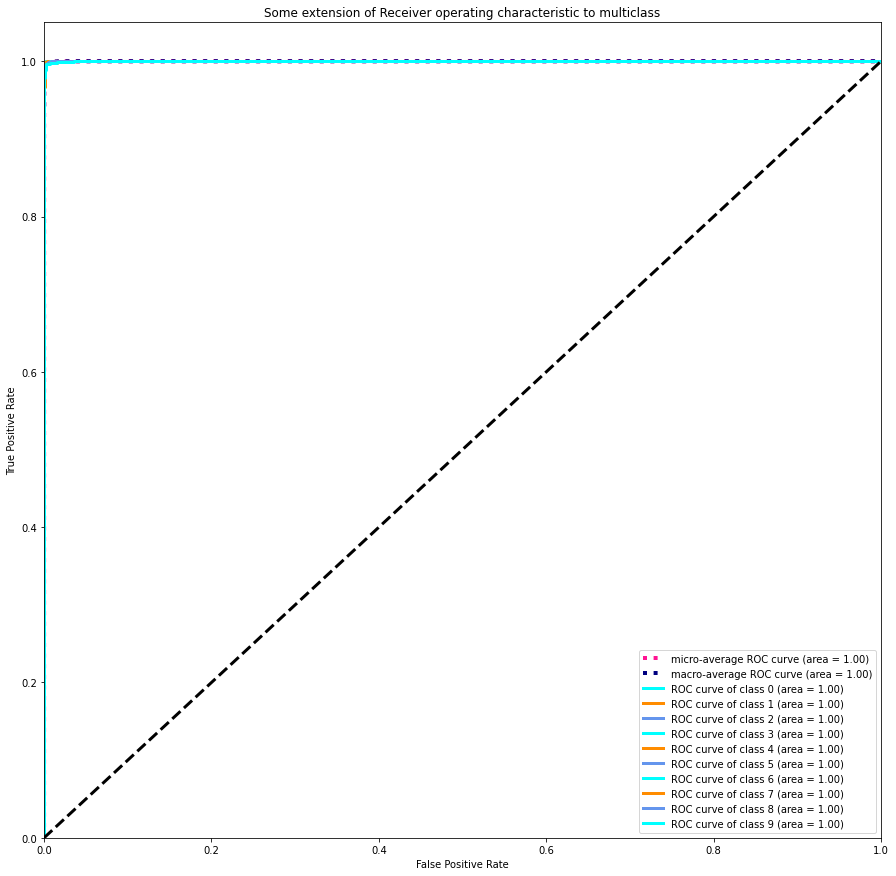

Confusion matrix, without normalization
[[ 974    0    1    0    1    0    1    1    2    0]
 [   0 1129    2    0    1    0    2    1    0    0]
 [   0    1 1026    3    0    0    0    2    0    0]
 [   0    0    0 1008    0    0    0    2    0    0]
 [   0    0    1    0  980    0    0    0    0    1]
 [   1    0    0    8    0  878    3    0    1    1]
 [   1    0    0    1    2    0  953    0    0    1]
 [   0    5    7    2    2    0    0 1010    1    1]
 [   1    0    3    0    0    0    1    0  969    0]
 [   0    2    0    1    9    0    0    5    8  984]]


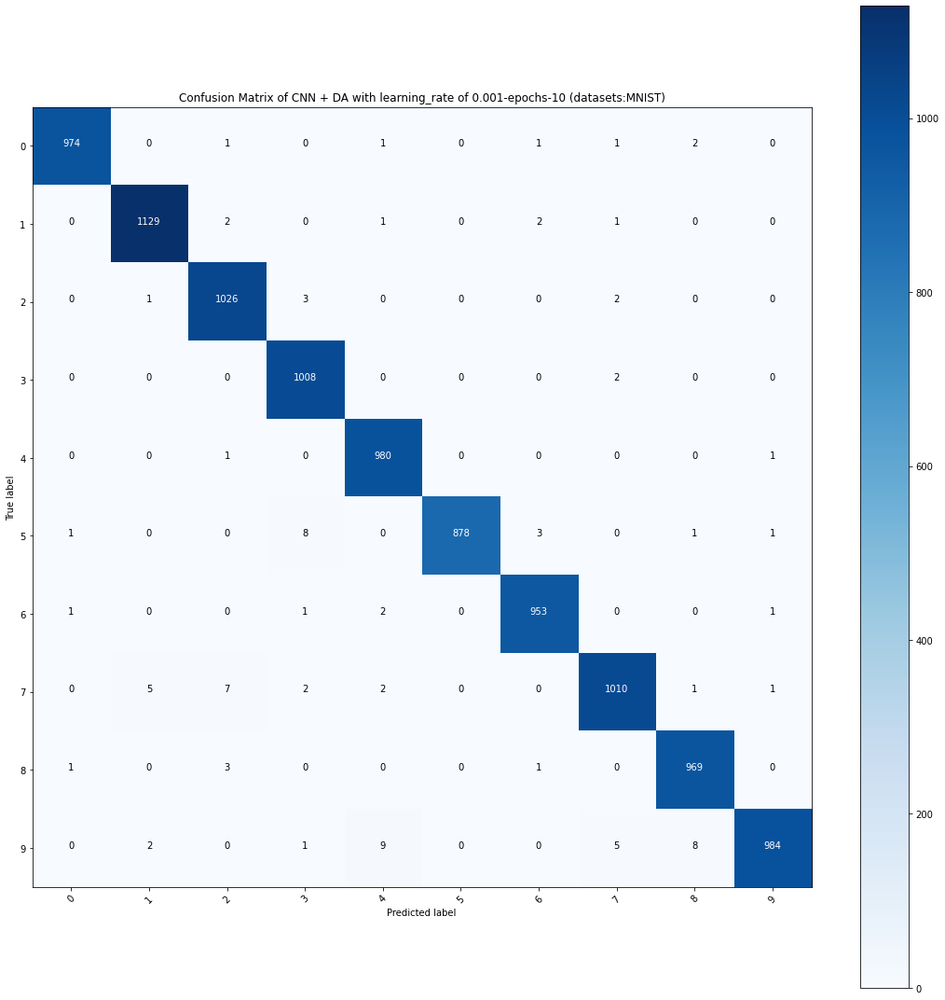

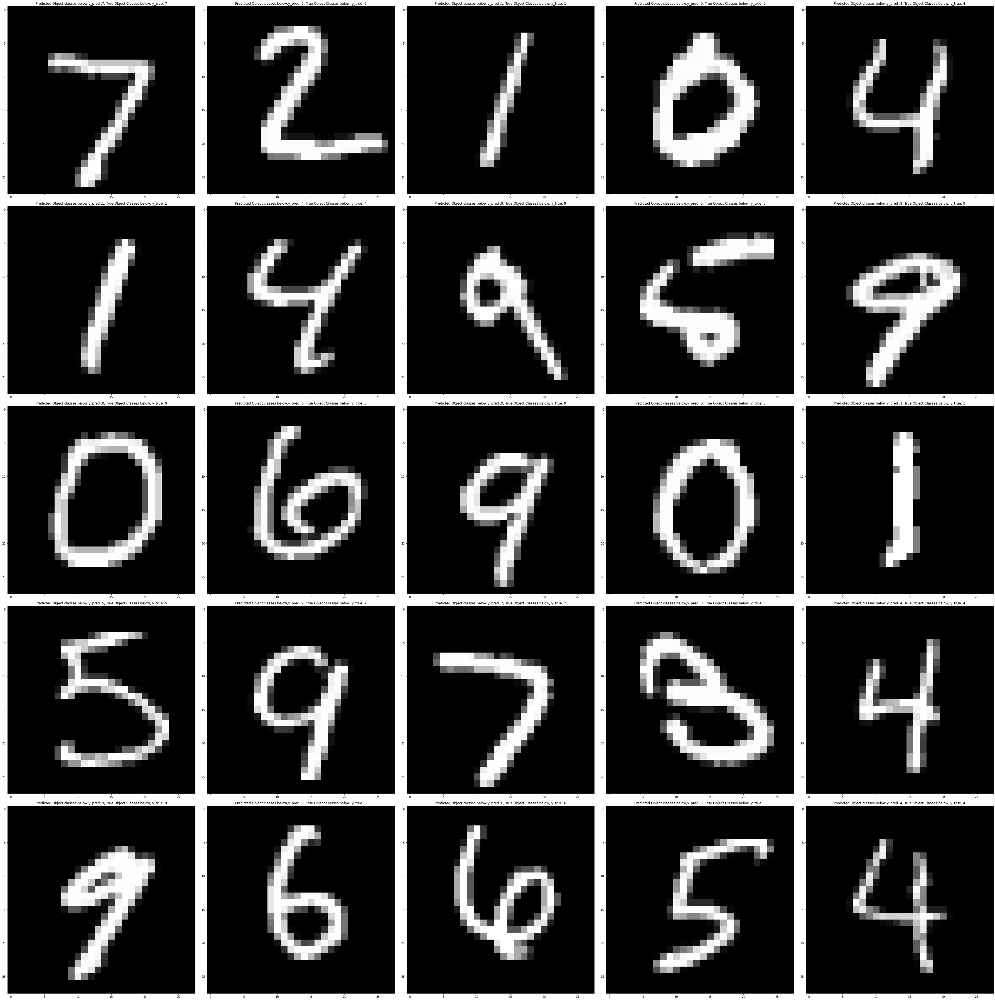

In [19]:
LEARNING_RATE = 0.001
DATA_AUGMENTATION = True
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "CNN + DA"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_CNN_mnist(learning_rate=0.001,
                               model = "CNN + DA",                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 3. LENET-5 WITHOUT DATA AUGMENTATION (LEARNING RATE = 1E-3)


*   learning rate  = 0.001
*   Data Augmentation : False

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


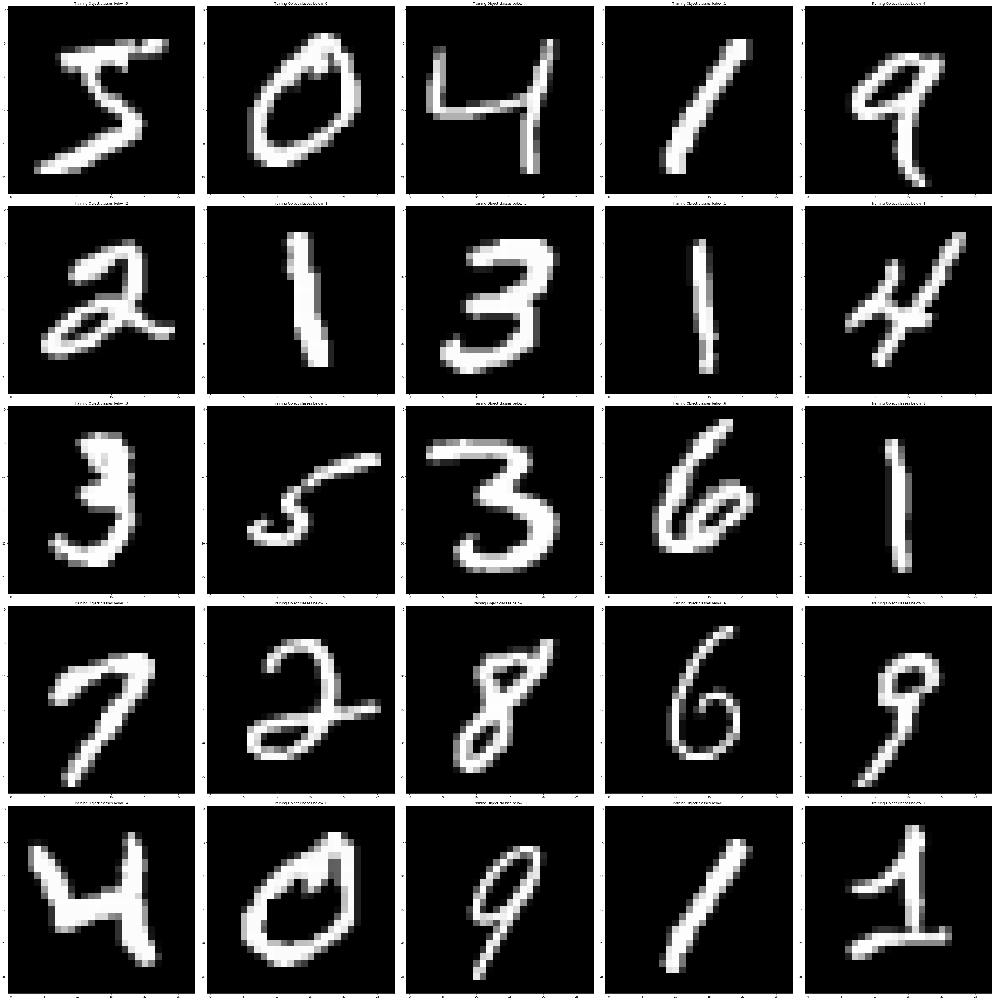

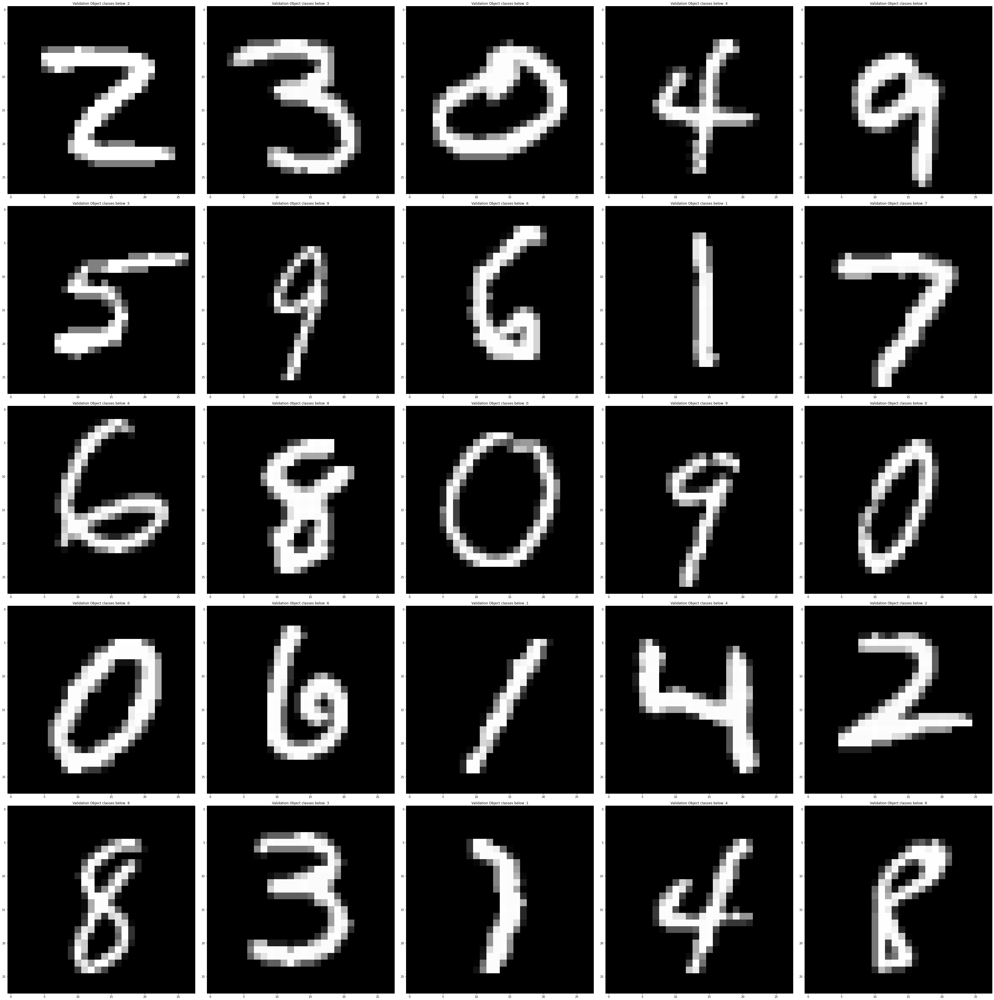

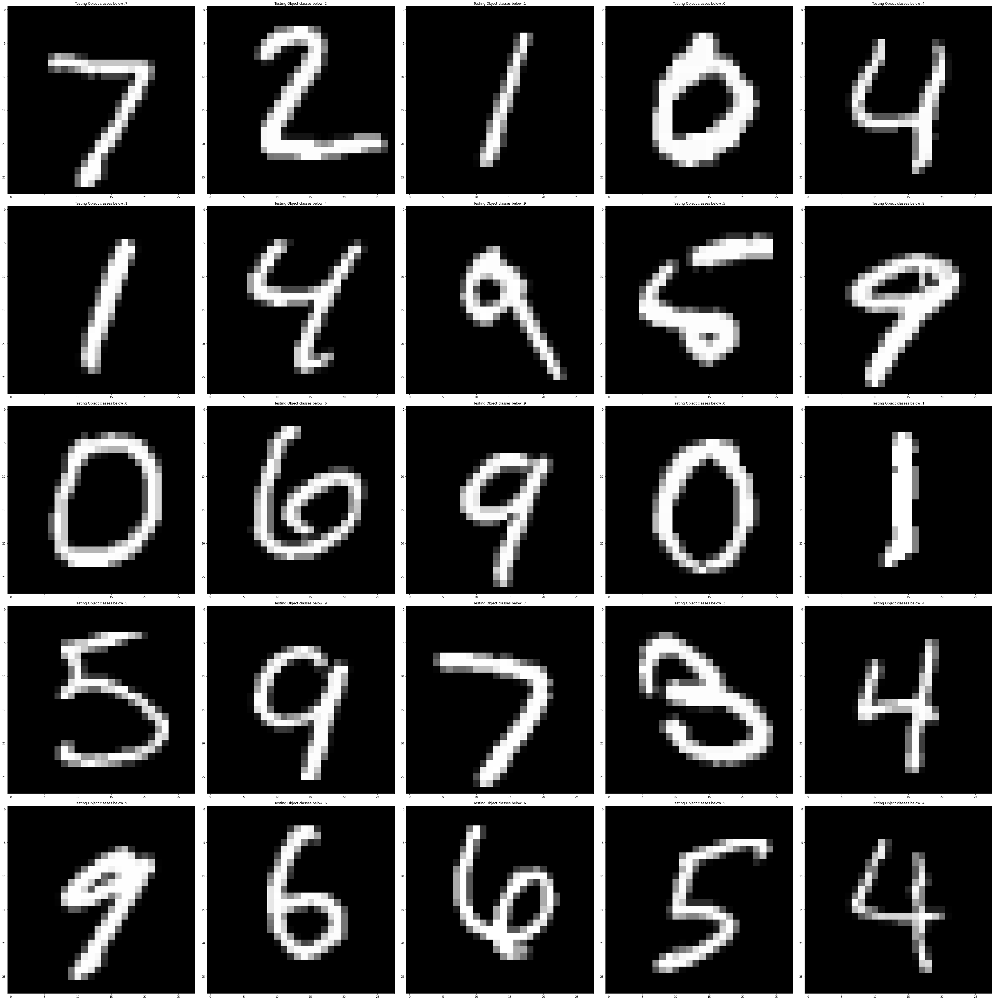

Is data augmentation applied : False
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 average_pooling2d (AverageP  (None, 14, 14, 6)        0         
 ooling2D)                                                       
                                                                 
 activation (Activation)     (None, 14, 14, 6)         0         
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)       

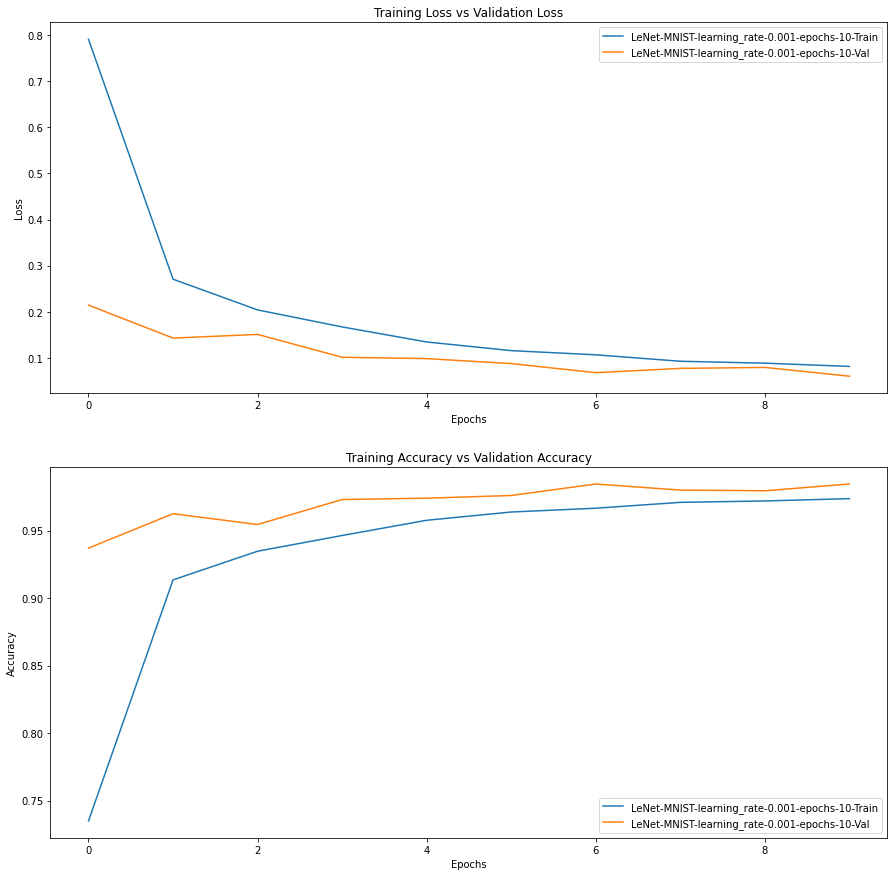

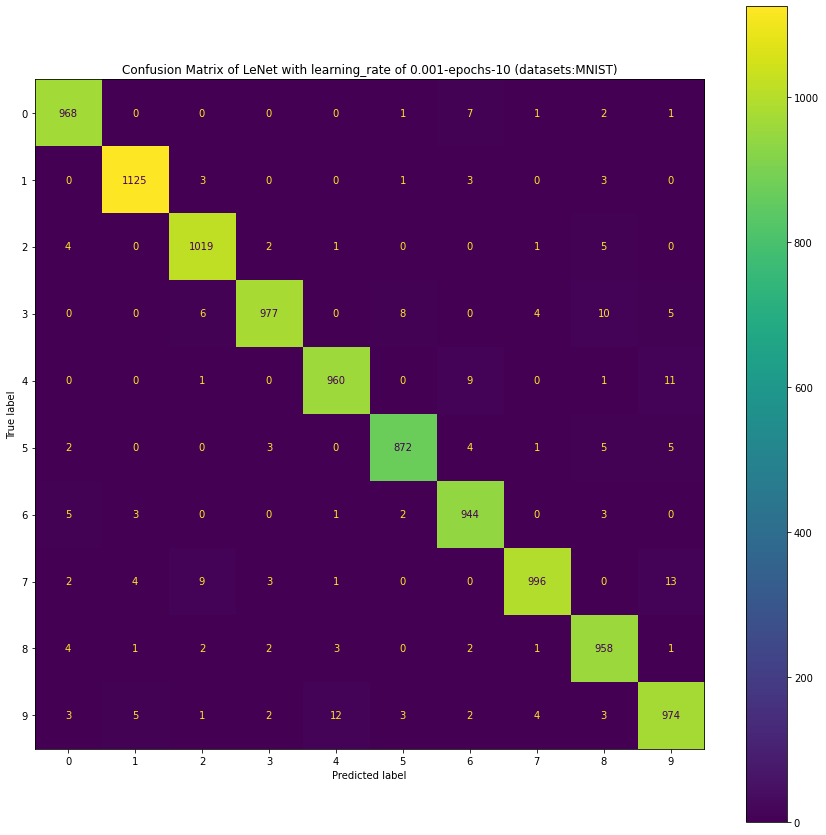

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


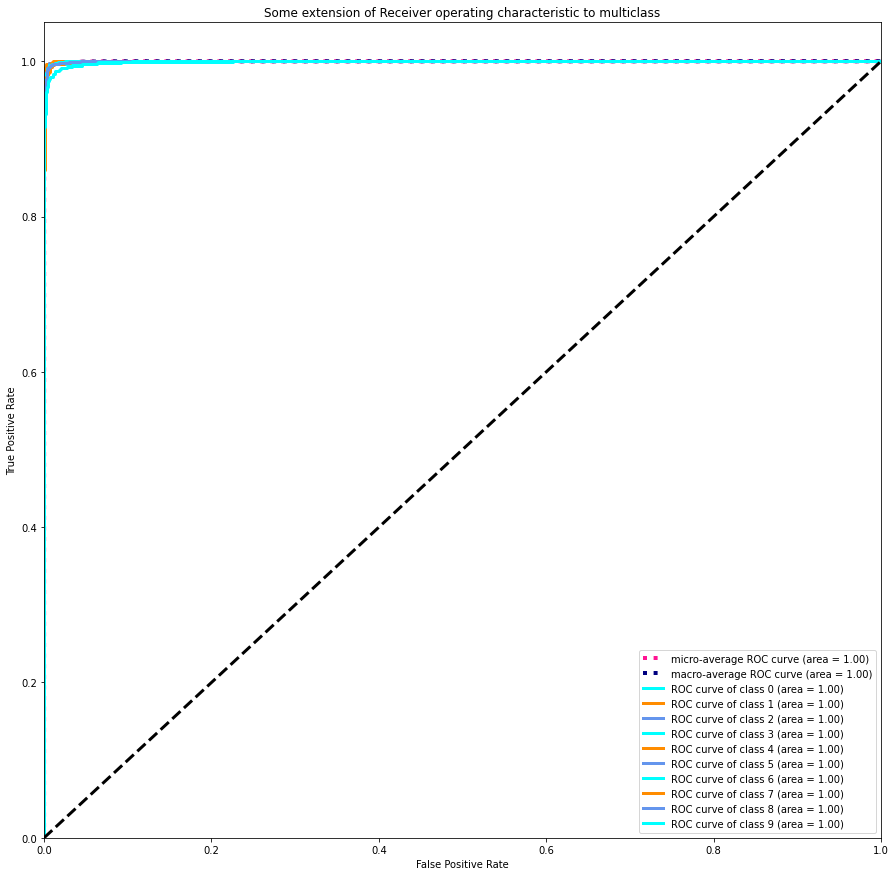

Confusion matrix, without normalization
[[ 968    0    0    0    0    1    7    1    2    1]
 [   0 1125    3    0    0    1    3    0    3    0]
 [   4    0 1019    2    1    0    0    1    5    0]
 [   0    0    6  977    0    8    0    4   10    5]
 [   0    0    1    0  960    0    9    0    1   11]
 [   2    0    0    3    0  872    4    1    5    5]
 [   5    3    0    0    1    2  944    0    3    0]
 [   2    4    9    3    1    0    0  996    0   13]
 [   4    1    2    2    3    0    2    1  958    1]
 [   3    5    1    2   12    3    2    4    3  974]]


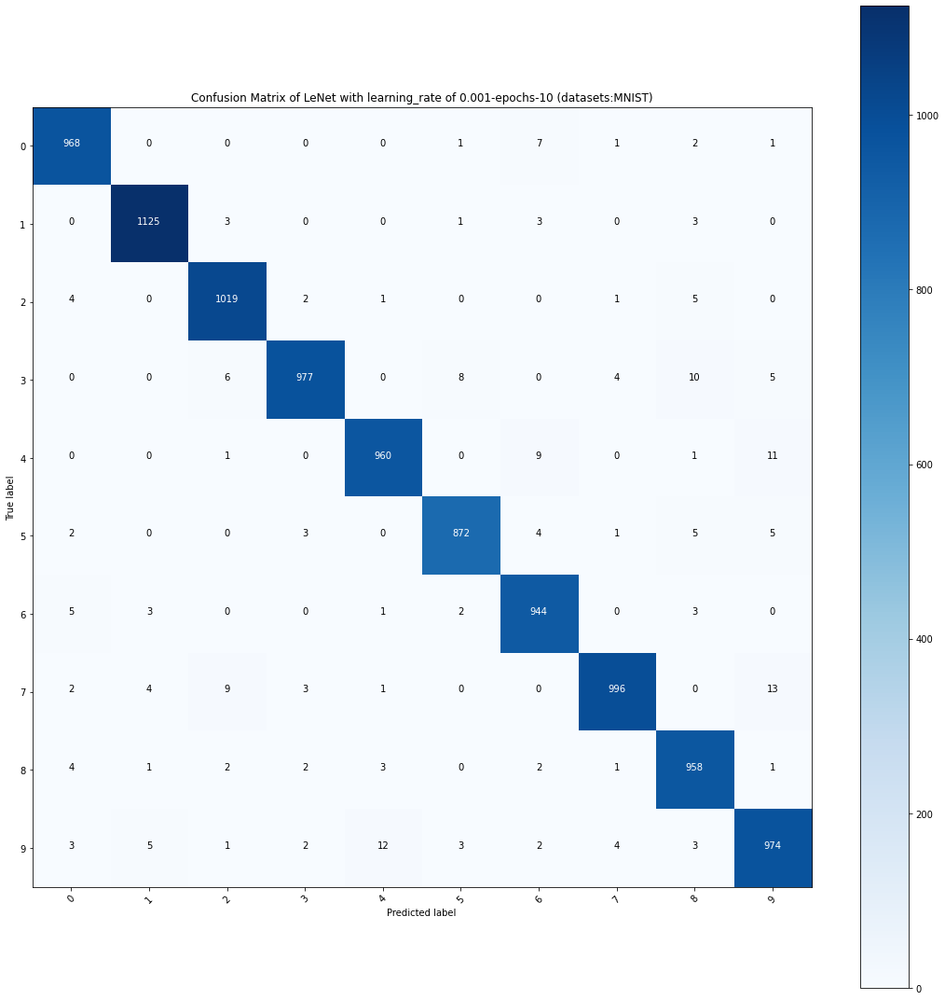

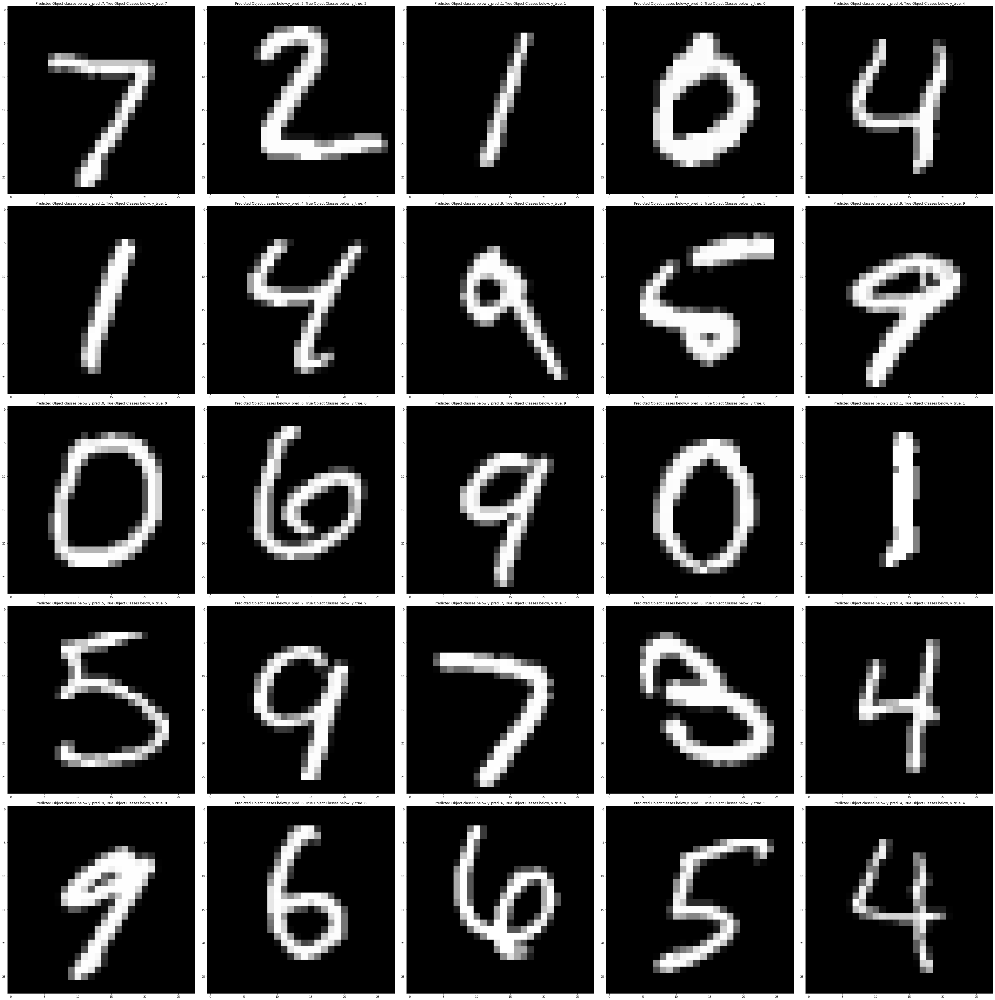

In [20]:
LEARNING_RATE = 0.001
DATA_AUGMENTATION = False
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "LeNet"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_LeNet_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 4: CNN WITHOUT DATA AUGMENTATION (LEARNING RATE = 1E-3)
* learning rate = 0.001
* Data Augmentation : False

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


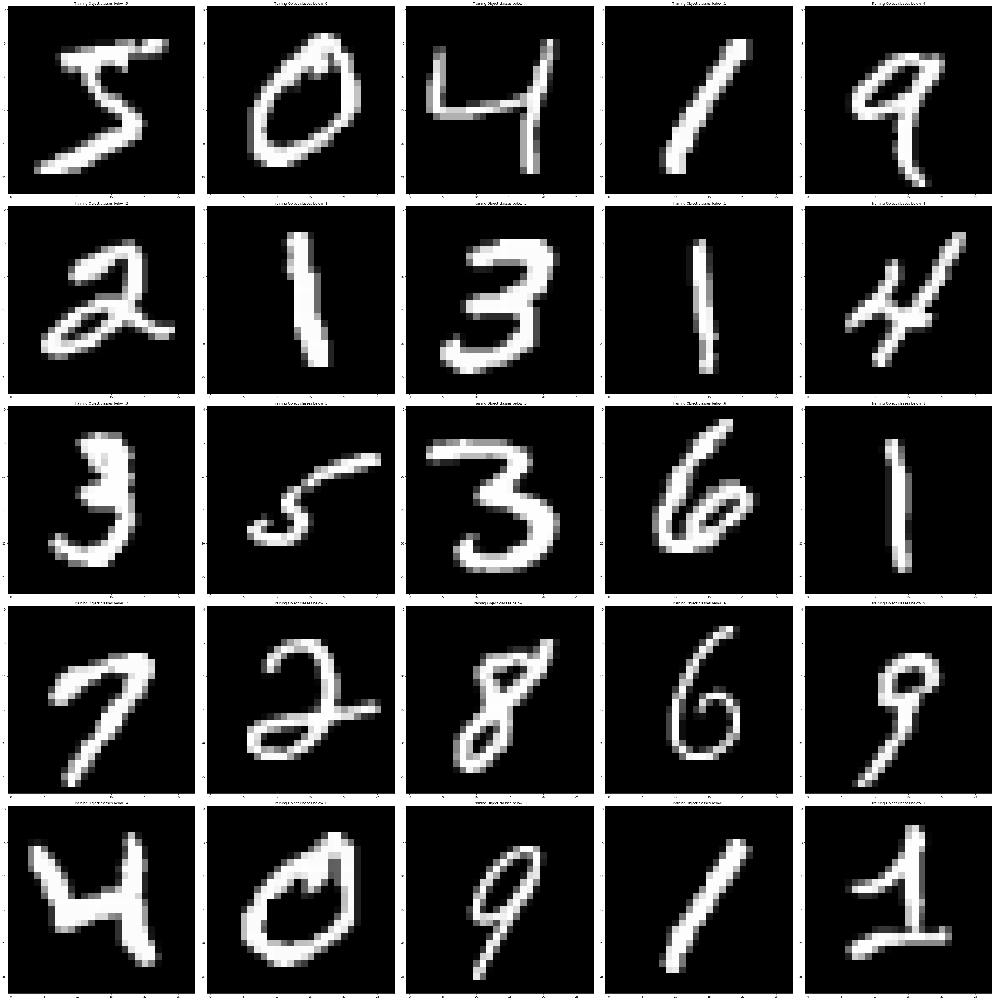

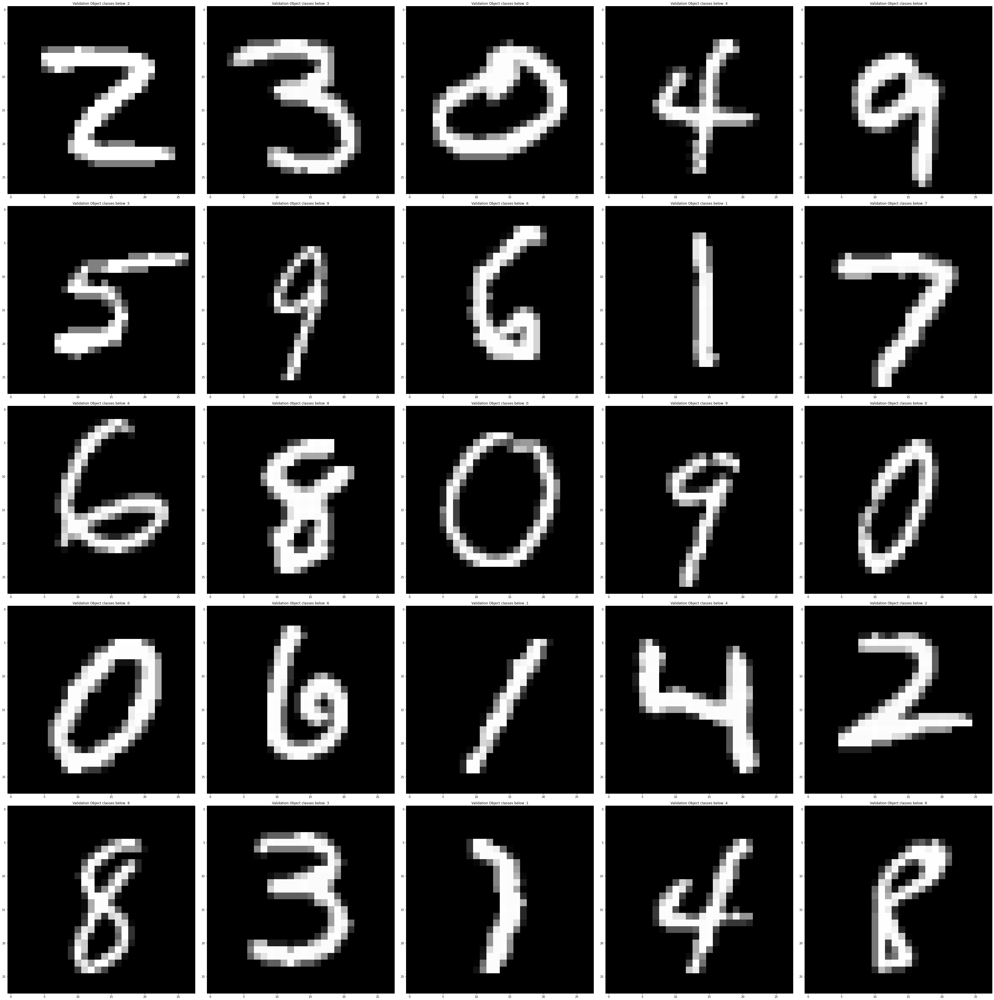

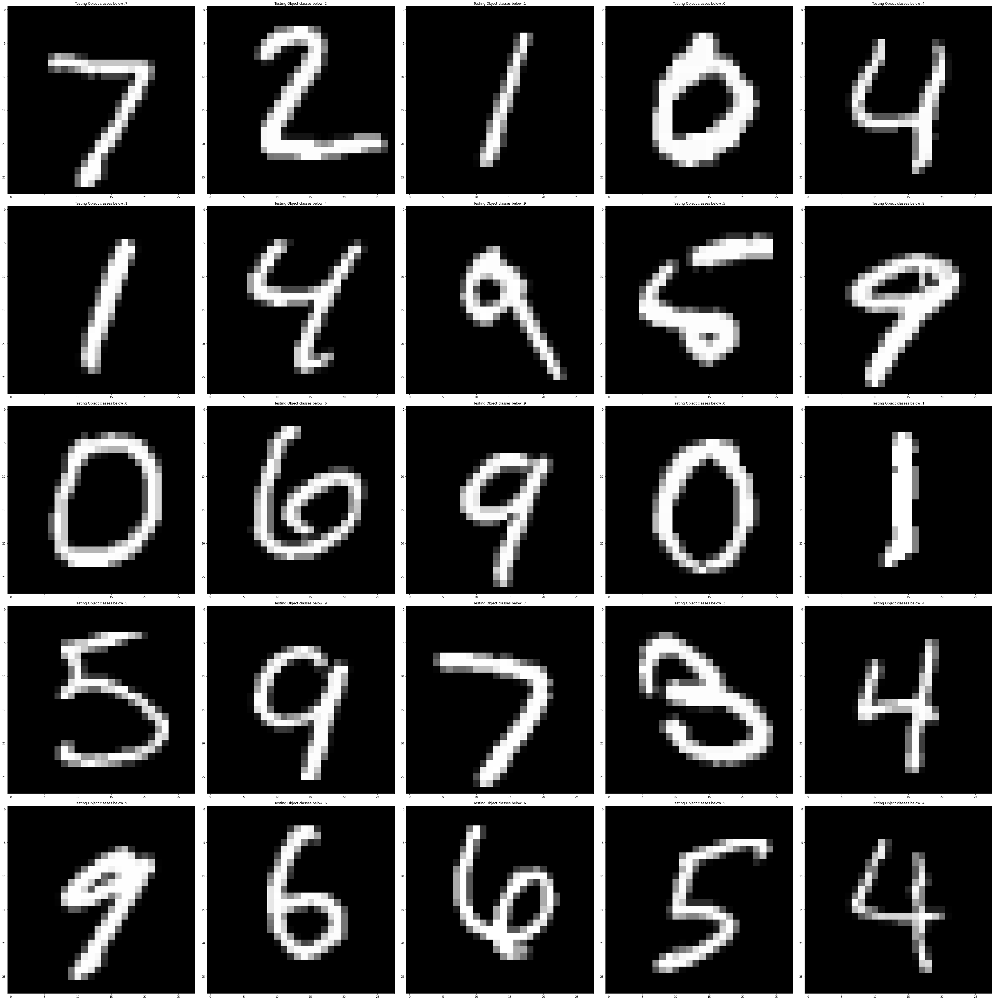

Is data augmentation applied : False
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 6)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 5, 5, 16)         0         
 2D)                                                             
                                                                 
 flatten (Flatten) 

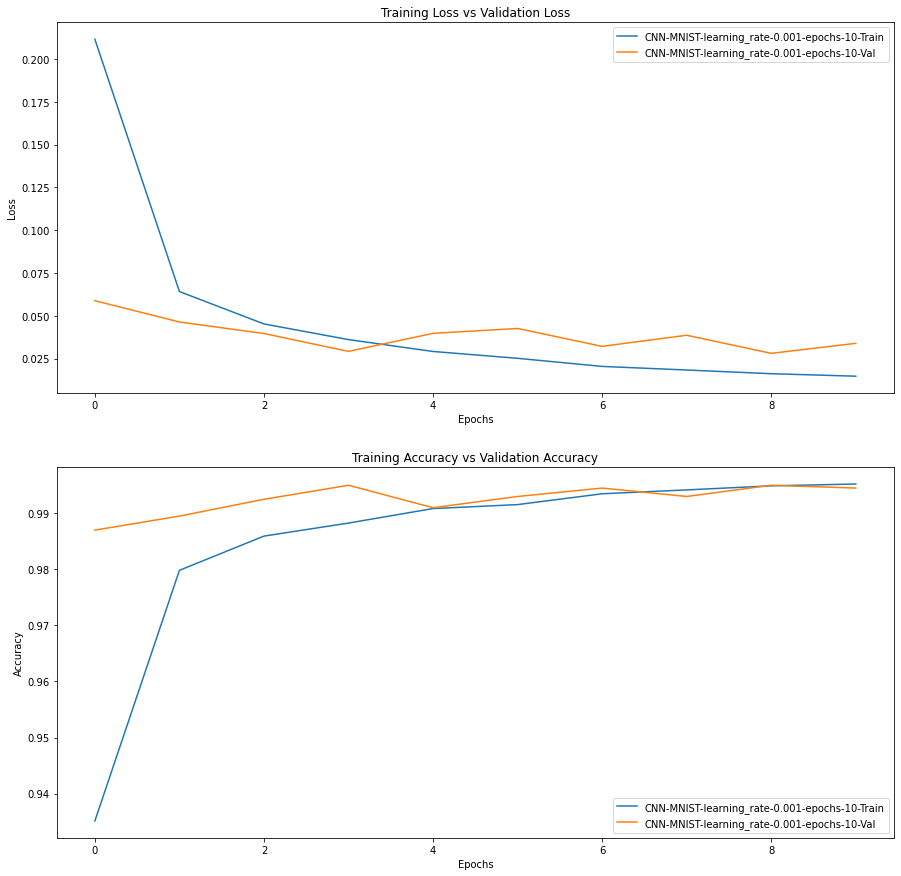

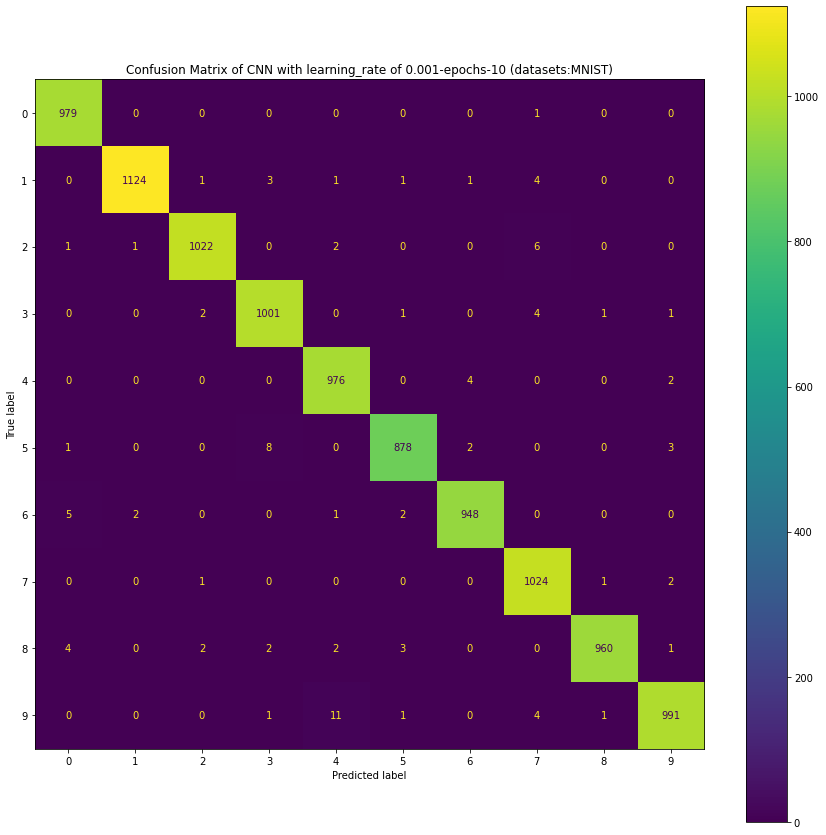

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


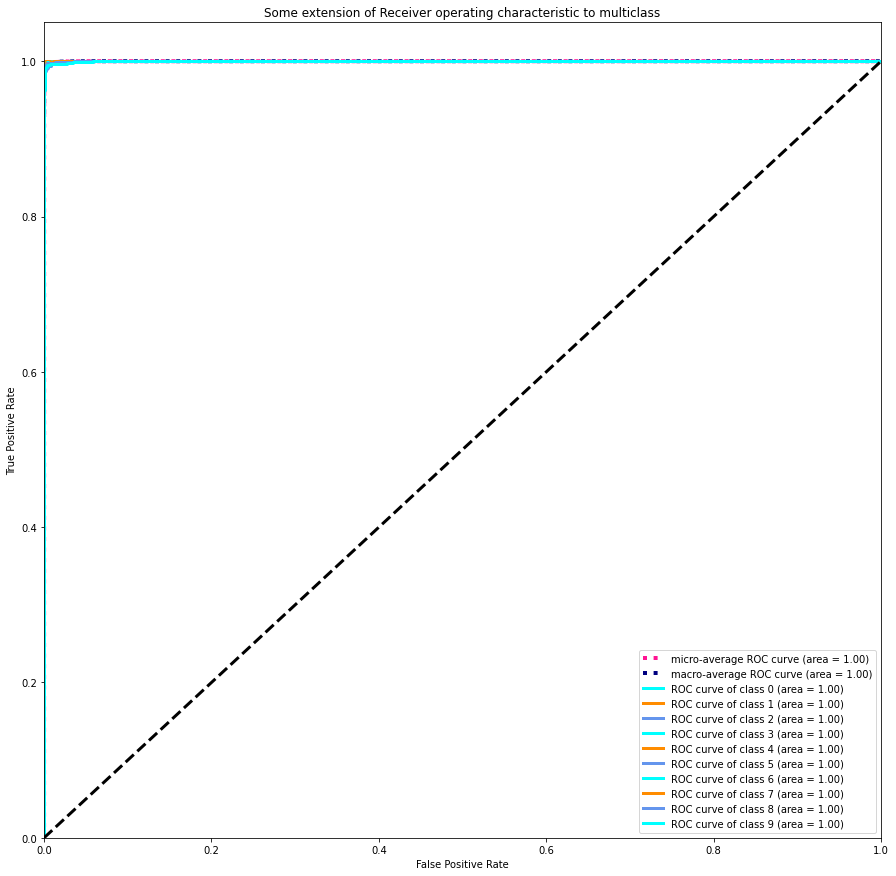

Confusion matrix, without normalization
[[ 979    0    0    0    0    0    0    1    0    0]
 [   0 1124    1    3    1    1    1    4    0    0]
 [   1    1 1022    0    2    0    0    6    0    0]
 [   0    0    2 1001    0    1    0    4    1    1]
 [   0    0    0    0  976    0    4    0    0    2]
 [   1    0    0    8    0  878    2    0    0    3]
 [   5    2    0    0    1    2  948    0    0    0]
 [   0    0    1    0    0    0    0 1024    1    2]
 [   4    0    2    2    2    3    0    0  960    1]
 [   0    0    0    1   11    1    0    4    1  991]]


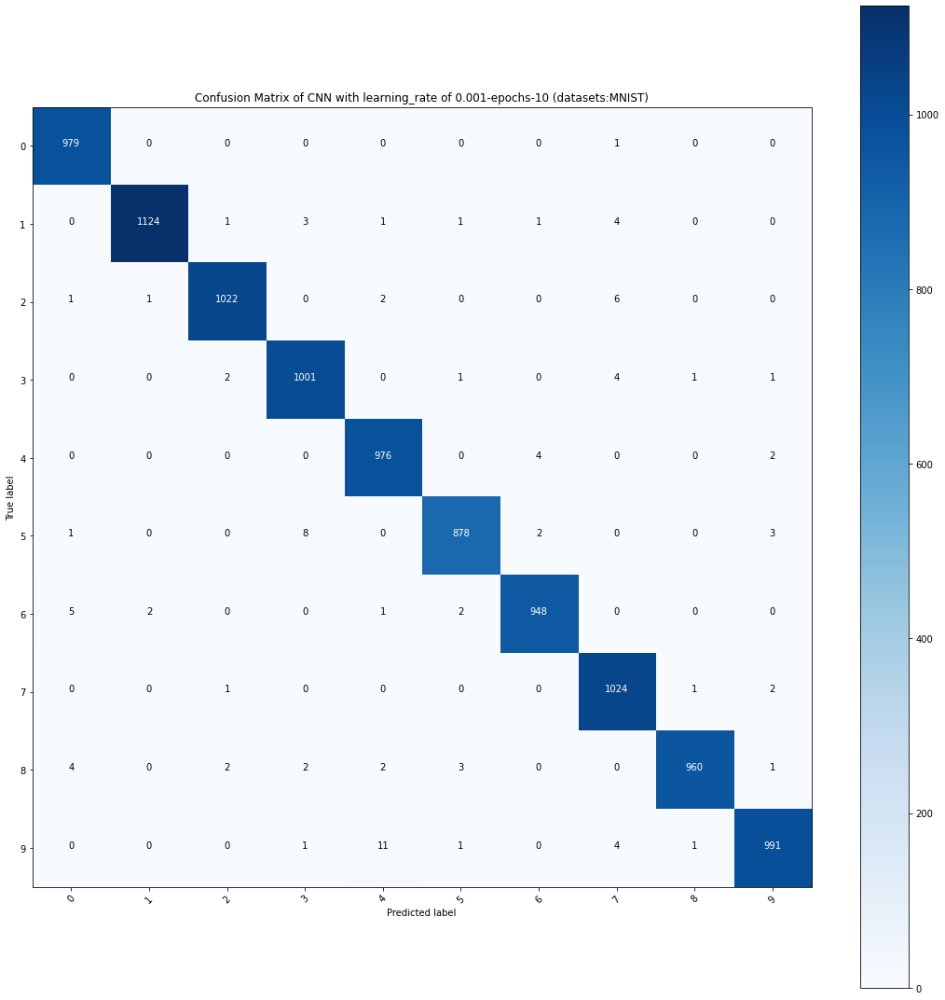

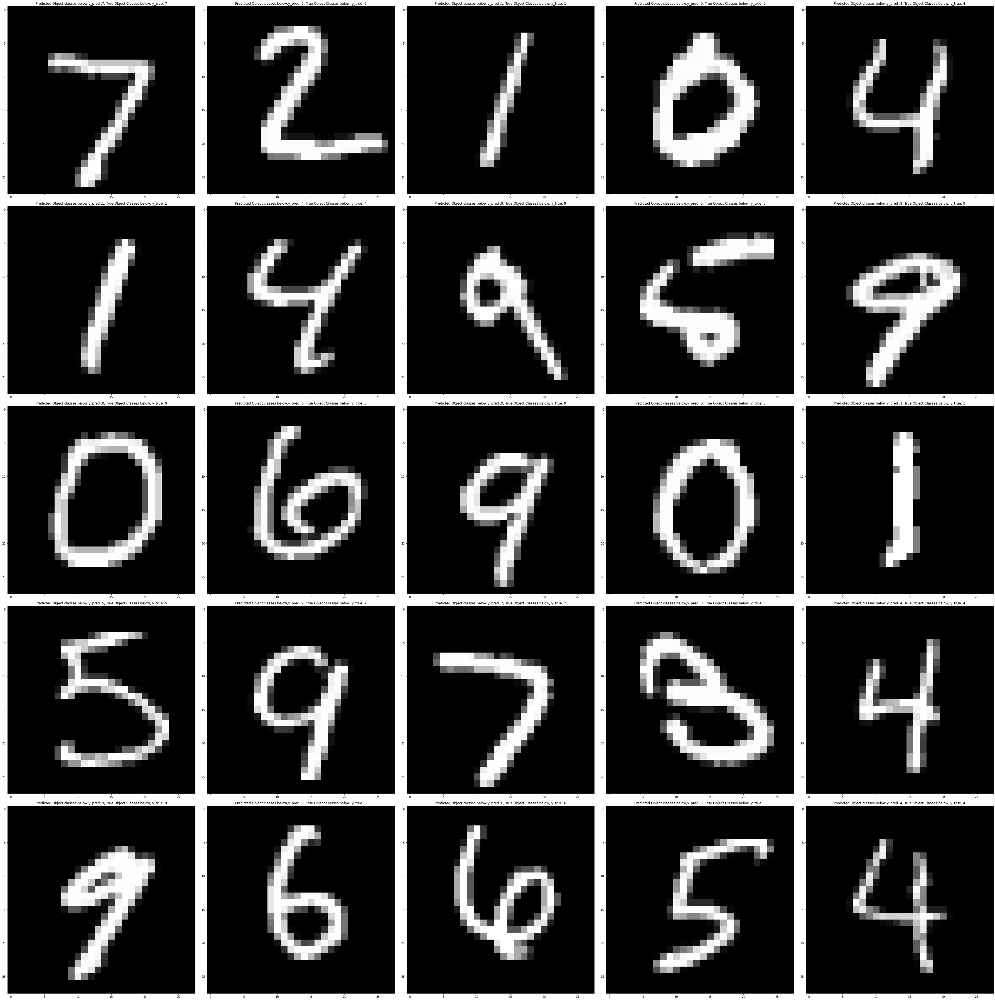

In [21]:
LEARNING_RATE = 0.001
DATA_AUGMENTATION = False
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "CNN"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_CNN_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 5: LeNet-5 WITH DATA AUGMENTATION (LEARNING RATE = 1E-4)
* learning rate = 0.0001
* Data Augmentation : True

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


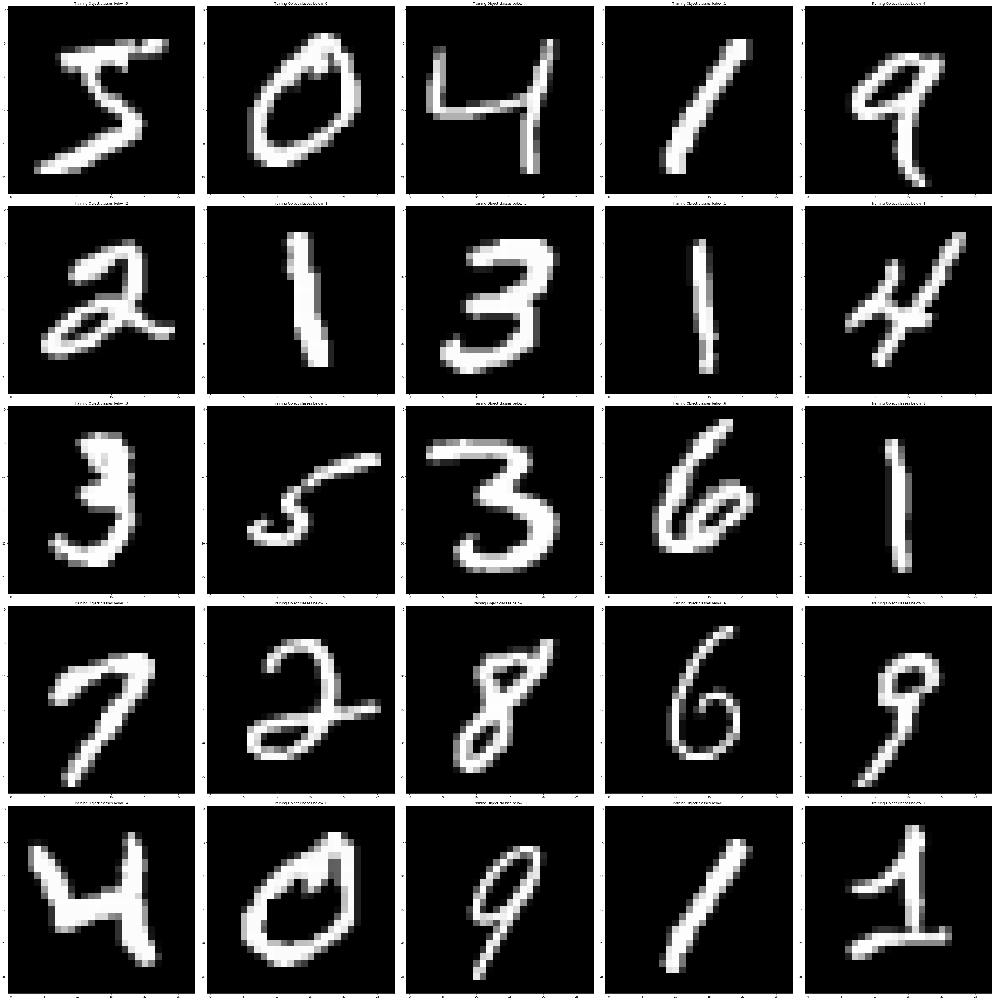

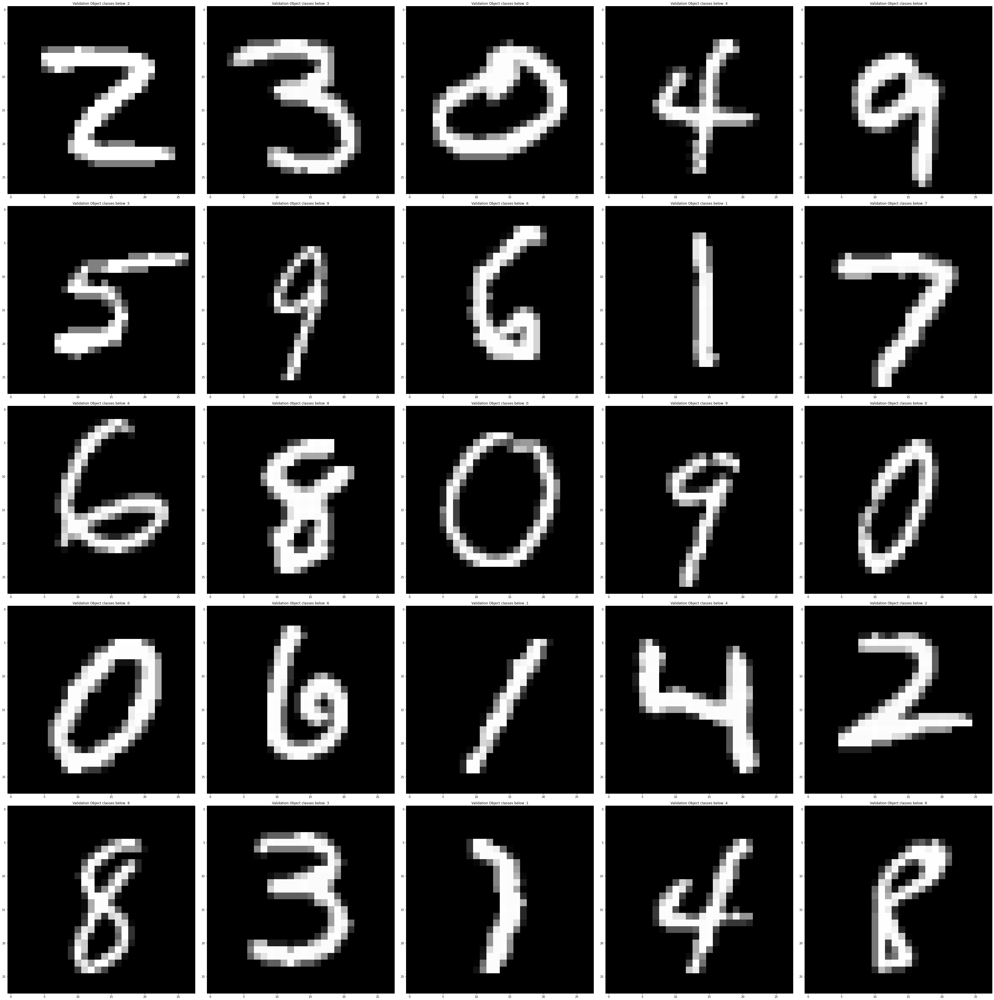

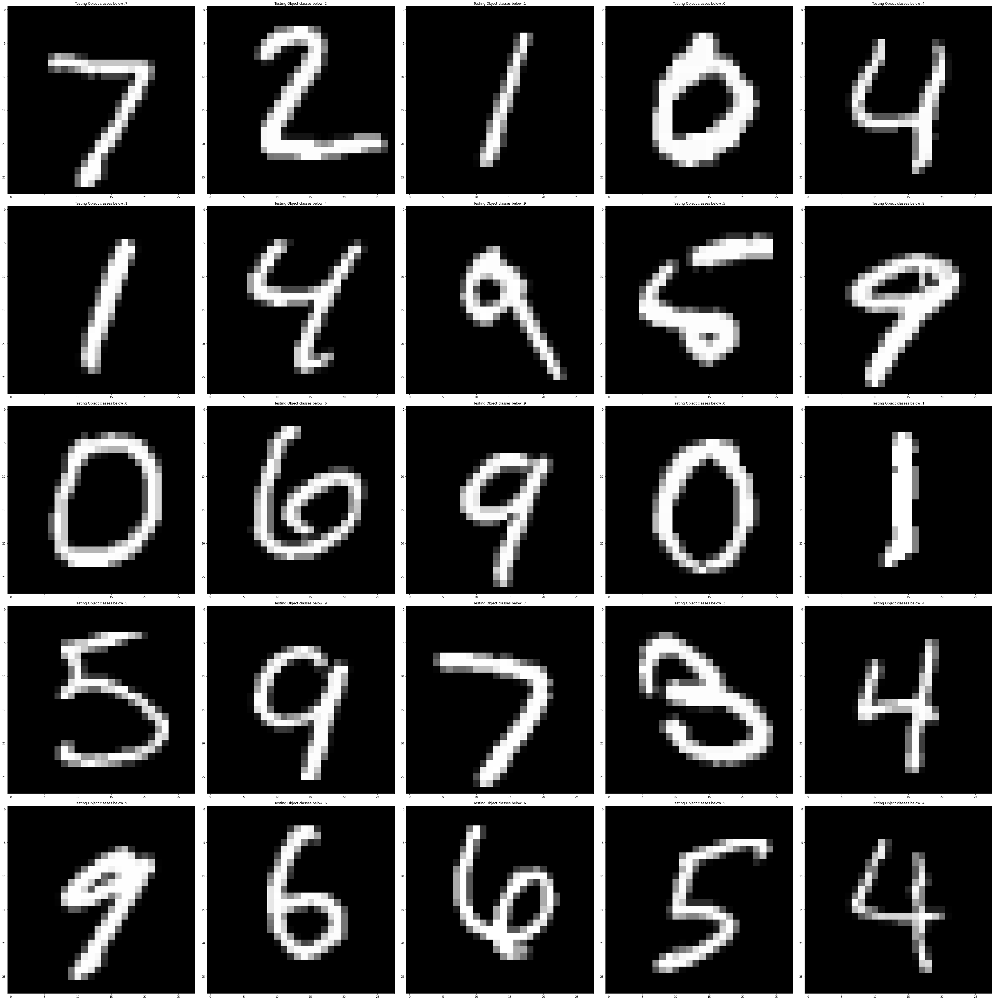

Is data augmentation applied : True
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 average_pooling2d (AverageP  (None, 14, 14, 6)        0         
 ooling2D)                                                       
                                                                 
 activation (Activation)     (None, 14, 14, 6)         0         
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)        

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:46: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


906/906 [==============================] - 26s 28ms/step - loss: 2.2846 - accuracy: 0.1460 - val_loss: 2.1159 - val_accuracy: 0.4715
Epoch 2/10
906/906 [==============================] - 25s 27ms/step - loss: 1.6750 - accuracy: 0.4631 - val_loss: 0.8753 - val_accuracy: 0.7790
Epoch 3/10
906/906 [==============================] - 25s 27ms/step - loss: 1.2483 - accuracy: 0.5820 - val_loss: 0.6207 - val_accuracy: 0.8650
Epoch 4/10
906/906 [==============================] - 37s 41ms/step - loss: 1.1437 - accuracy: 0.6211 - val_loss: 0.5231 - val_accuracy: 0.8890
Epoch 5/10
906/906 [==============================] - 25s 27ms/step - loss: 1.0823 - accuracy: 0.6434 - val_loss: 0.4537 - val_accuracy: 0.9005
Epoch 6/10
906/906 [==============================] - 26s 29ms/step - loss: 1.0244 - accuracy: 0.6661 - val_loss: 0.4229 - val_accuracy: 0.9100
Epoch 7/10
906/906 [==============================] - 37s 41ms/step - loss: 0.9653 - accuracy: 0.6866 - val_loss: 0.3854 - val_accuracy: 0.9155
Epo

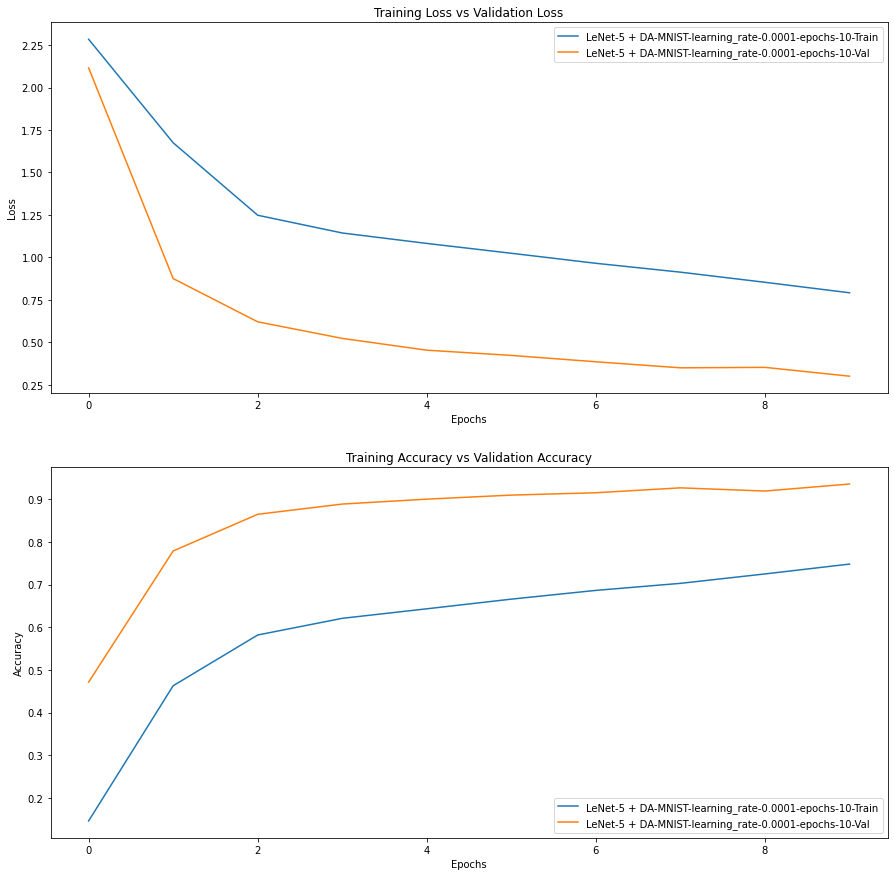

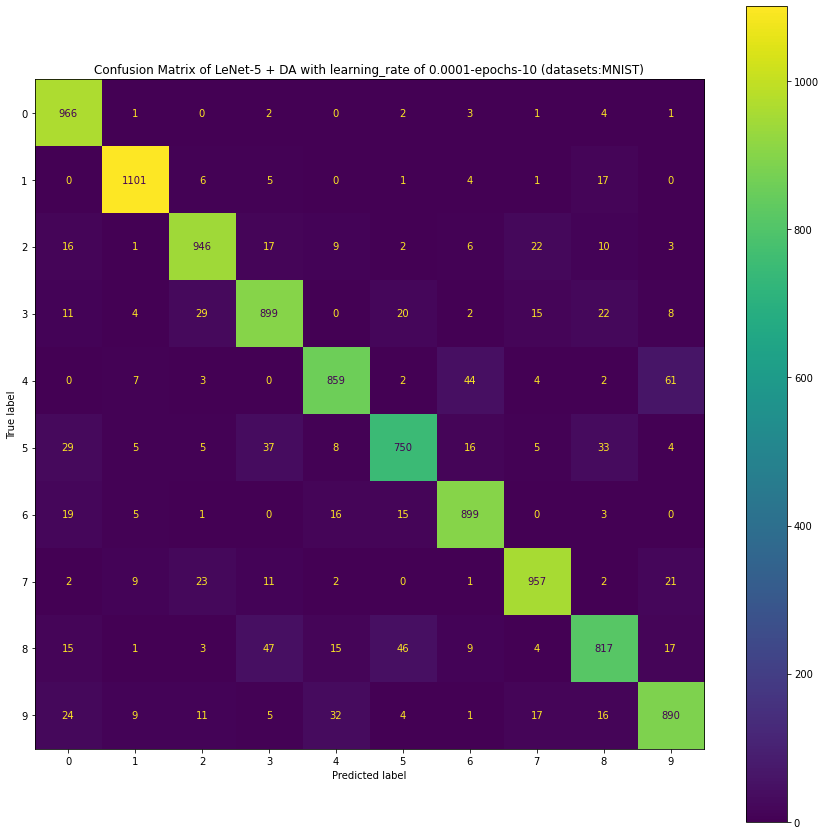

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


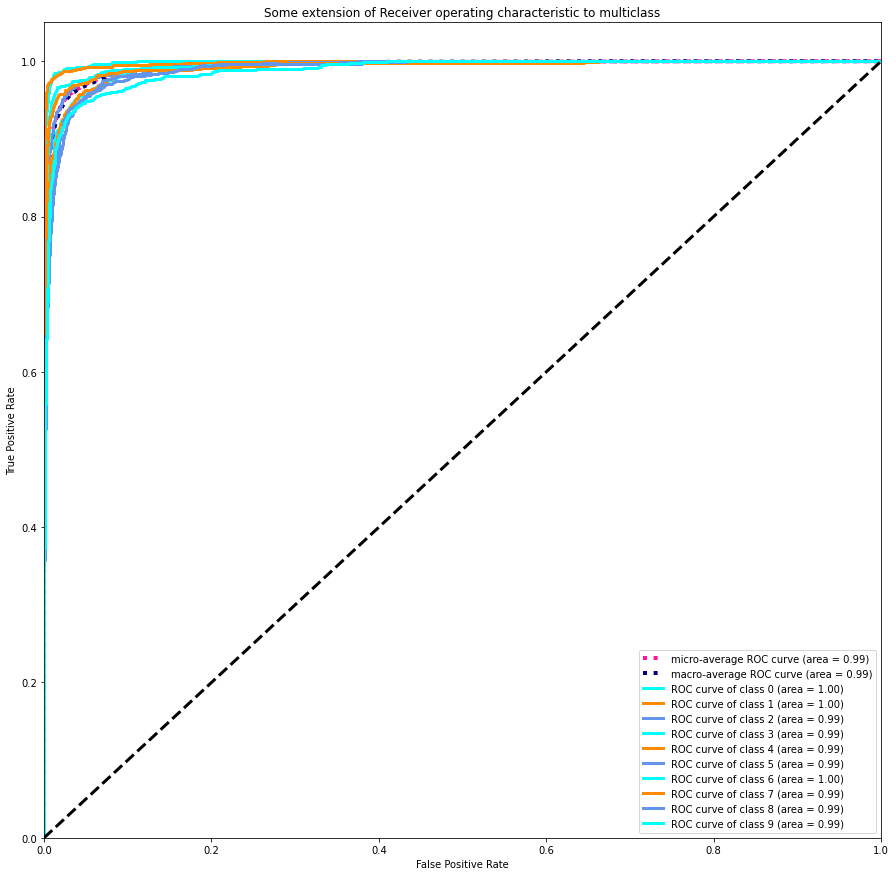

Confusion matrix, without normalization
[[ 966    1    0    2    0    2    3    1    4    1]
 [   0 1101    6    5    0    1    4    1   17    0]
 [  16    1  946   17    9    2    6   22   10    3]
 [  11    4   29  899    0   20    2   15   22    8]
 [   0    7    3    0  859    2   44    4    2   61]
 [  29    5    5   37    8  750   16    5   33    4]
 [  19    5    1    0   16   15  899    0    3    0]
 [   2    9   23   11    2    0    1  957    2   21]
 [  15    1    3   47   15   46    9    4  817   17]
 [  24    9   11    5   32    4    1   17   16  890]]


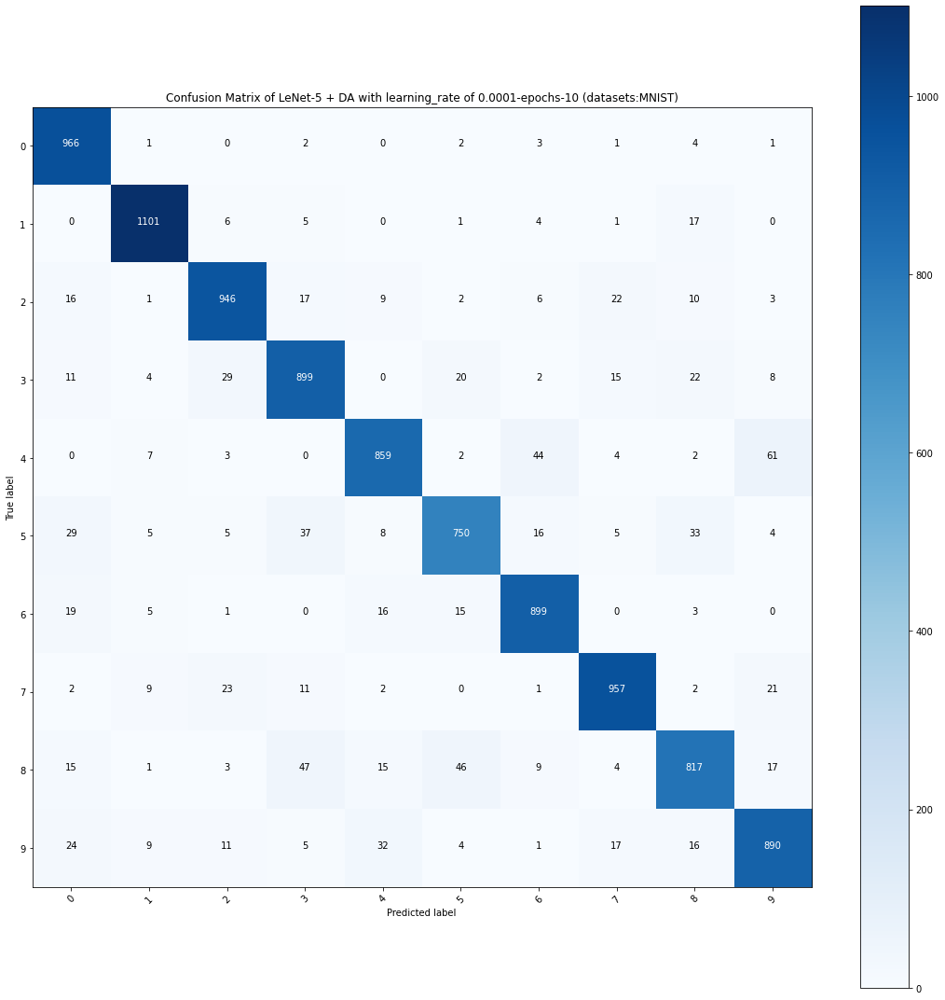

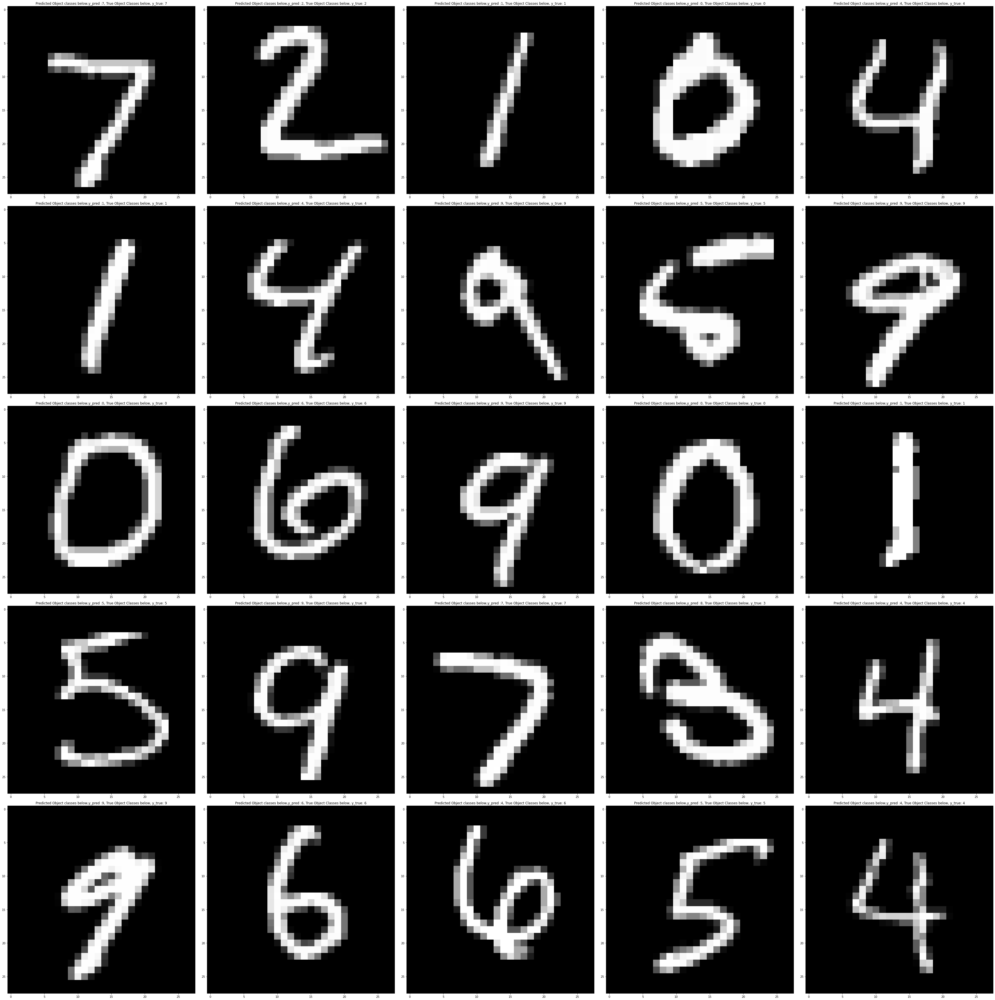

In [22]:
LEARNING_RATE = 0.0001
DATA_AUGMENTATION = True
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "LeNet-5 + DA"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_LeNet_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 6: CNN WITH DATA AUGMENTATION (LEARNING RATE = 1E-4)
* learning rate = 0.0001
* Data Augmentation : True

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


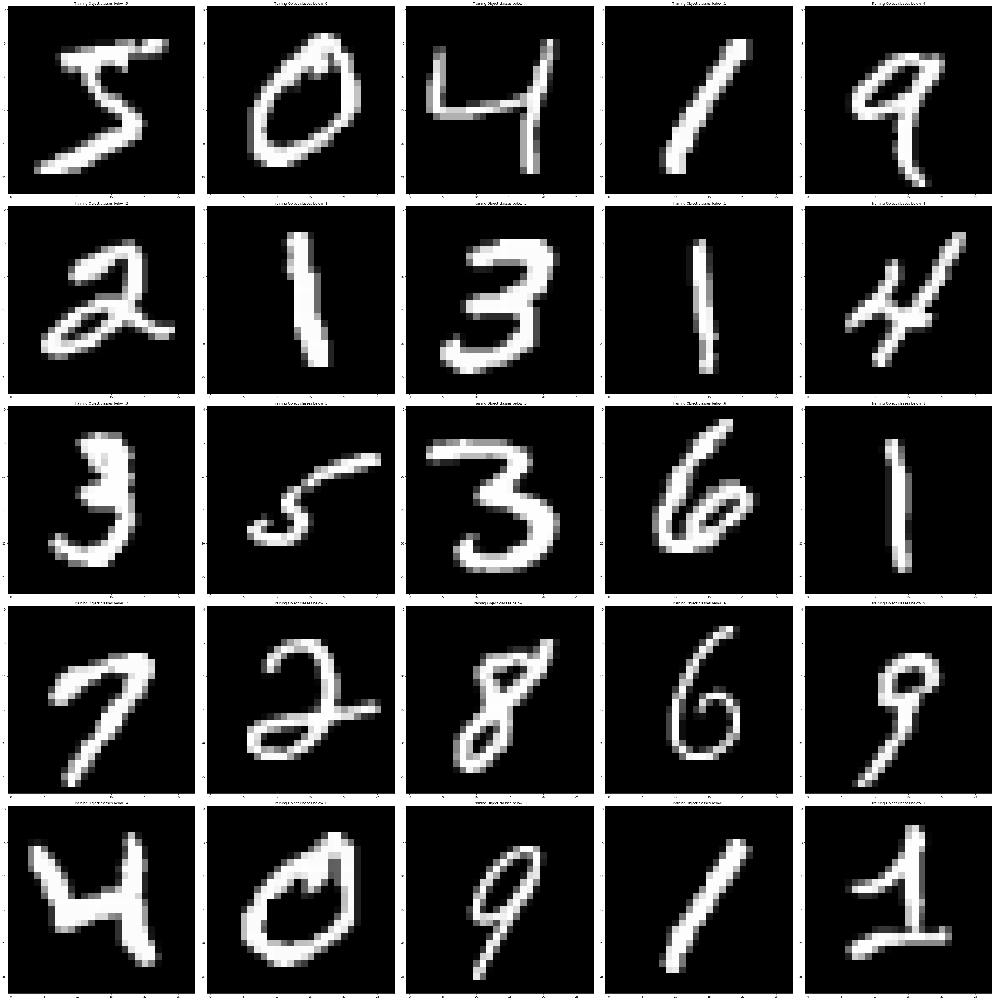

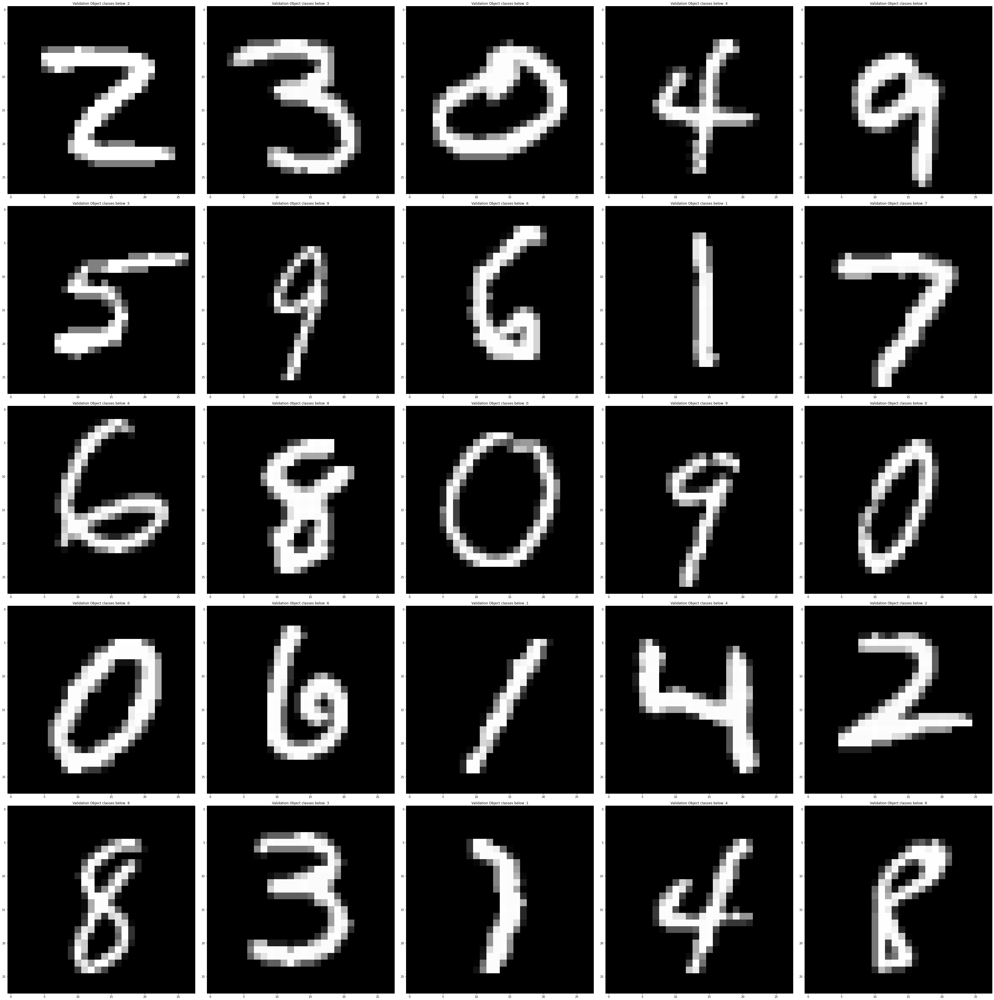

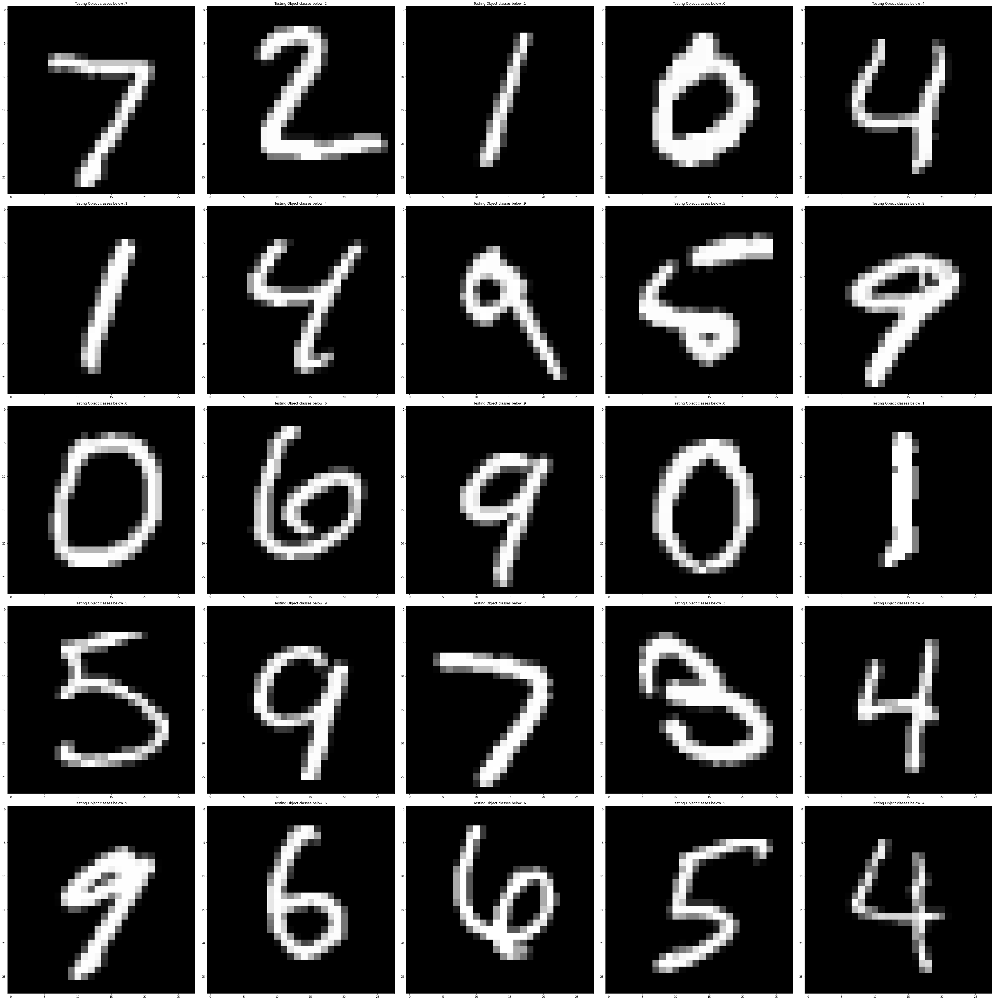

Is data augmentation applied : True
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 6)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 5, 5, 16)         0         
 2D)                                                             
                                                                 
 flatten (Flatten)  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:46: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


906/906 [==============================] - 26s 28ms/step - loss: 1.0340 - accuracy: 0.6734 - val_loss: 0.1802 - val_accuracy: 0.9645
Epoch 2/10
906/906 [==============================] - 25s 27ms/step - loss: 0.4046 - accuracy: 0.8798 - val_loss: 0.1278 - val_accuracy: 0.9710
Epoch 3/10
906/906 [==============================] - 25s 27ms/step - loss: 0.2926 - accuracy: 0.9136 - val_loss: 0.1006 - val_accuracy: 0.9775
Epoch 4/10
906/906 [==============================] - 25s 27ms/step - loss: 0.2495 - accuracy: 0.9246 - val_loss: 0.0902 - val_accuracy: 0.9790
Epoch 5/10
906/906 [==============================] - 25s 27ms/step - loss: 0.2217 - accuracy: 0.9336 - val_loss: 0.0887 - val_accuracy: 0.9830
Epoch 6/10
906/906 [==============================] - 25s 27ms/step - loss: 0.2027 - accuracy: 0.9382 - val_loss: 0.0764 - val_accuracy: 0.9810
Epoch 7/10
906/906 [==============================] - 25s 27ms/step - loss: 0.1899 - accuracy: 0.9412 - val_loss: 0.0810 - val_accuracy: 0.9800
Epo

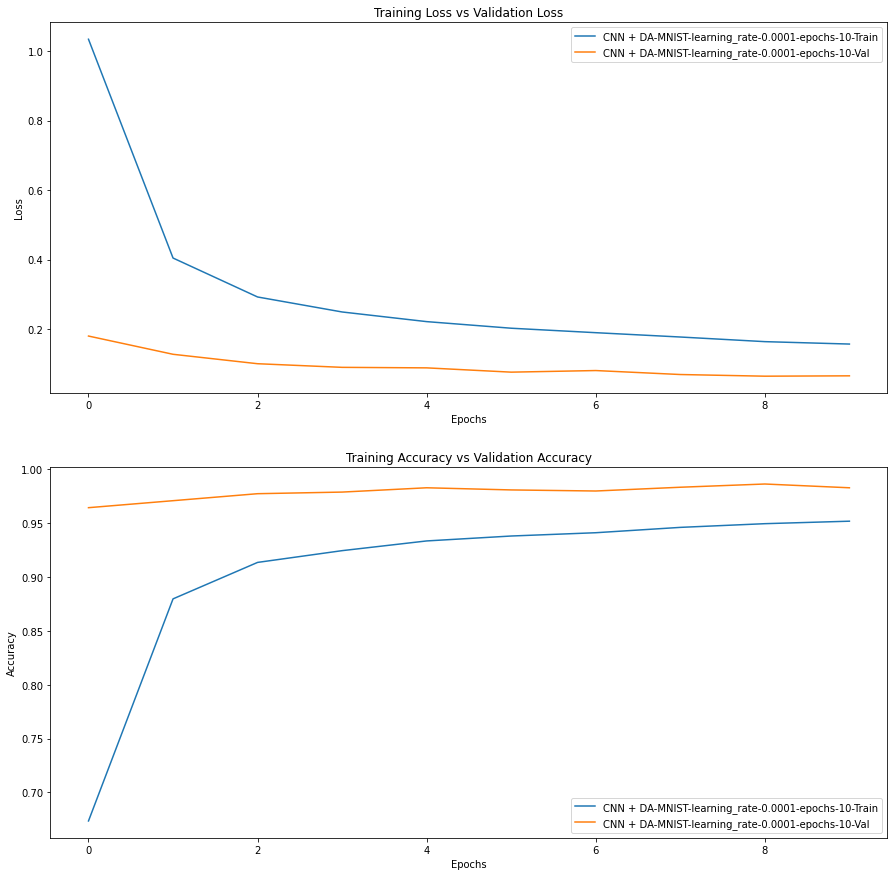

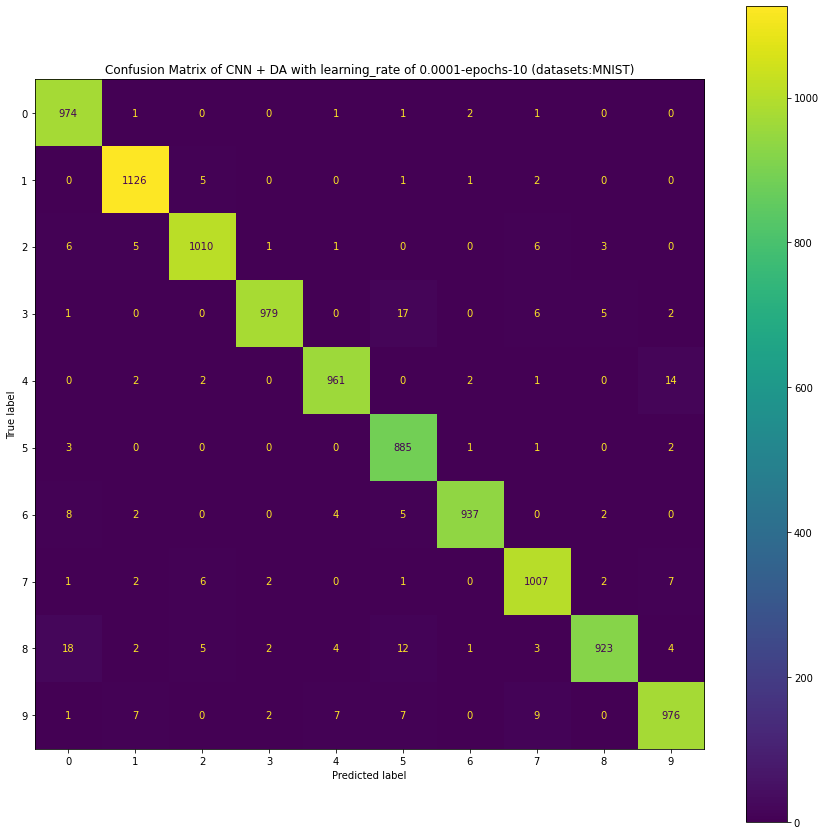

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


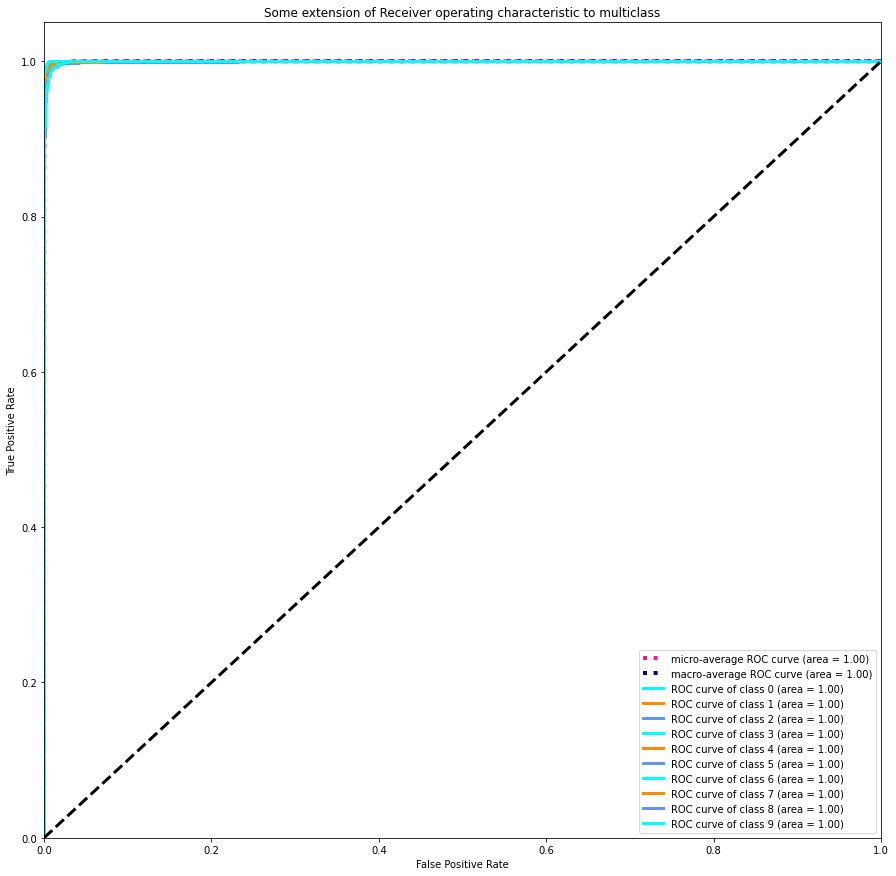

Confusion matrix, without normalization
[[ 974    1    0    0    1    1    2    1    0    0]
 [   0 1126    5    0    0    1    1    2    0    0]
 [   6    5 1010    1    1    0    0    6    3    0]
 [   1    0    0  979    0   17    0    6    5    2]
 [   0    2    2    0  961    0    2    1    0   14]
 [   3    0    0    0    0  885    1    1    0    2]
 [   8    2    0    0    4    5  937    0    2    0]
 [   1    2    6    2    0    1    0 1007    2    7]
 [  18    2    5    2    4   12    1    3  923    4]
 [   1    7    0    2    7    7    0    9    0  976]]


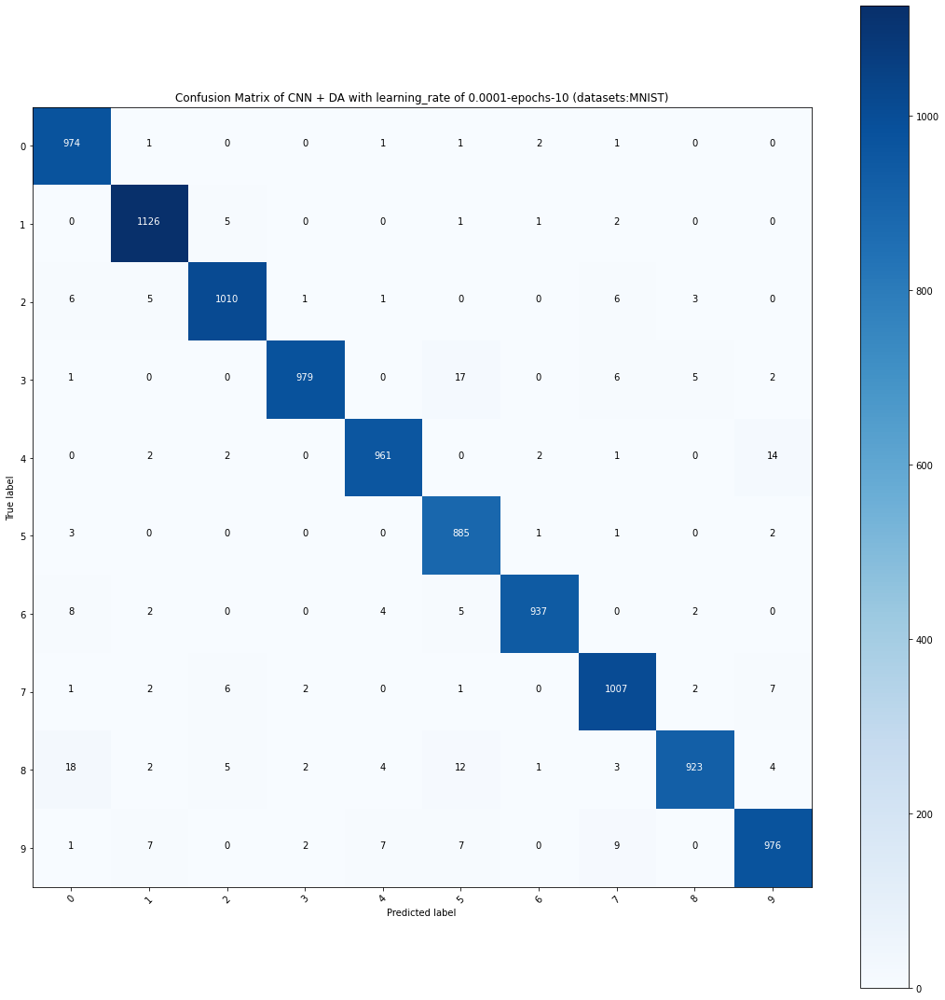

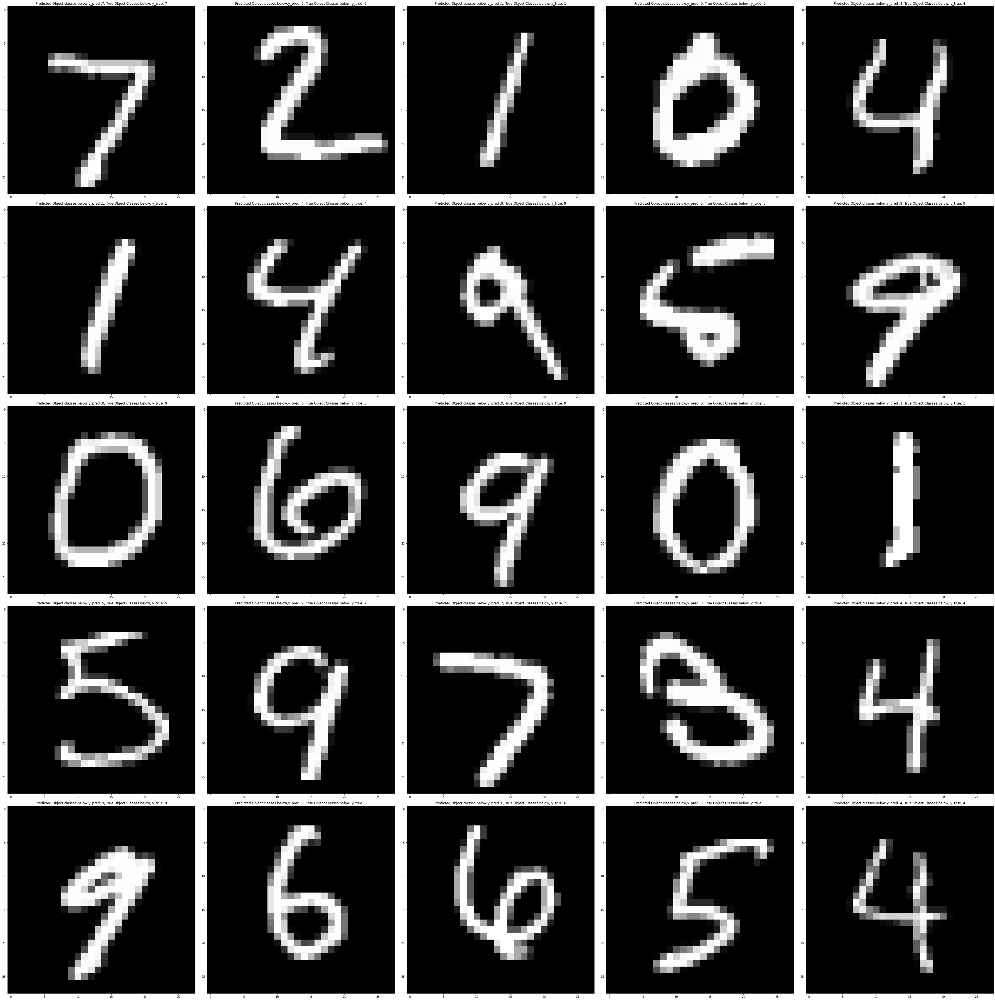

In [23]:
LEARNING_RATE = 0.0001
DATA_AUGMENTATION = True
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "CNN + DA"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_CNN_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 7: LeNet-5 WITHOUT DATA AUGMENTATION (LEARNING RATE = 1E-4)
* learning rate = 0.0001
* Data Augmentation : False

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


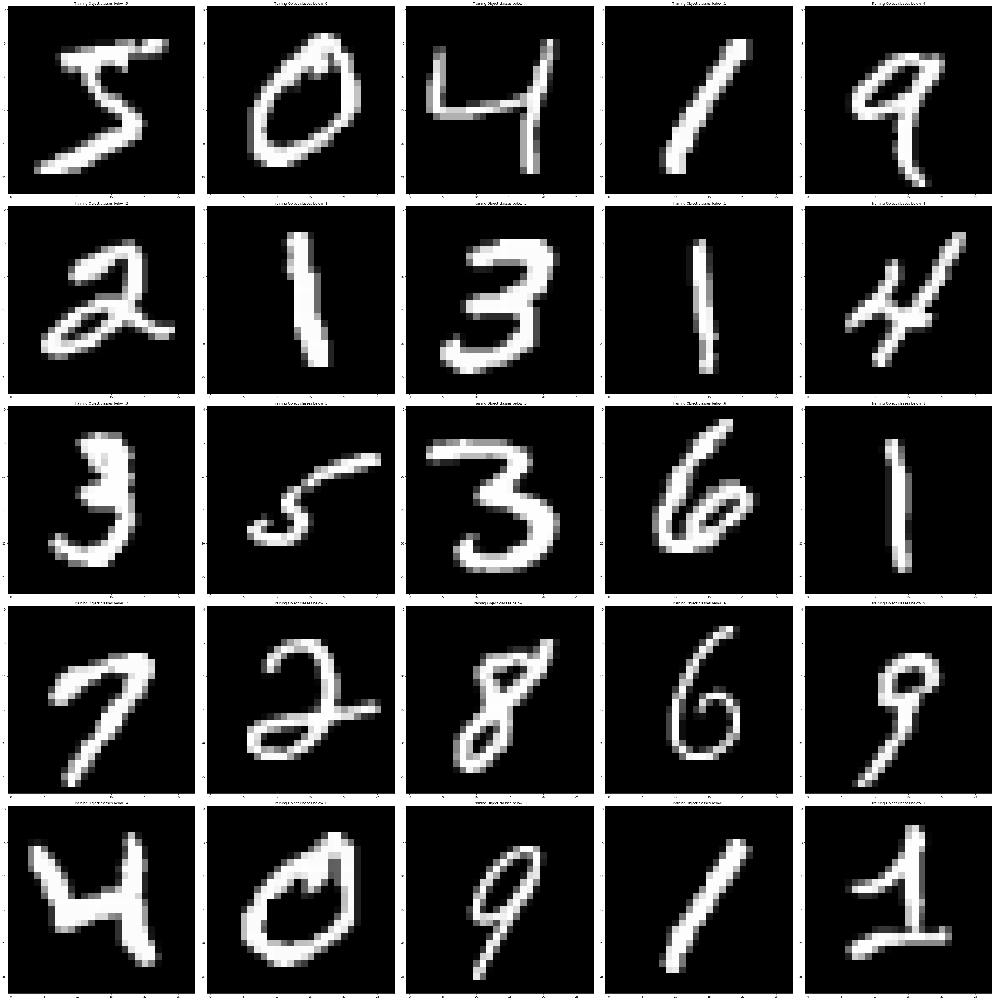

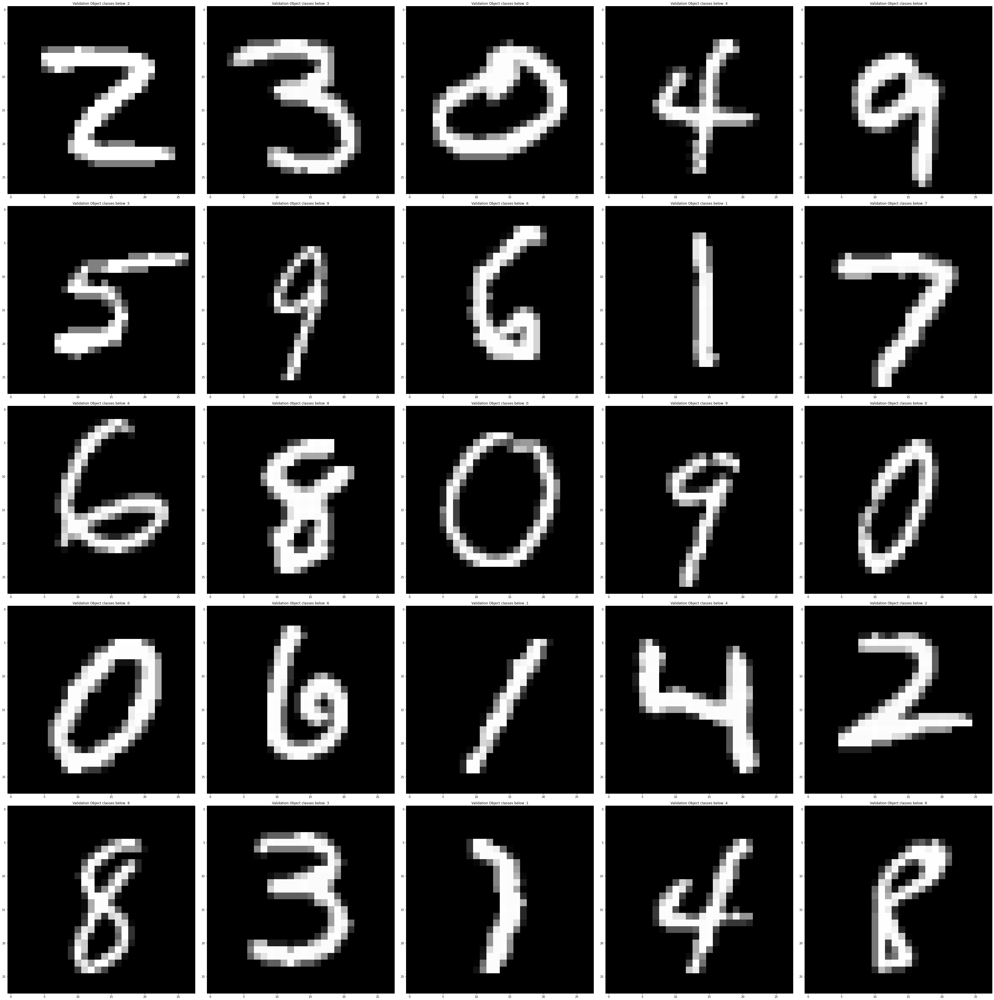

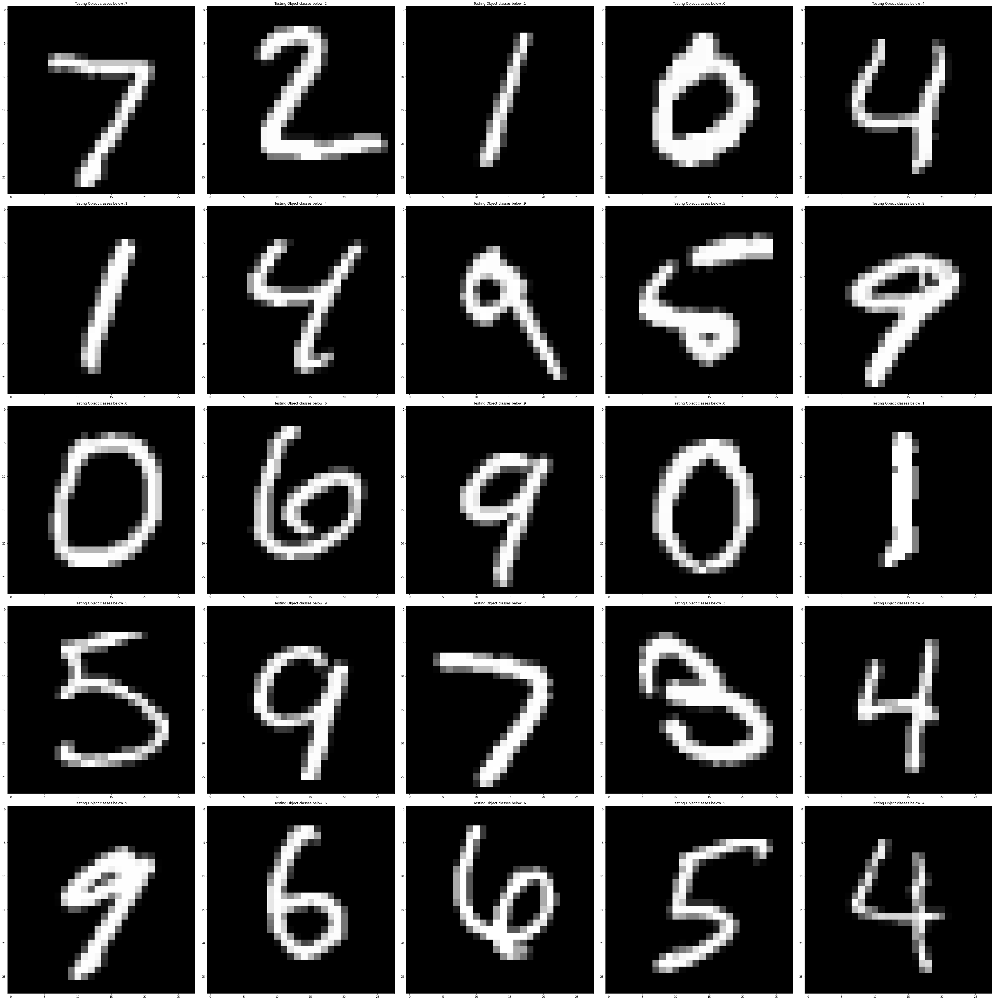

Is data augmentation applied : False
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 average_pooling2d (AverageP  (None, 14, 14, 6)        0         
 ooling2D)                                                       
                                                                 
 activation (Activation)     (None, 14, 14, 6)         0         
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)       

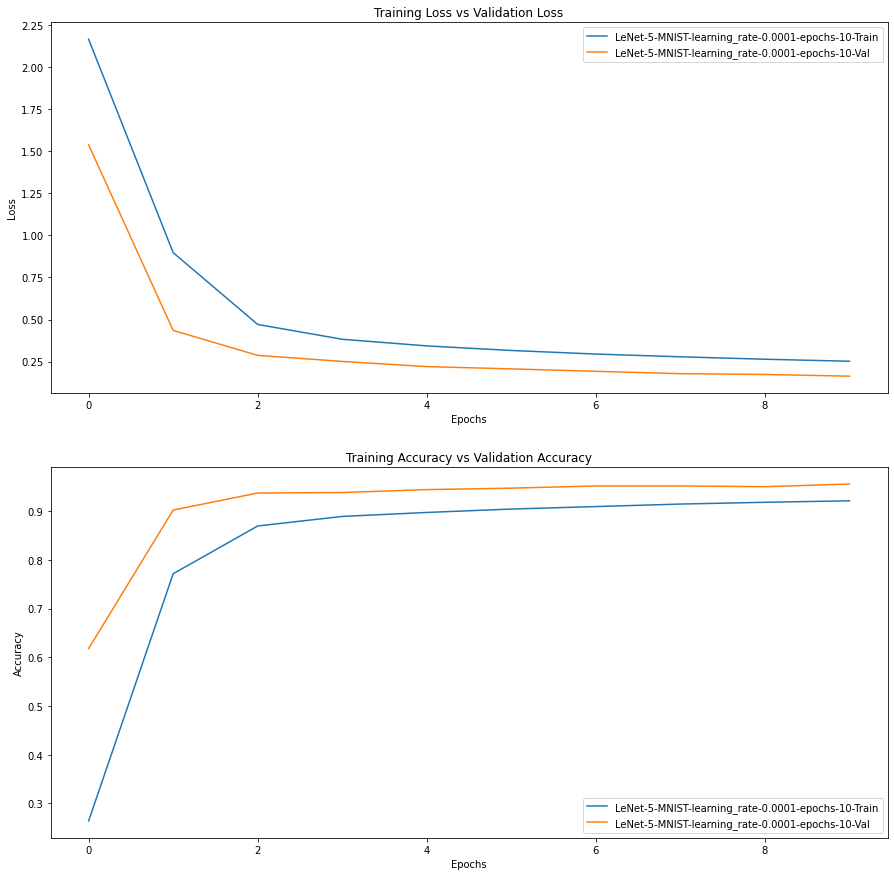

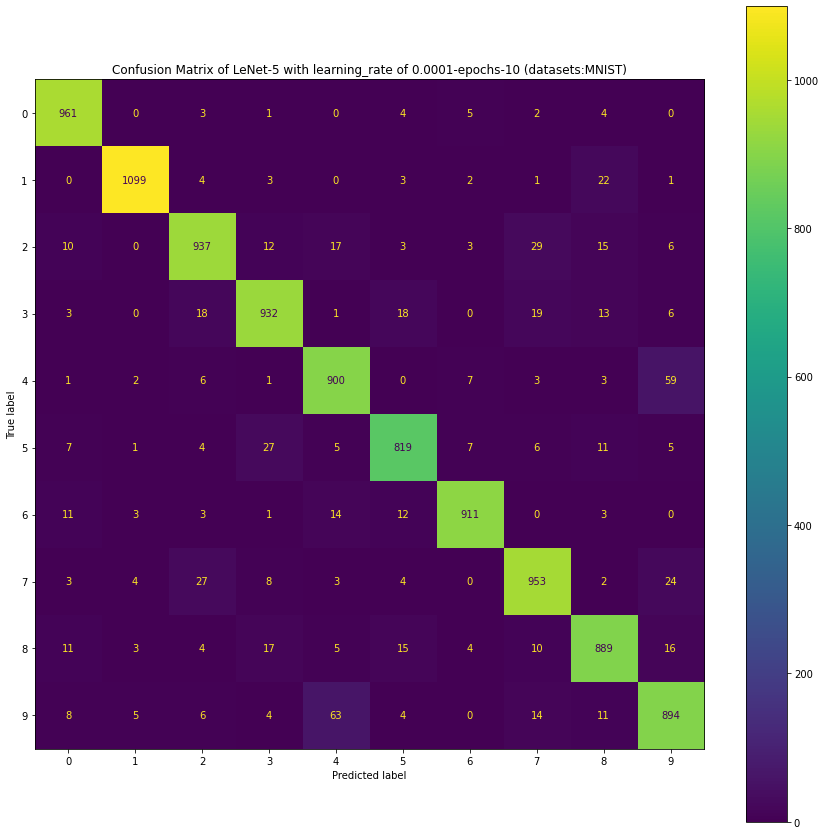

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


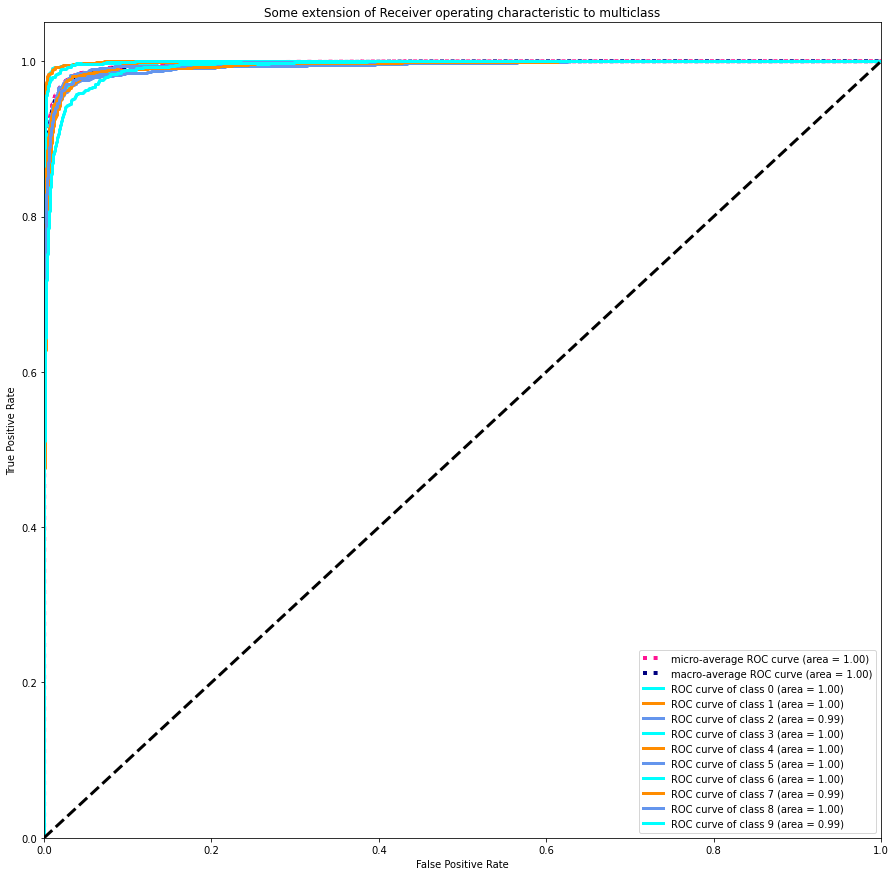

Confusion matrix, without normalization
[[ 961    0    3    1    0    4    5    2    4    0]
 [   0 1099    4    3    0    3    2    1   22    1]
 [  10    0  937   12   17    3    3   29   15    6]
 [   3    0   18  932    1   18    0   19   13    6]
 [   1    2    6    1  900    0    7    3    3   59]
 [   7    1    4   27    5  819    7    6   11    5]
 [  11    3    3    1   14   12  911    0    3    0]
 [   3    4   27    8    3    4    0  953    2   24]
 [  11    3    4   17    5   15    4   10  889   16]
 [   8    5    6    4   63    4    0   14   11  894]]


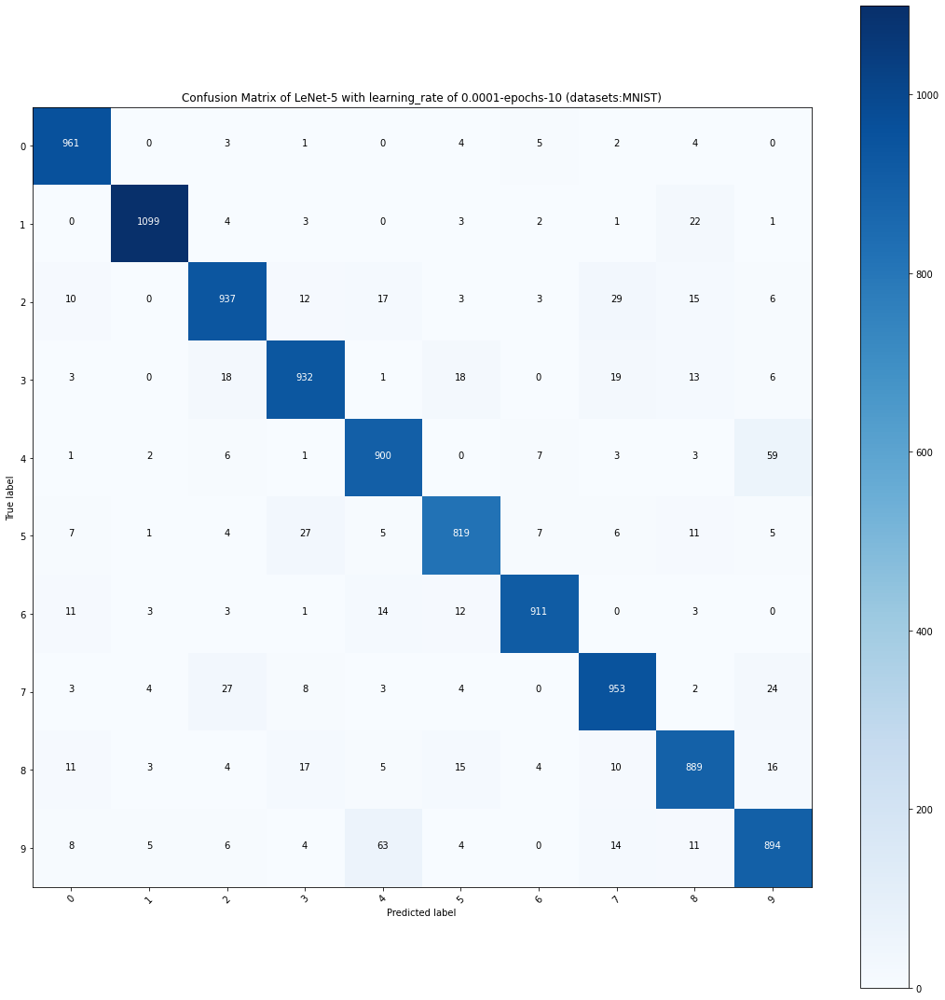

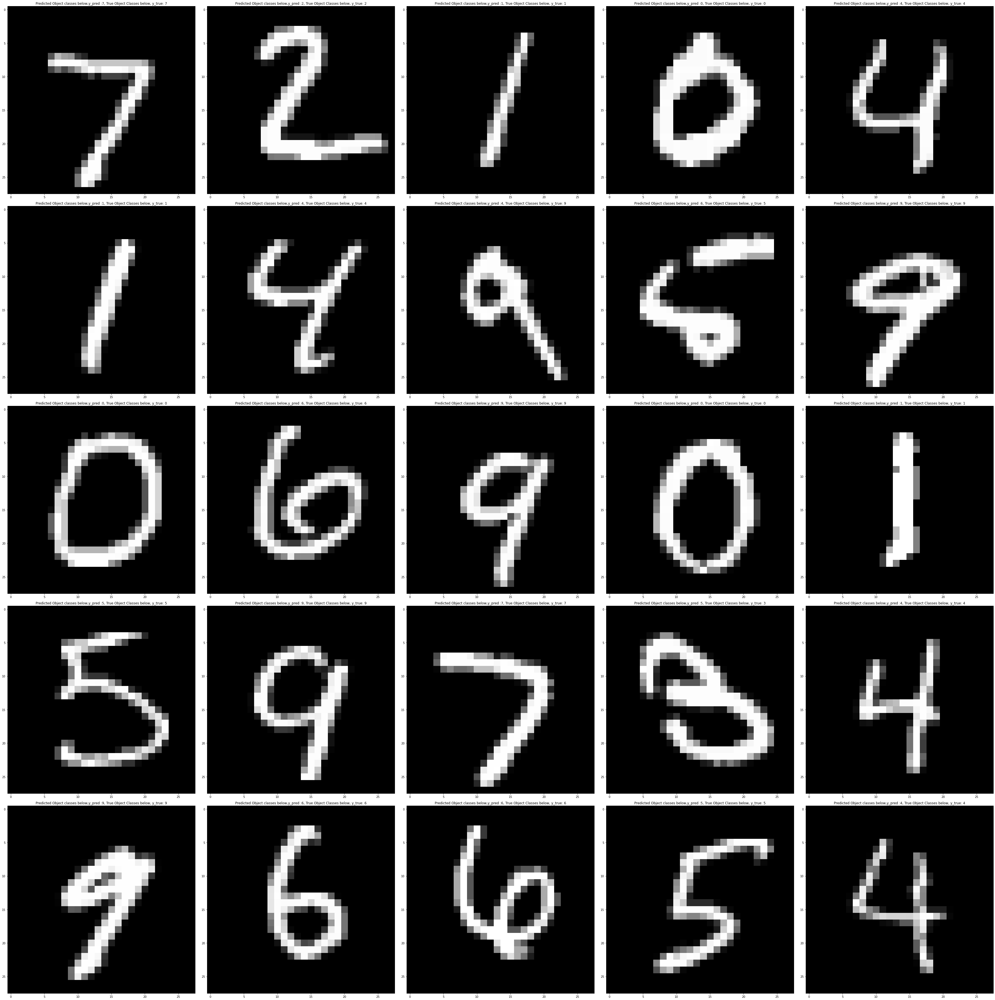

In [24]:
LEARNING_RATE = 0.0001
DATA_AUGMENTATION = False
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "LeNet-5"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_LeNet_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 8: CNN WITHOUT DATA AUGMENTATION (LEARNING RATE = 1E-4)
* learning rate = 0.0001
* Data Augmentation : False

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


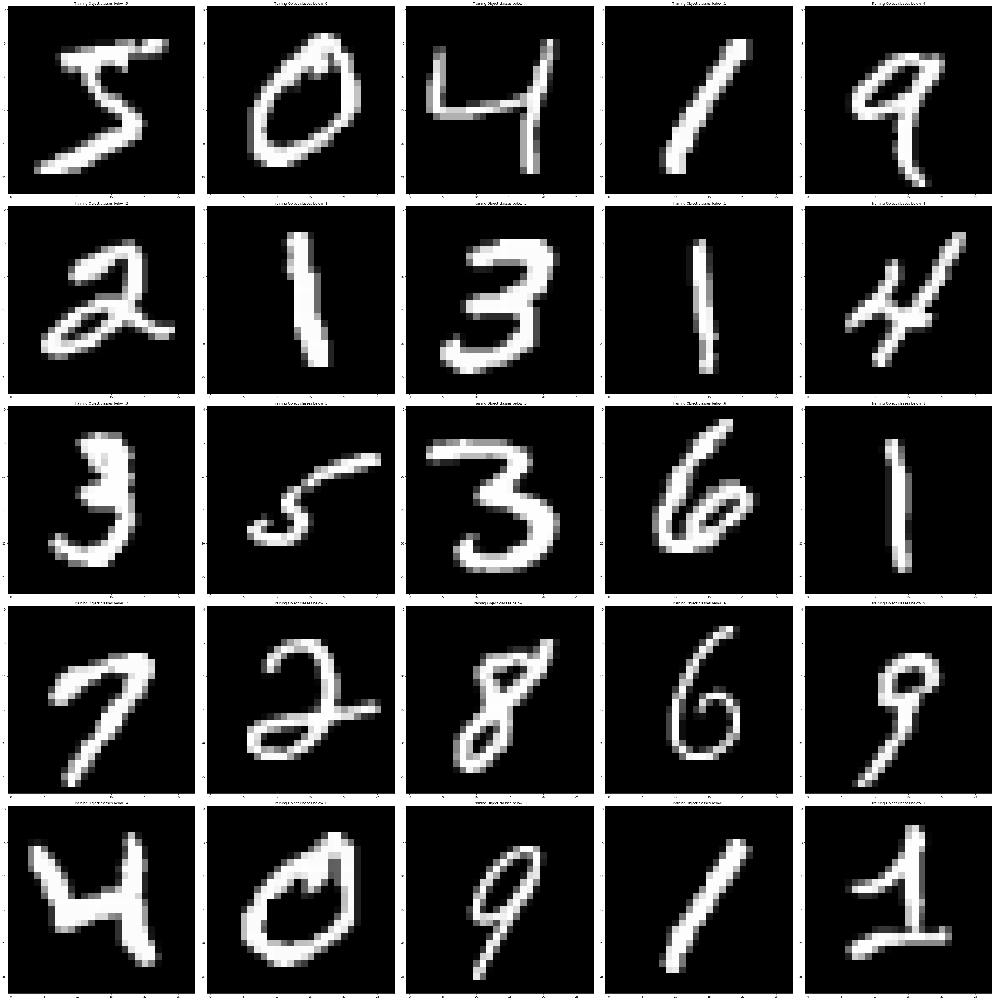

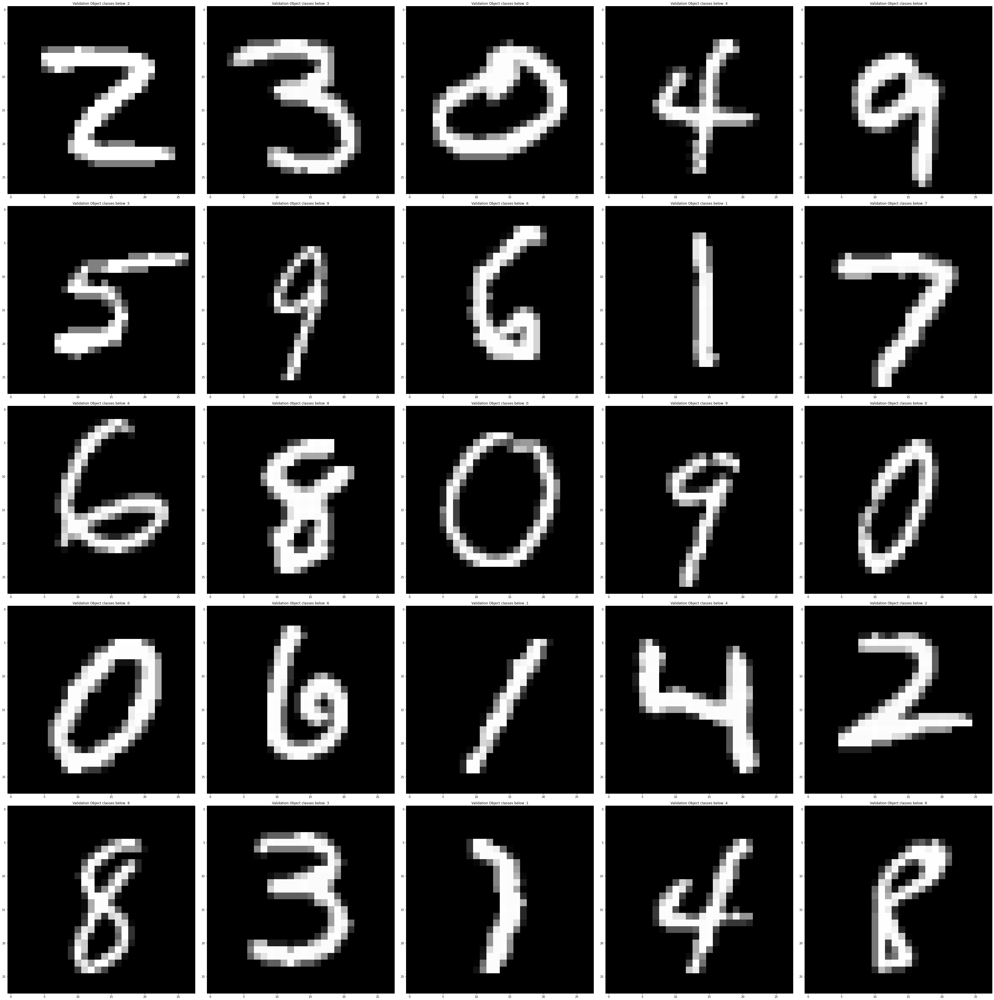

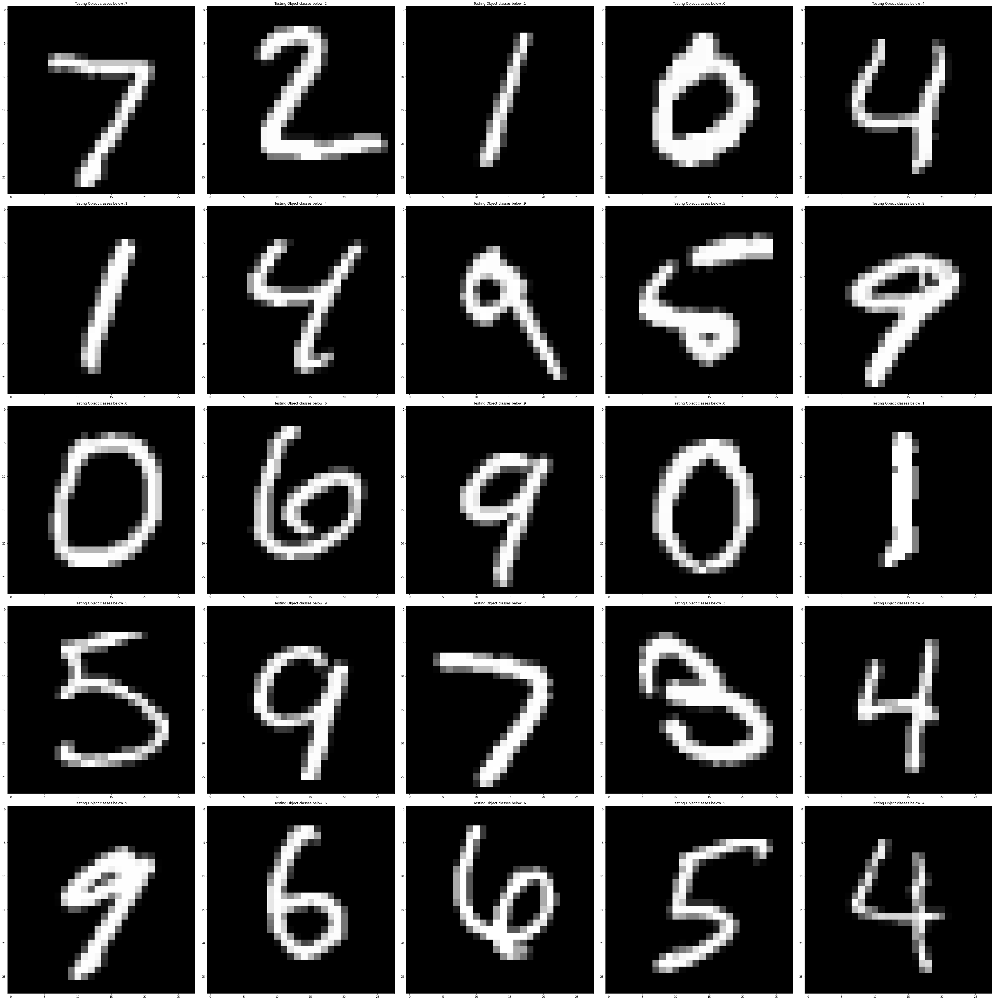

Is data augmentation applied : False
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 6)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 5, 5, 16)         0         
 2D)                                                             
                                                                 
 flatten (Flatten) 

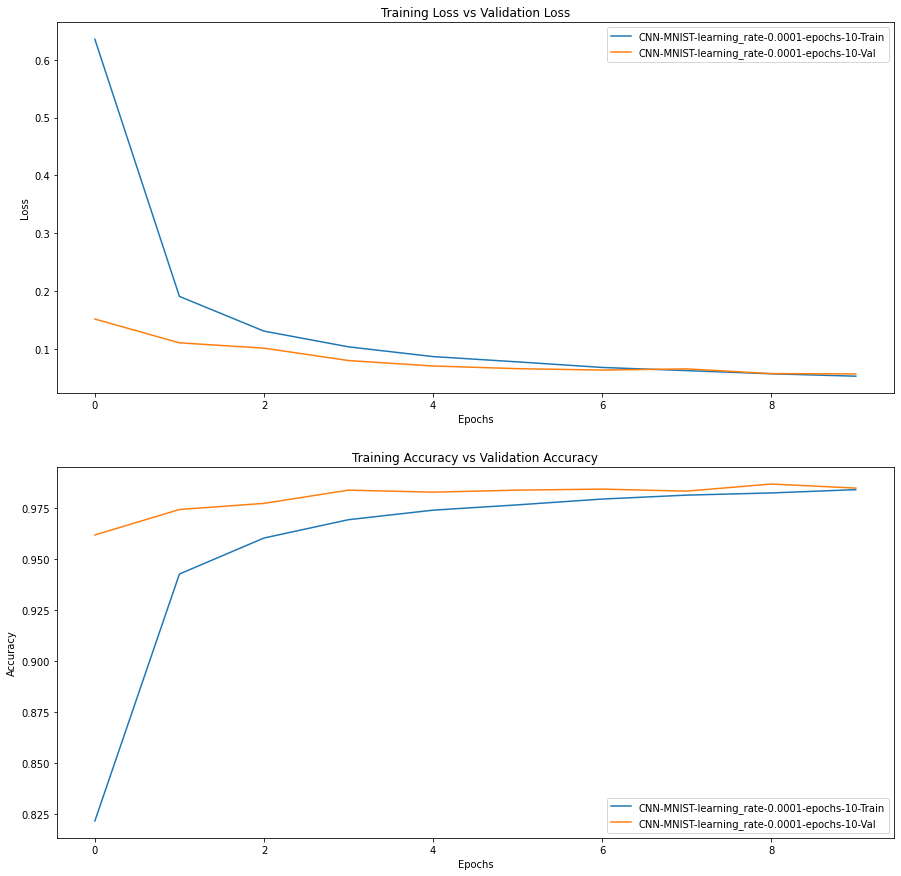

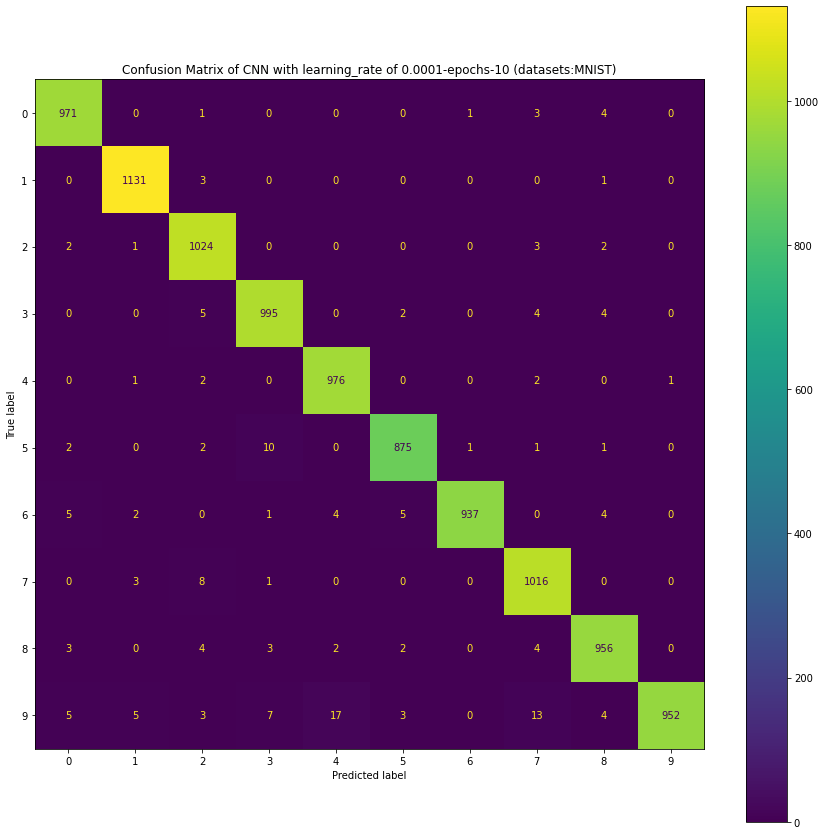

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


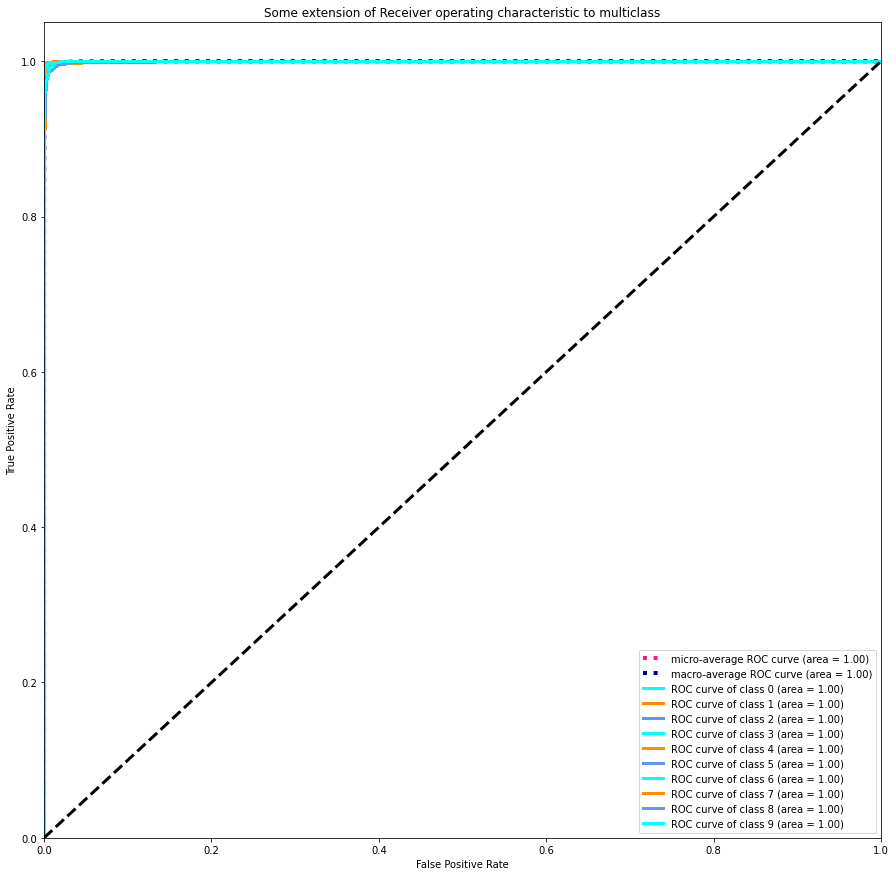

Confusion matrix, without normalization
[[ 971    0    1    0    0    0    1    3    4    0]
 [   0 1131    3    0    0    0    0    0    1    0]
 [   2    1 1024    0    0    0    0    3    2    0]
 [   0    0    5  995    0    2    0    4    4    0]
 [   0    1    2    0  976    0    0    2    0    1]
 [   2    0    2   10    0  875    1    1    1    0]
 [   5    2    0    1    4    5  937    0    4    0]
 [   0    3    8    1    0    0    0 1016    0    0]
 [   3    0    4    3    2    2    0    4  956    0]
 [   5    5    3    7   17    3    0   13    4  952]]


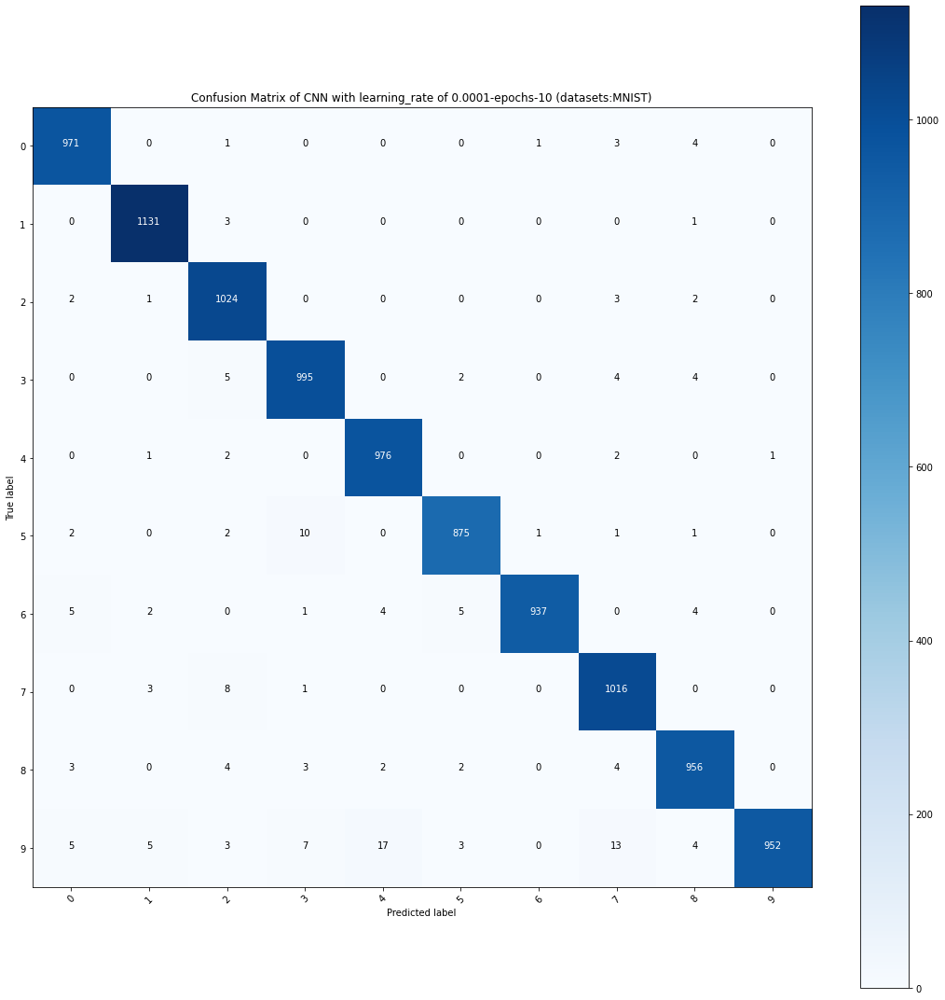

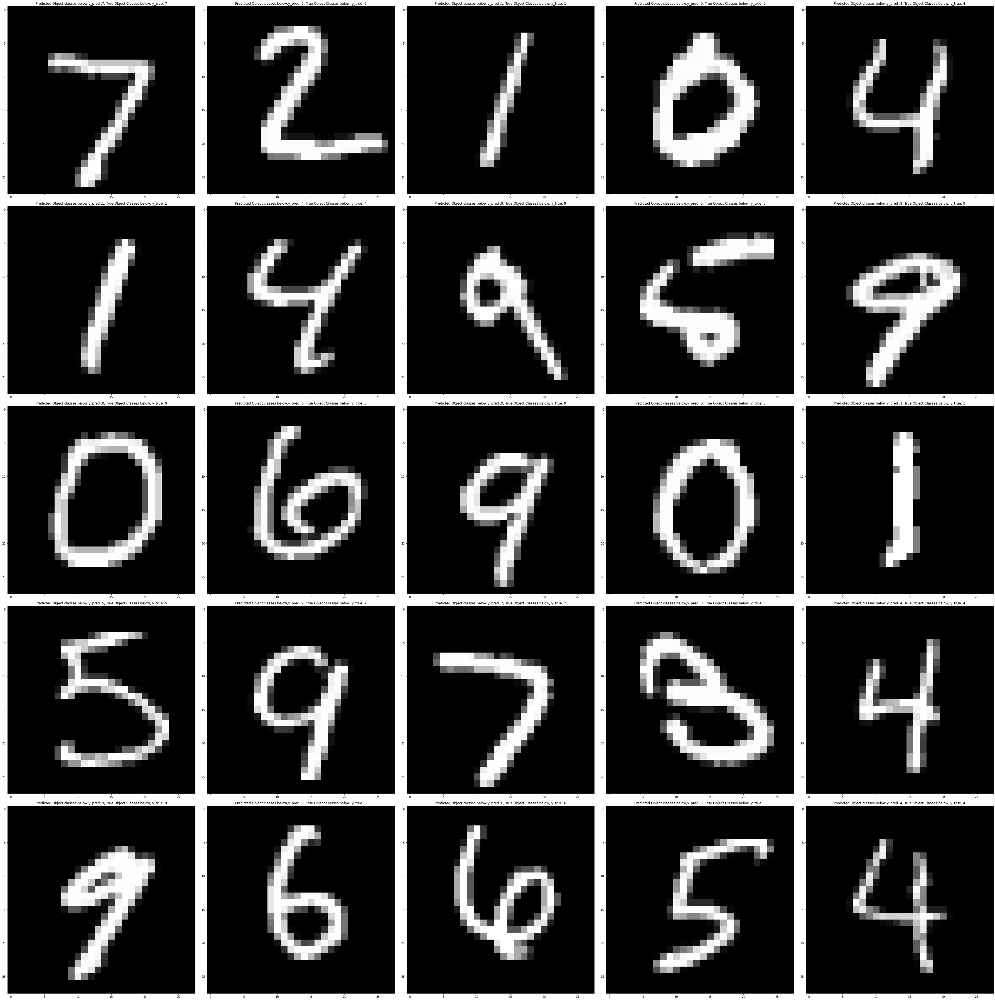

In [25]:
LEARNING_RATE = 0.0001
DATA_AUGMENTATION = False
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "CNN"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_CNN_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 9: LeNet-5 WITH DATA AUGMENTATION (LEARNING RATE = 1E-5)
* learning rate = 0.00001
* Data Augmentation : True

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


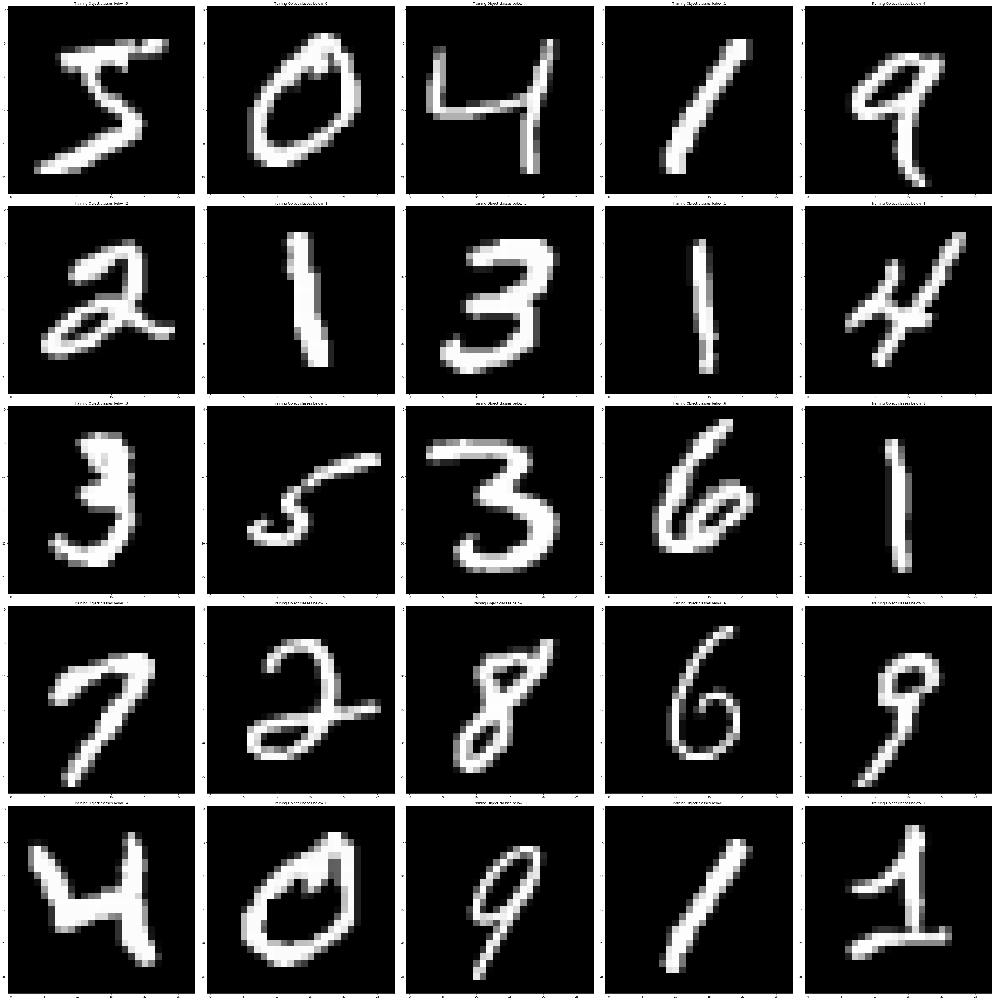

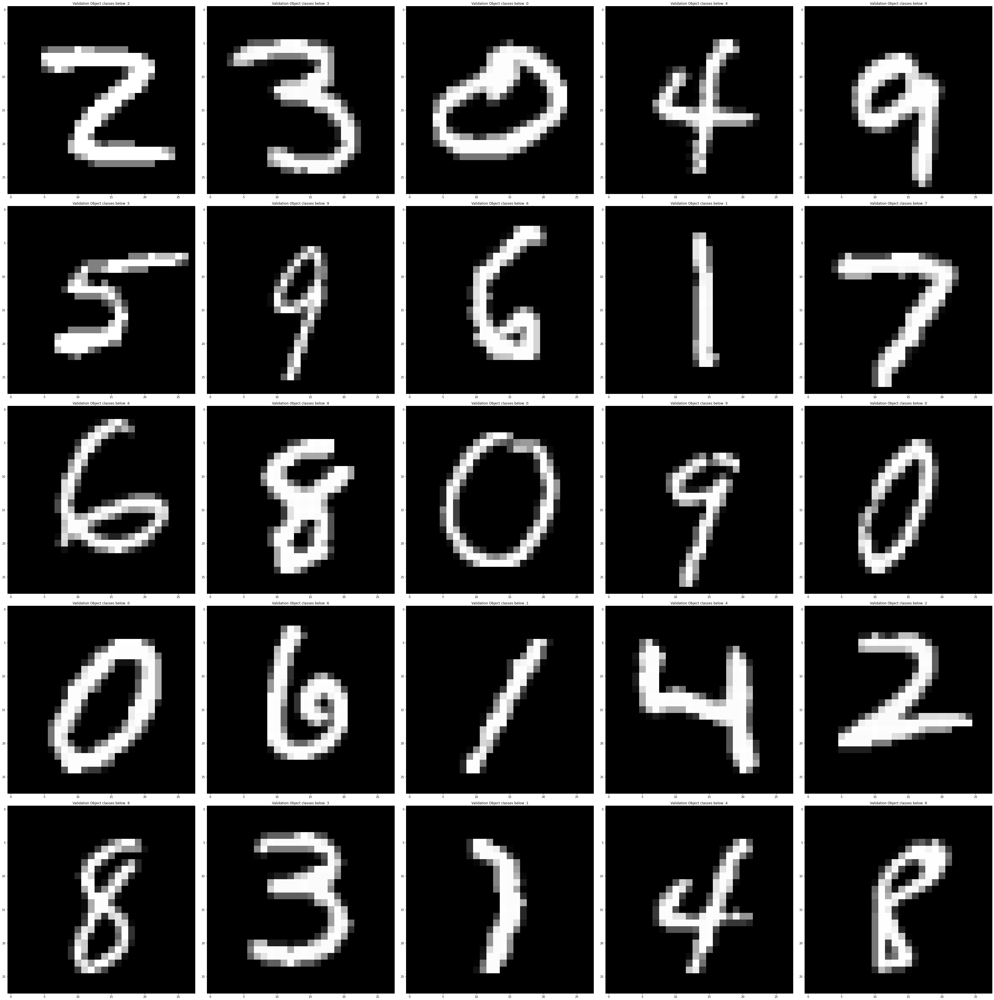

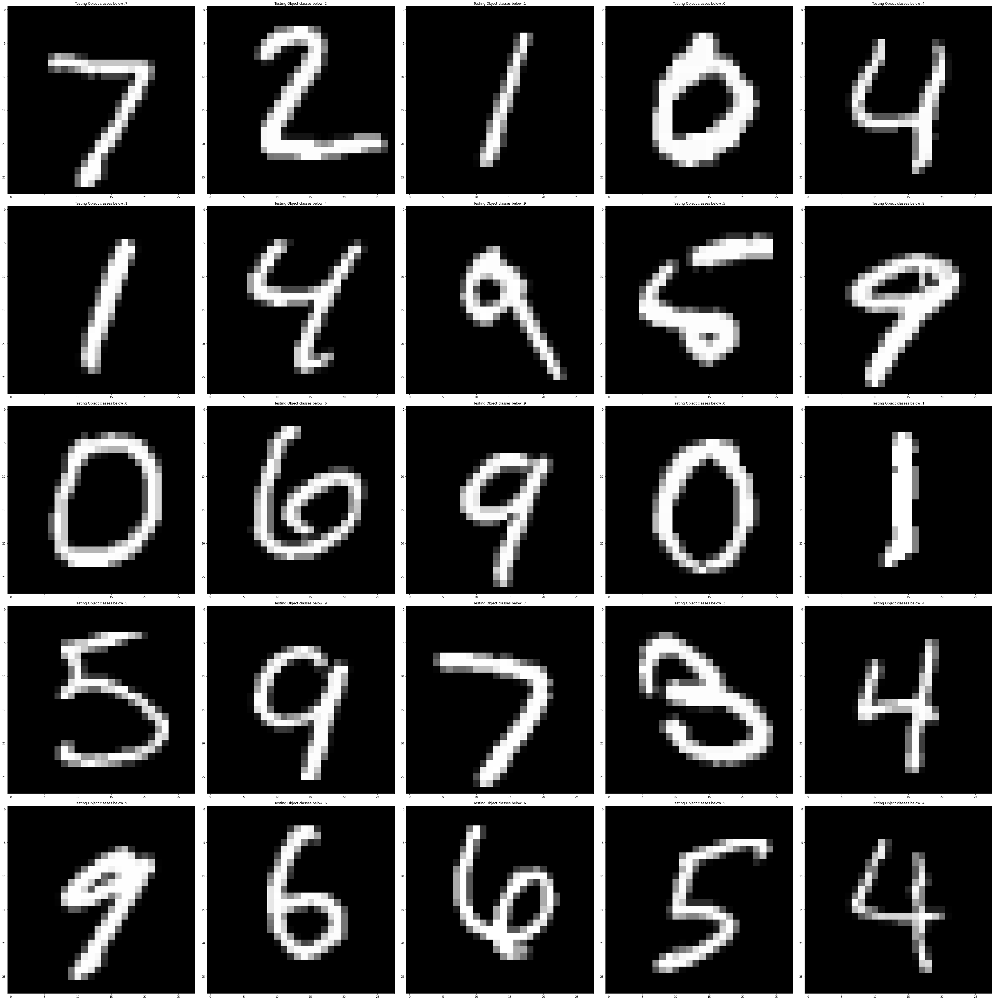

Is data augmentation applied : True
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 average_pooling2d (AverageP  (None, 14, 14, 6)        0         
 ooling2D)                                                       
                                                                 
 activation (Activation)     (None, 14, 14, 6)         0         
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)        

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:46: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


906/906 [==============================] - 26s 28ms/step - loss: 2.3066 - accuracy: 0.1114 - val_loss: 2.2984 - val_accuracy: 0.1285
Epoch 2/10
906/906 [==============================] - 25s 27ms/step - loss: 2.2977 - accuracy: 0.1142 - val_loss: 2.2934 - val_accuracy: 0.1070
Epoch 3/10
906/906 [==============================] - 25s 28ms/step - loss: 2.2930 - accuracy: 0.1236 - val_loss: 2.2862 - val_accuracy: 0.1070
Epoch 4/10
906/906 [==============================] - 25s 27ms/step - loss: 2.2858 - accuracy: 0.1397 - val_loss: 2.2727 - val_accuracy: 0.2130
Epoch 5/10
906/906 [==============================] - 25s 27ms/step - loss: 2.2733 - accuracy: 0.1822 - val_loss: 2.2517 - val_accuracy: 0.1925
Epoch 6/10
906/906 [==============================] - 25s 27ms/step - loss: 2.2524 - accuracy: 0.2295 - val_loss: 2.2153 - val_accuracy: 0.3965
Epoch 7/10
906/906 [==============================] - 25s 27ms/step - loss: 2.2191 - accuracy: 0.2831 - val_loss: 2.1612 - val_accuracy: 0.4290
Epo

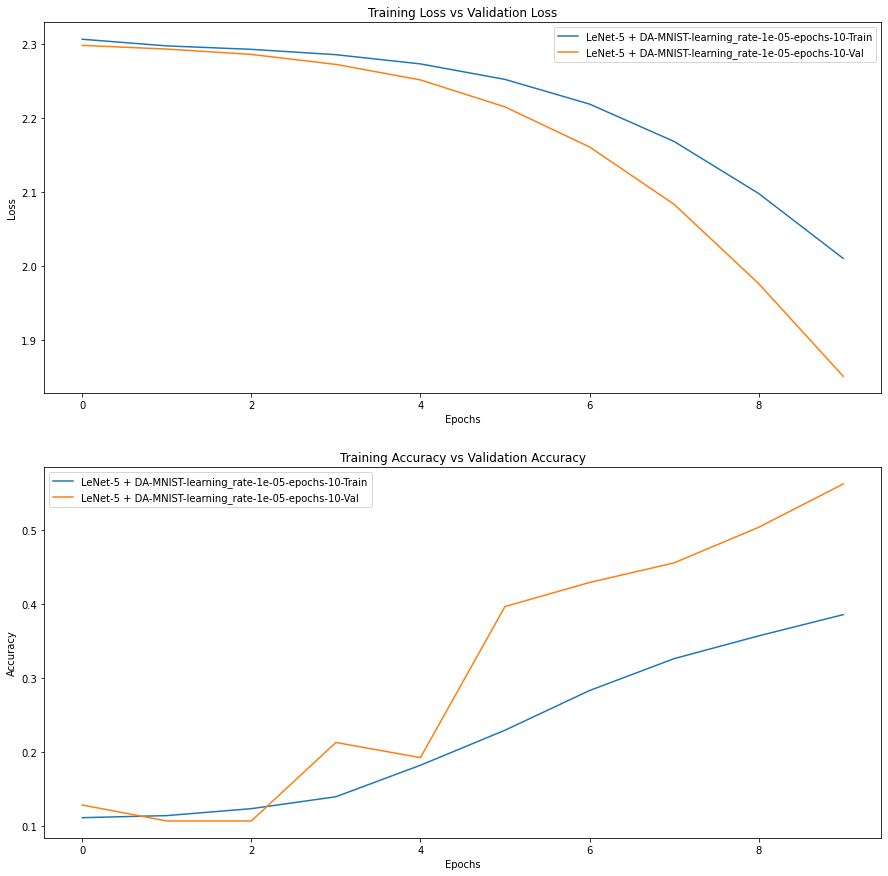

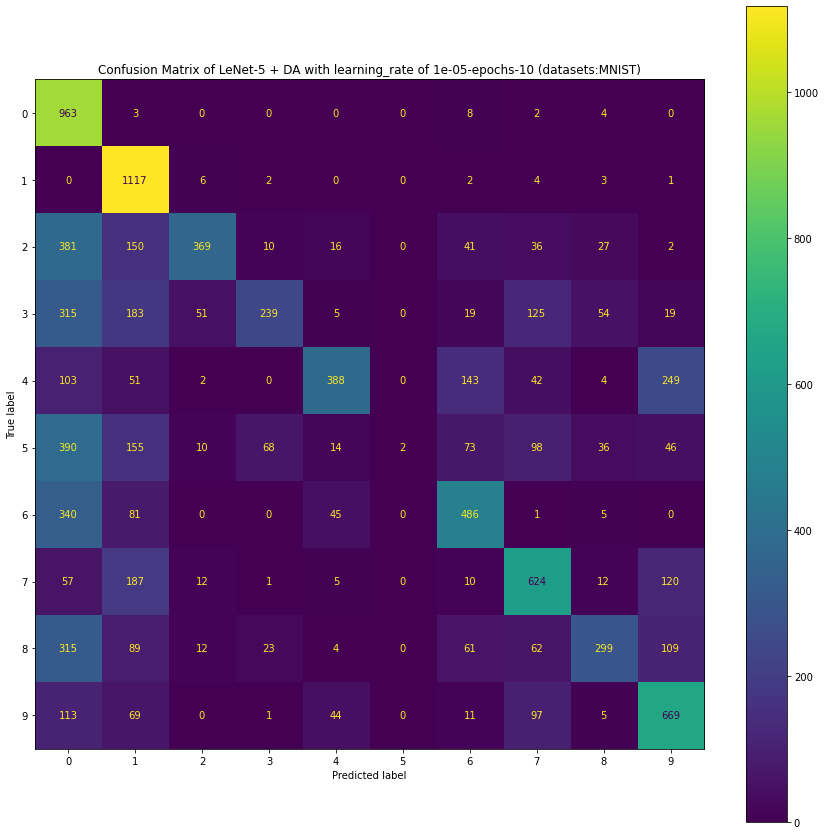

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


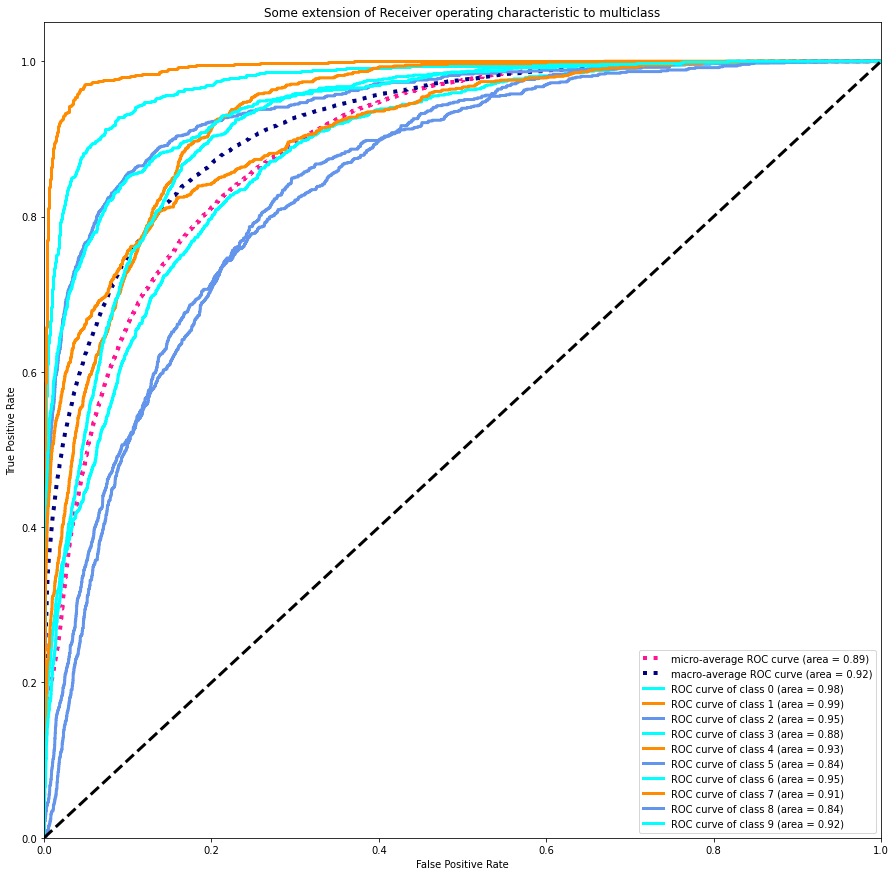

Confusion matrix, without normalization
[[ 963    3    0    0    0    0    8    2    4    0]
 [   0 1117    6    2    0    0    2    4    3    1]
 [ 381  150  369   10   16    0   41   36   27    2]
 [ 315  183   51  239    5    0   19  125   54   19]
 [ 103   51    2    0  388    0  143   42    4  249]
 [ 390  155   10   68   14    2   73   98   36   46]
 [ 340   81    0    0   45    0  486    1    5    0]
 [  57  187   12    1    5    0   10  624   12  120]
 [ 315   89   12   23    4    0   61   62  299  109]
 [ 113   69    0    1   44    0   11   97    5  669]]


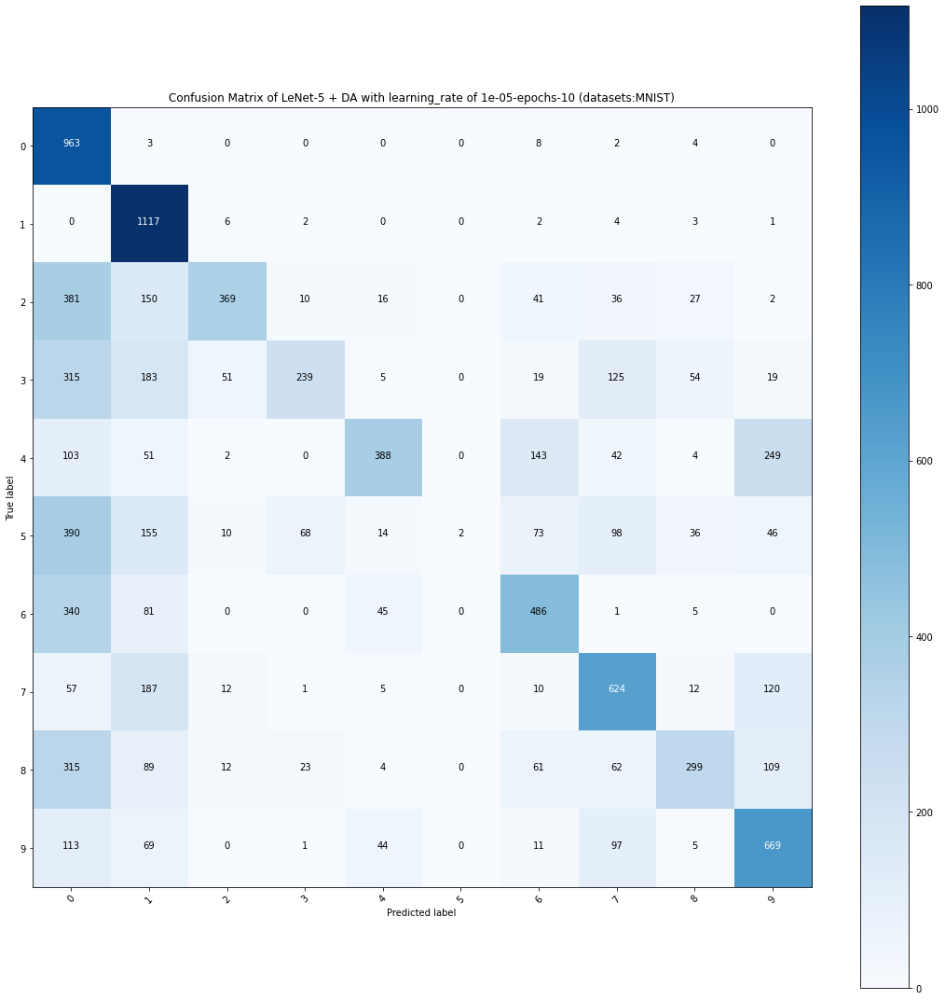

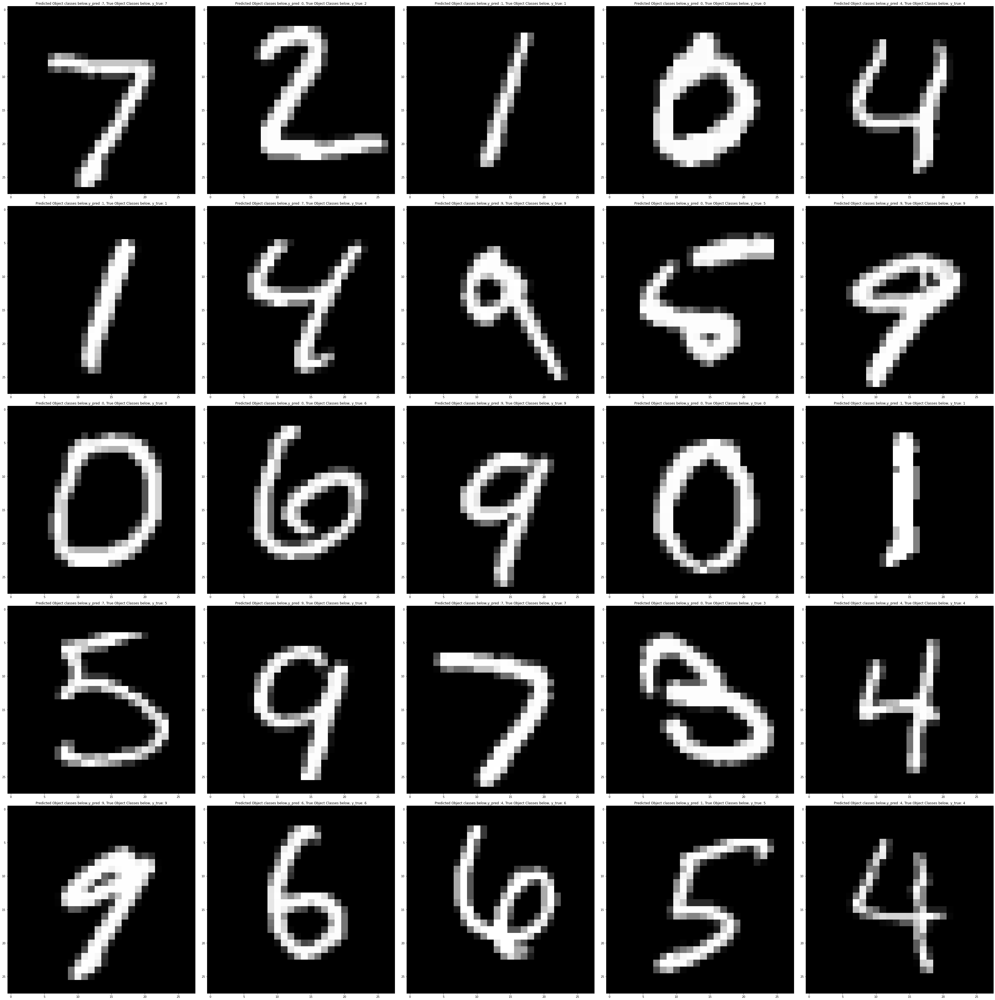

In [26]:
LEARNING_RATE = 0.00001
DATA_AUGMENTATION = True
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "LeNet-5 + DA"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_LeNet_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 10: CNN WITH DATA AUGMENTATION (LEARNING RATE = 1E-5)
* learning rate = 0.00001
* Data Augmentation : True

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


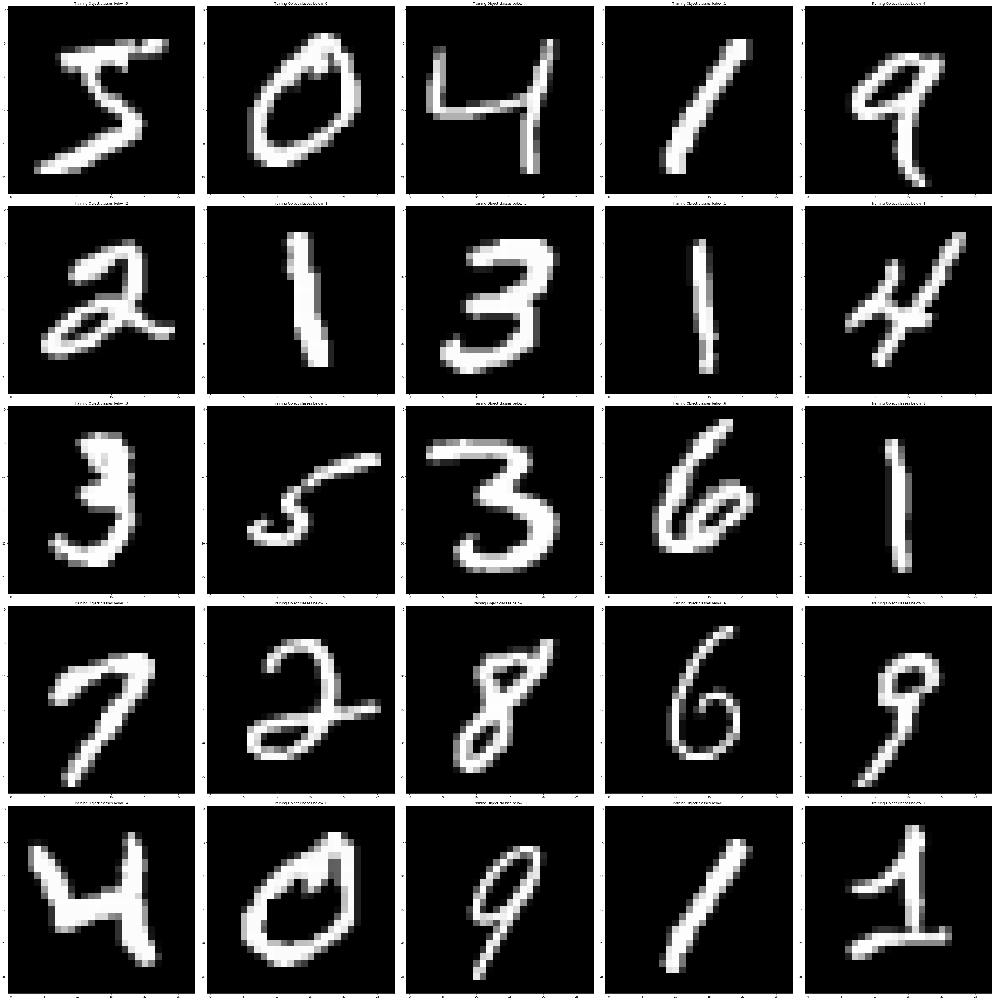

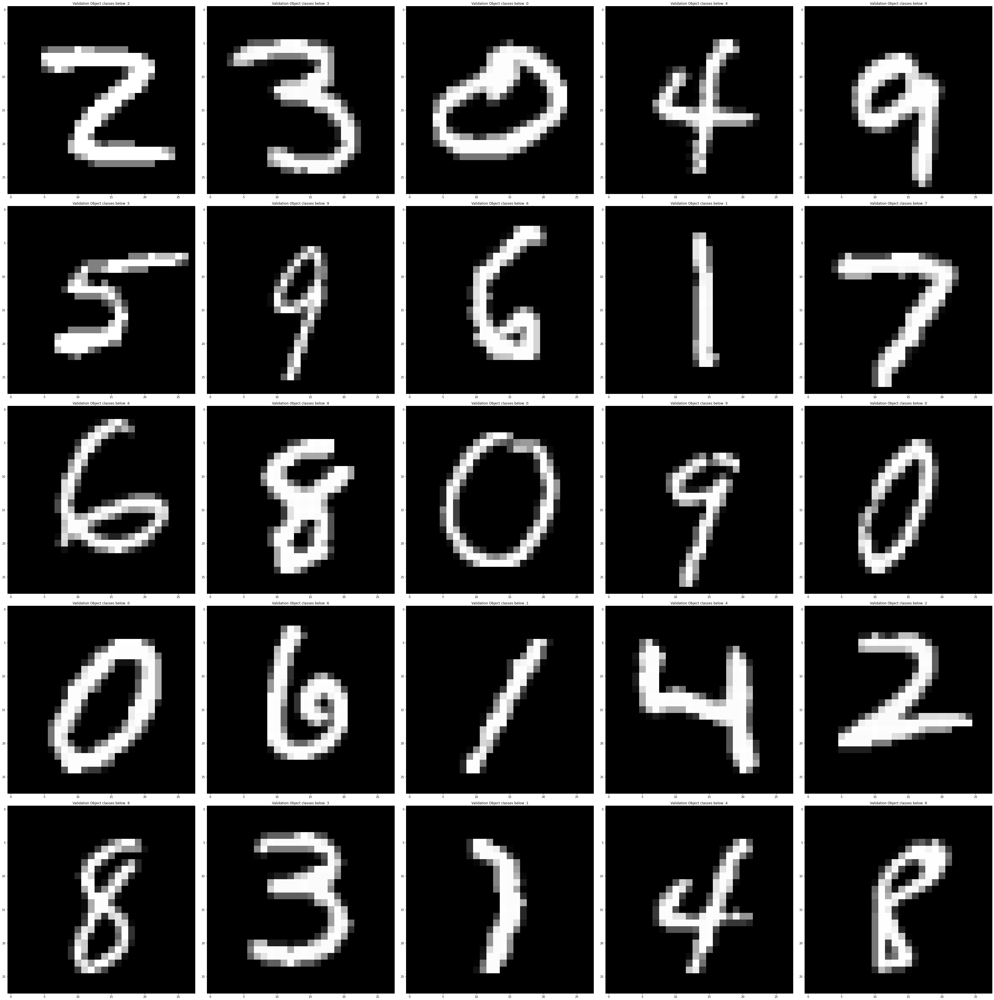

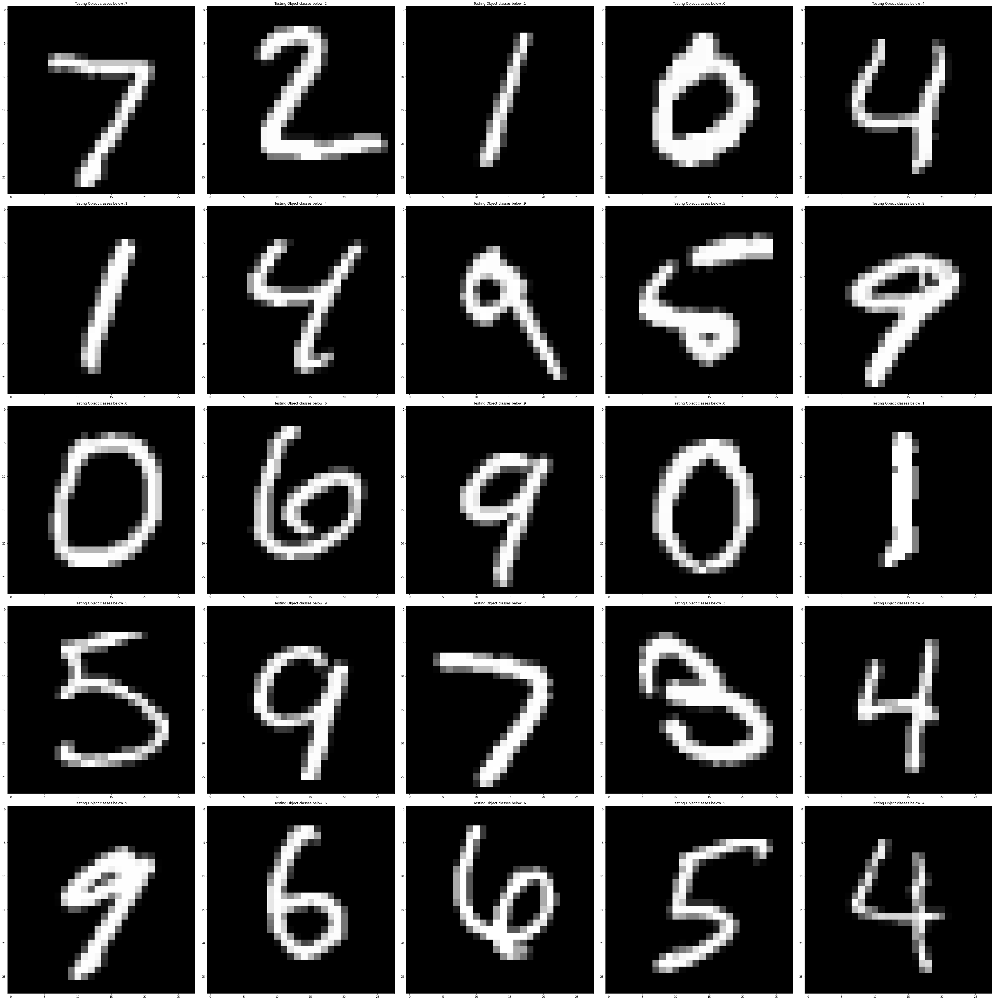

Is data augmentation applied : True
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 6)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 5, 5, 16)         0         
 2D)                                                             
                                                                 
 flatten (Flatten)  

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:46: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.


906/906 [==============================] - 25s 28ms/step - loss: 2.1857 - accuracy: 0.2576 - val_loss: 1.7052 - val_accuracy: 0.6085
Epoch 2/10
906/906 [==============================] - 25s 27ms/step - loss: 1.5701 - accuracy: 0.5302 - val_loss: 0.7780 - val_accuracy: 0.8550
Epoch 3/10
906/906 [==============================] - 25s 27ms/step - loss: 1.1405 - accuracy: 0.6501 - val_loss: 0.4596 - val_accuracy: 0.9140
Epoch 4/10
906/906 [==============================] - 25s 27ms/step - loss: 0.9282 - accuracy: 0.7124 - val_loss: 0.3327 - val_accuracy: 0.9335
Epoch 5/10
906/906 [==============================] - 25s 27ms/step - loss: 0.7897 - accuracy: 0.7551 - val_loss: 0.2697 - val_accuracy: 0.9480
Epoch 6/10
906/906 [==============================] - 25s 27ms/step - loss: 0.6860 - accuracy: 0.7893 - val_loss: 0.2299 - val_accuracy: 0.9540
Epoch 7/10
906/906 [==============================] - 25s 27ms/step - loss: 0.6001 - accuracy: 0.8176 - val_loss: 0.2028 - val_accuracy: 0.9575
Epo

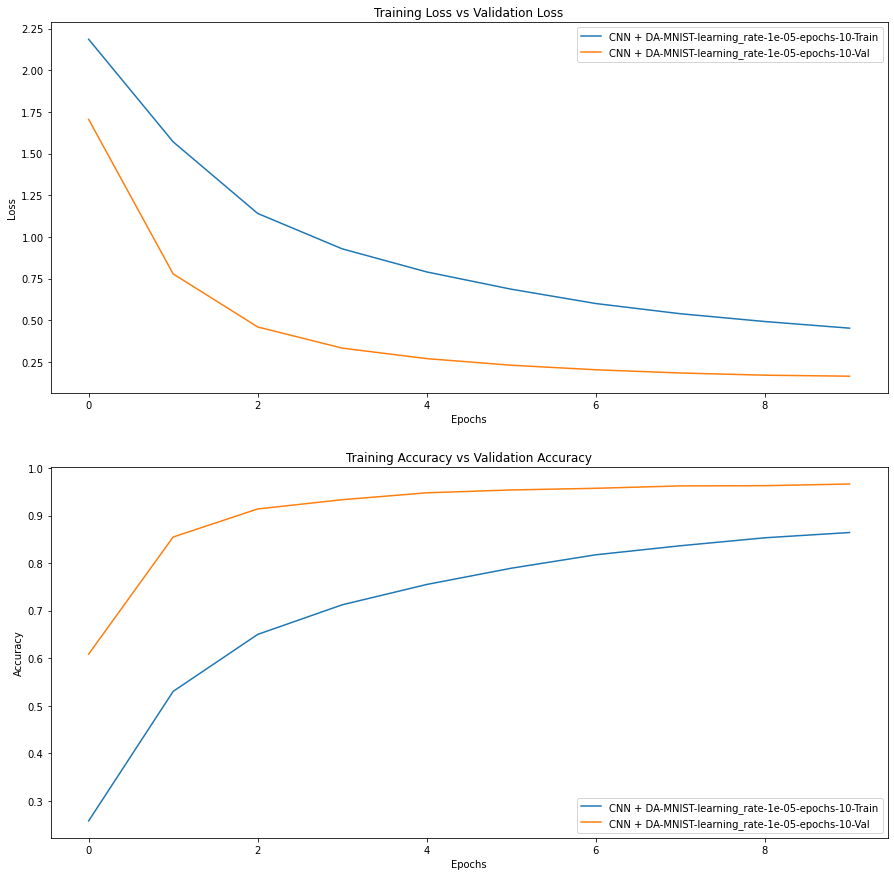

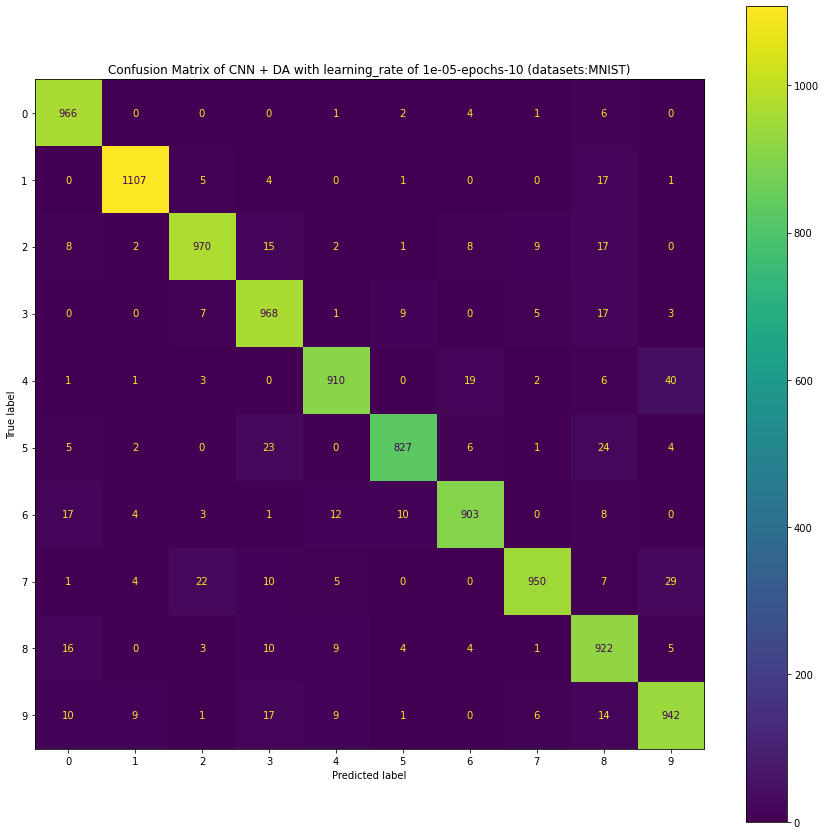

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


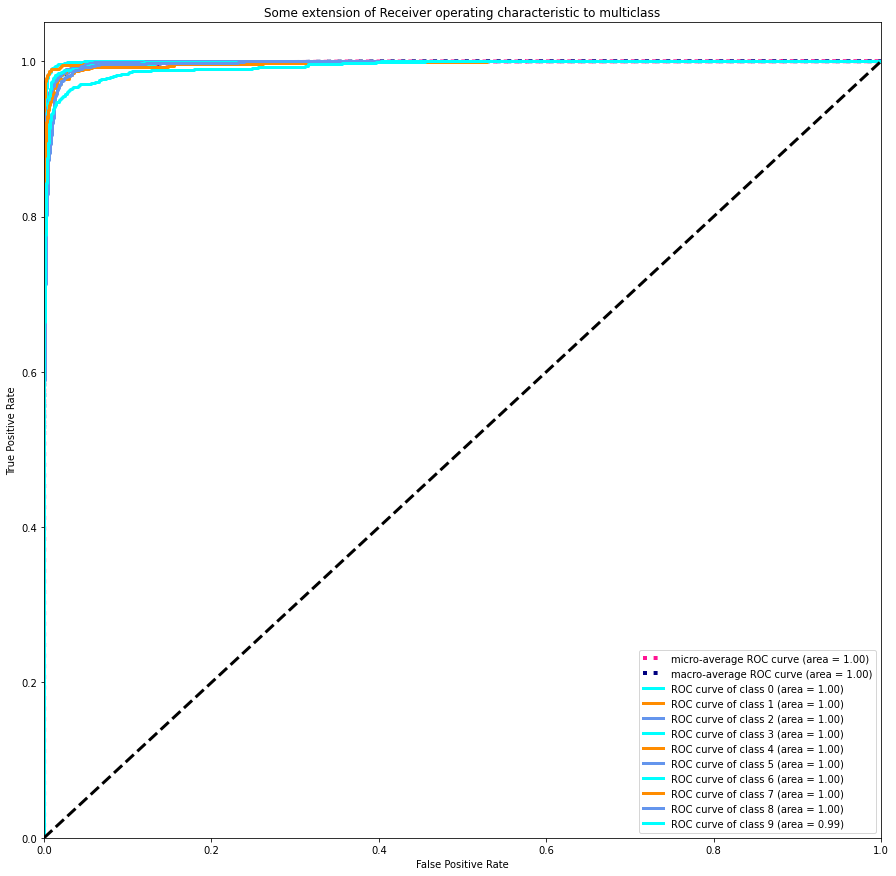

Confusion matrix, without normalization
[[ 966    0    0    0    1    2    4    1    6    0]
 [   0 1107    5    4    0    1    0    0   17    1]
 [   8    2  970   15    2    1    8    9   17    0]
 [   0    0    7  968    1    9    0    5   17    3]
 [   1    1    3    0  910    0   19    2    6   40]
 [   5    2    0   23    0  827    6    1   24    4]
 [  17    4    3    1   12   10  903    0    8    0]
 [   1    4   22   10    5    0    0  950    7   29]
 [  16    0    3   10    9    4    4    1  922    5]
 [  10    9    1   17    9    1    0    6   14  942]]


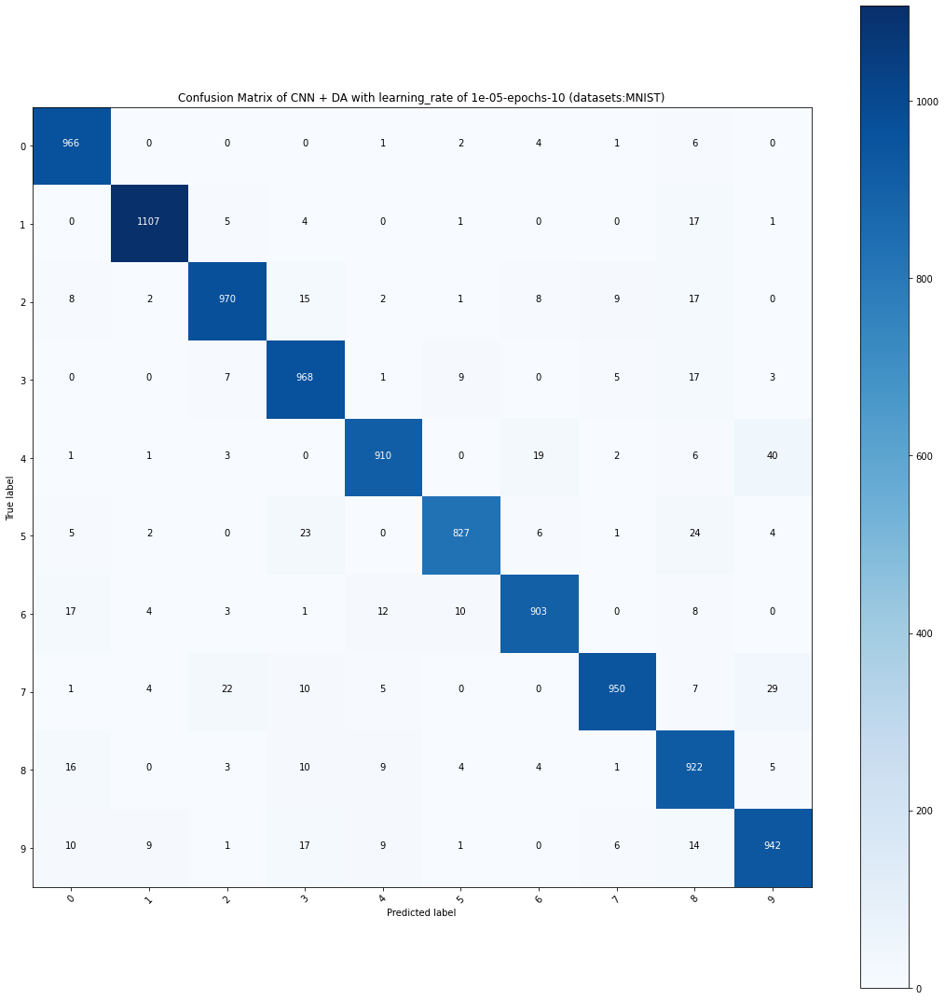

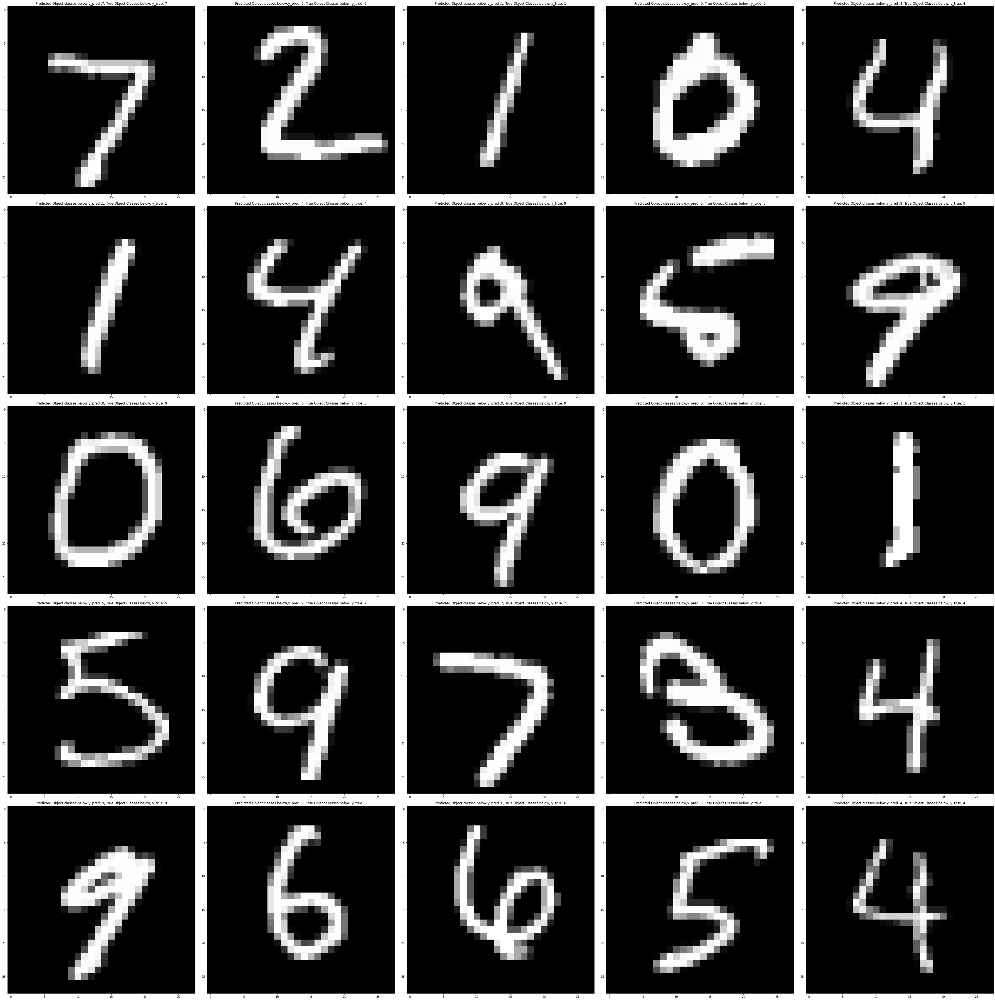

In [27]:
LEARNING_RATE = 0.00001
DATA_AUGMENTATION = True
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "CNN + DA"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_CNN_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 11: LeNet-5 WITHOUT DATA AUGMENTATION (LEARNING RATE = 1E-5)
* learning rate = 0.00001
* Data Augmentation : False

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


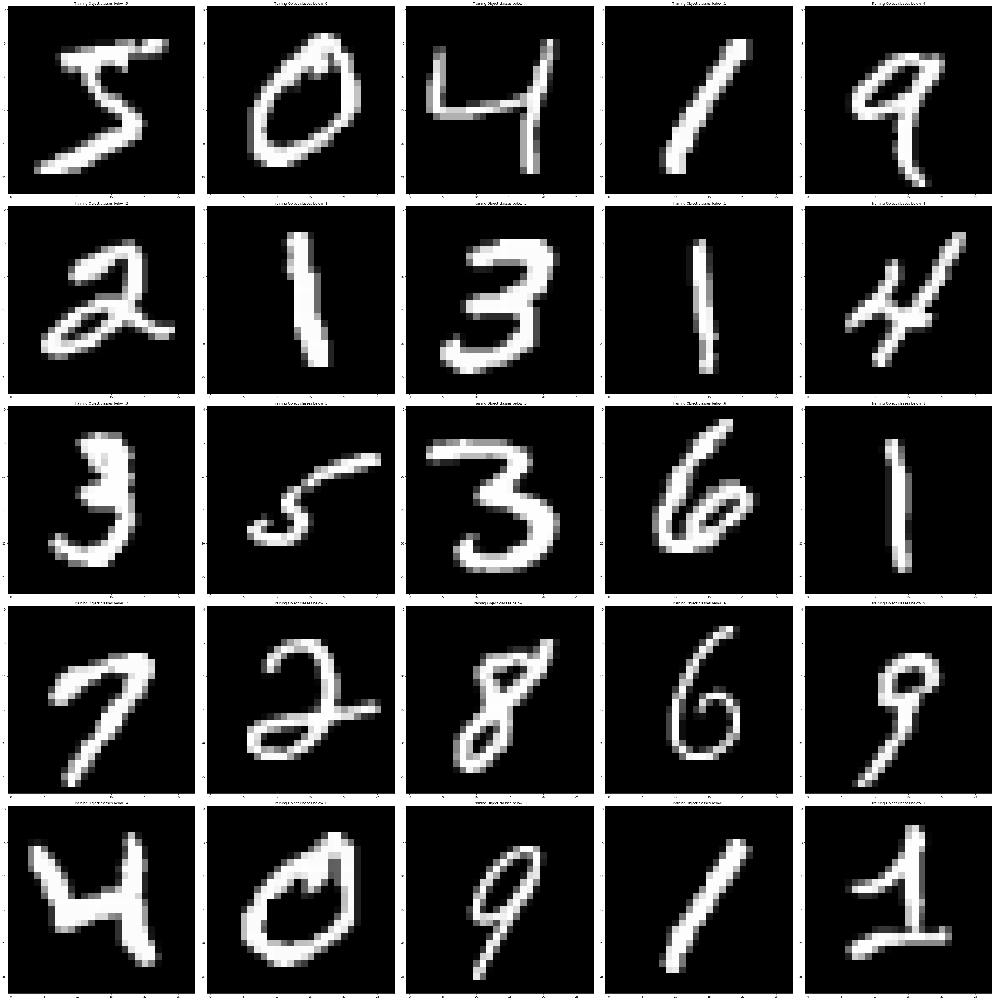

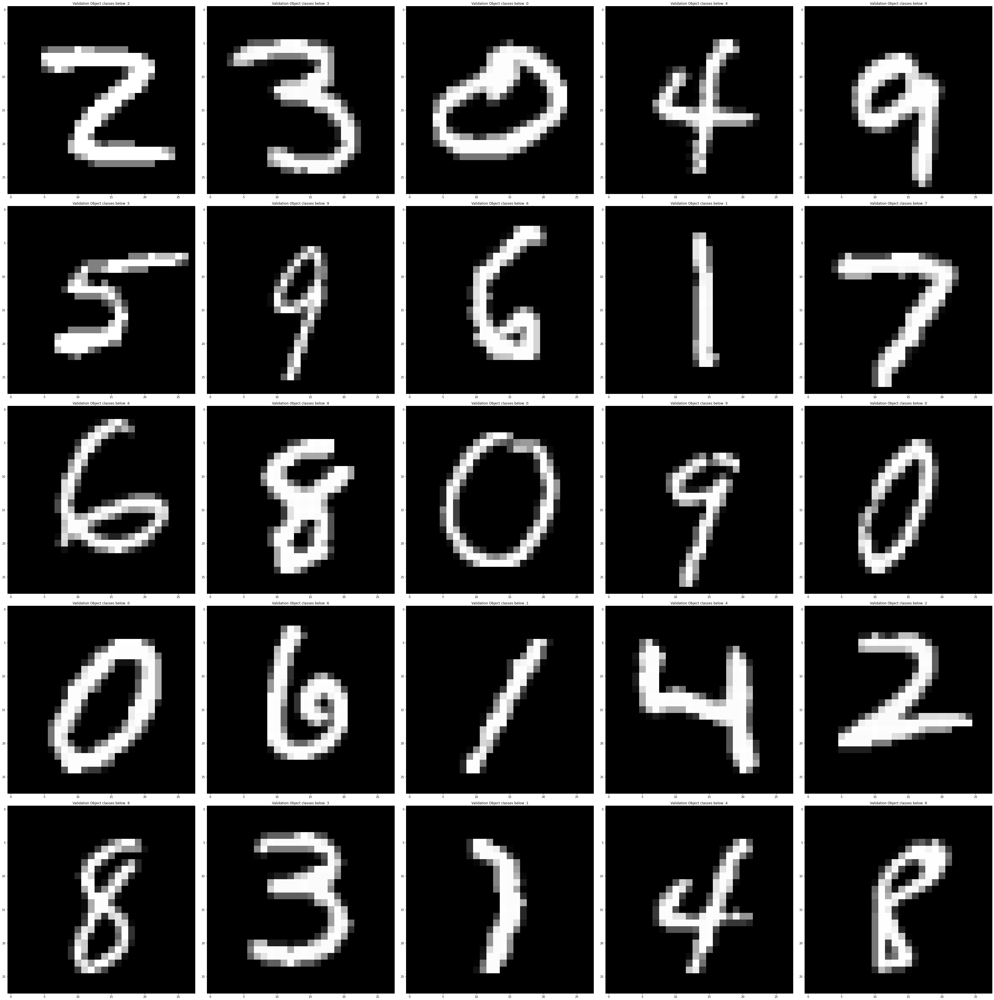

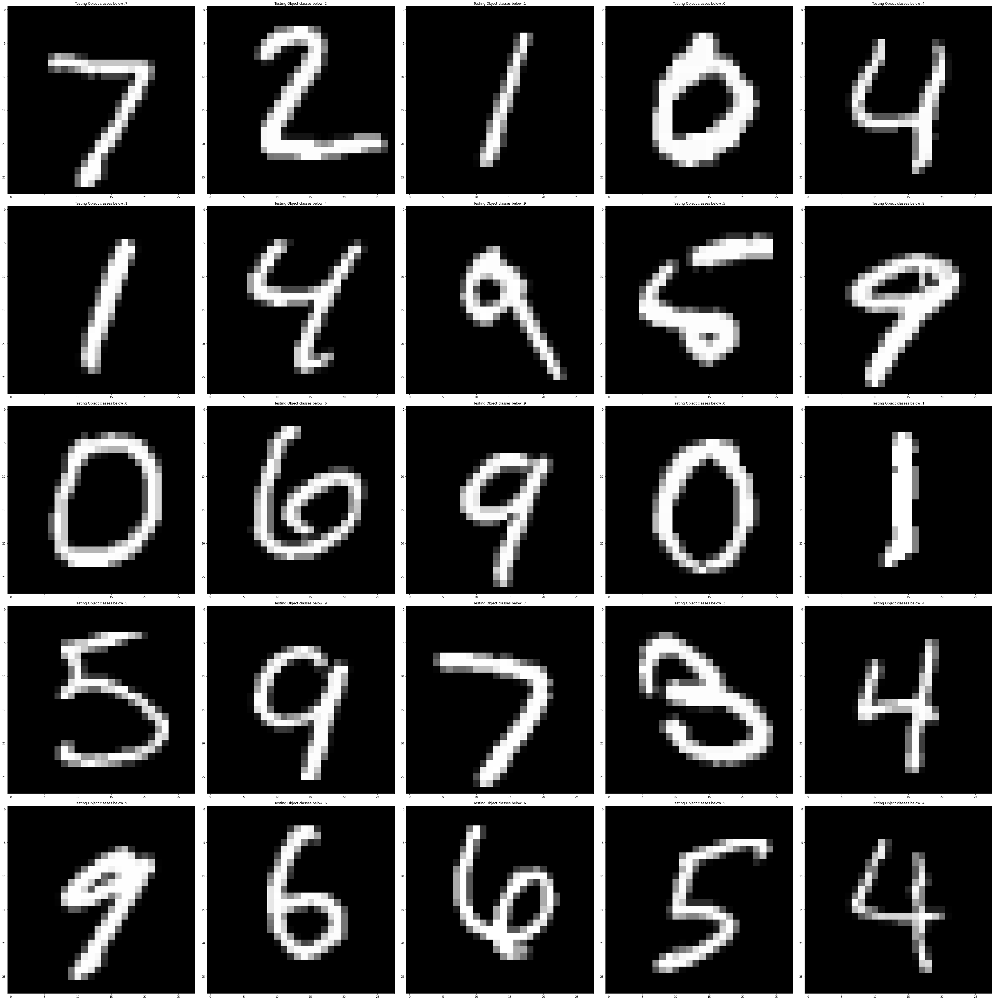

Is data augmentation applied : False
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 average_pooling2d (AverageP  (None, 14, 14, 6)        0         
 ooling2D)                                                       
                                                                 
 activation (Activation)     (None, 14, 14, 6)         0         
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 5, 5, 16)         0         
 ePooling2D)       

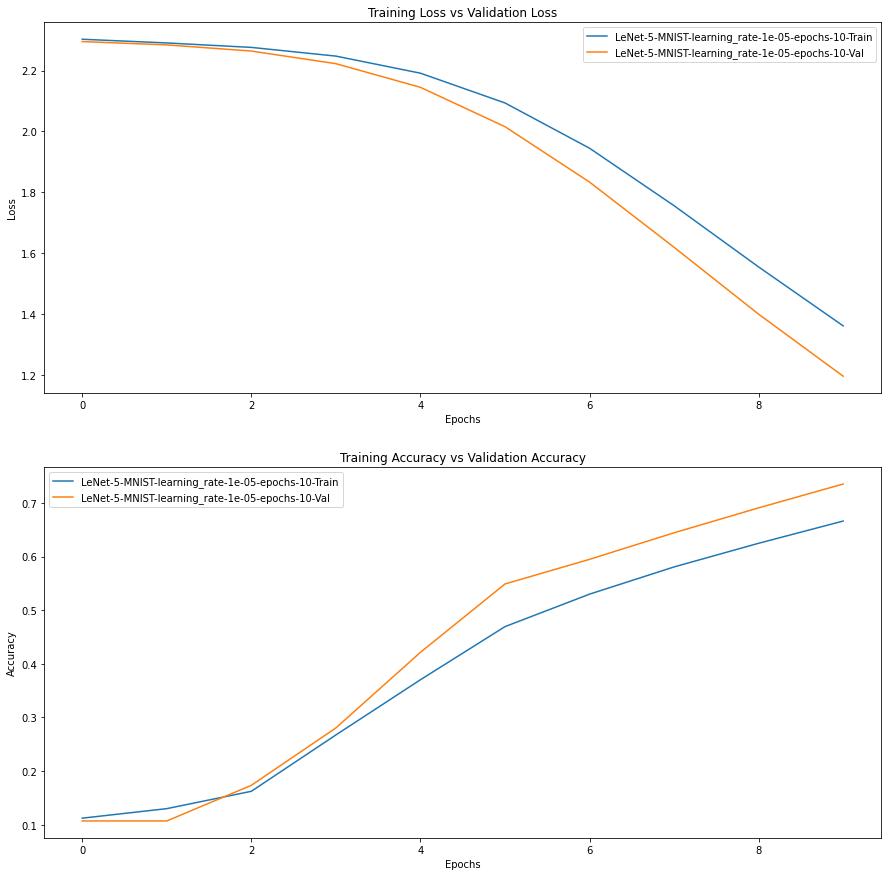

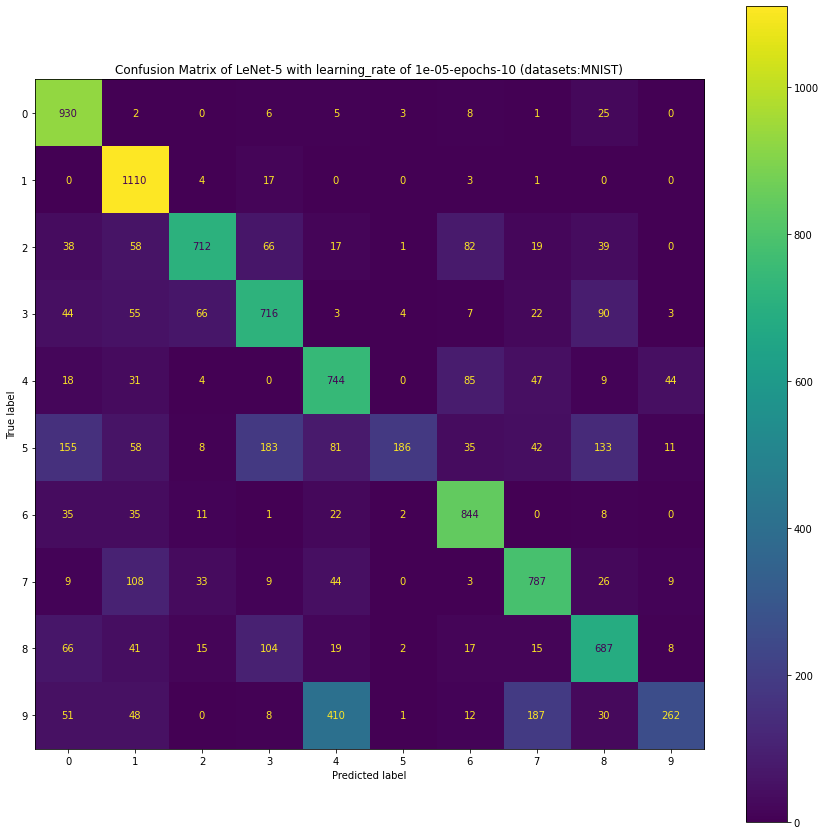

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


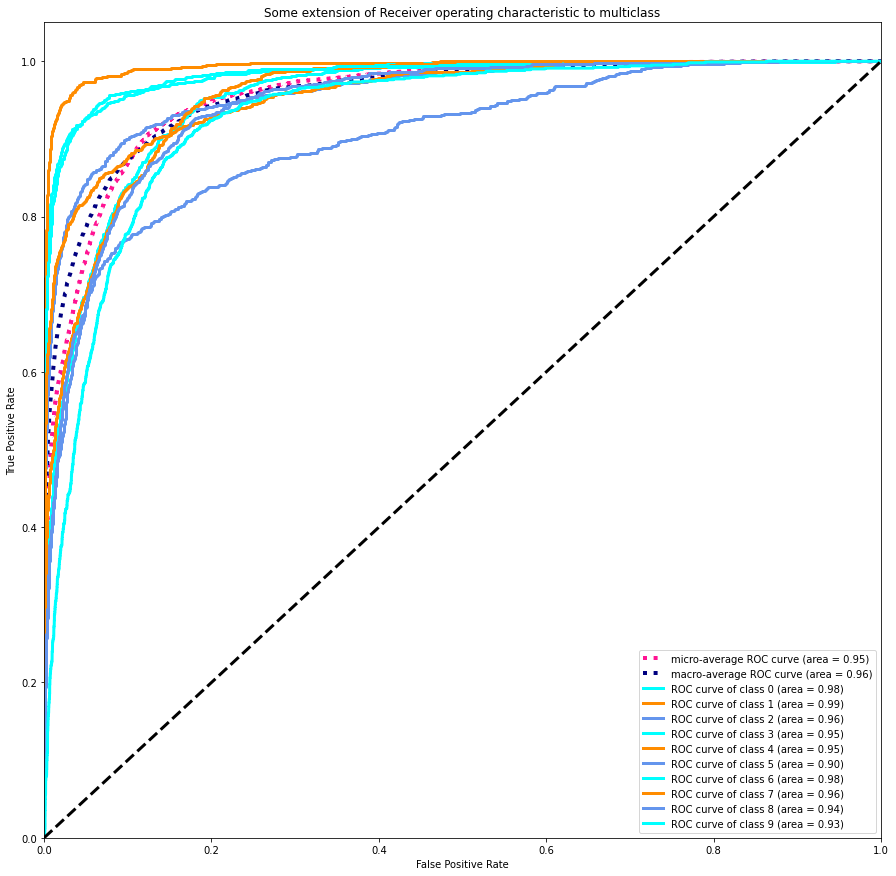

Confusion matrix, without normalization
[[ 930    2    0    6    5    3    8    1   25    0]
 [   0 1110    4   17    0    0    3    1    0    0]
 [  38   58  712   66   17    1   82   19   39    0]
 [  44   55   66  716    3    4    7   22   90    3]
 [  18   31    4    0  744    0   85   47    9   44]
 [ 155   58    8  183   81  186   35   42  133   11]
 [  35   35   11    1   22    2  844    0    8    0]
 [   9  108   33    9   44    0    3  787   26    9]
 [  66   41   15  104   19    2   17   15  687    8]
 [  51   48    0    8  410    1   12  187   30  262]]


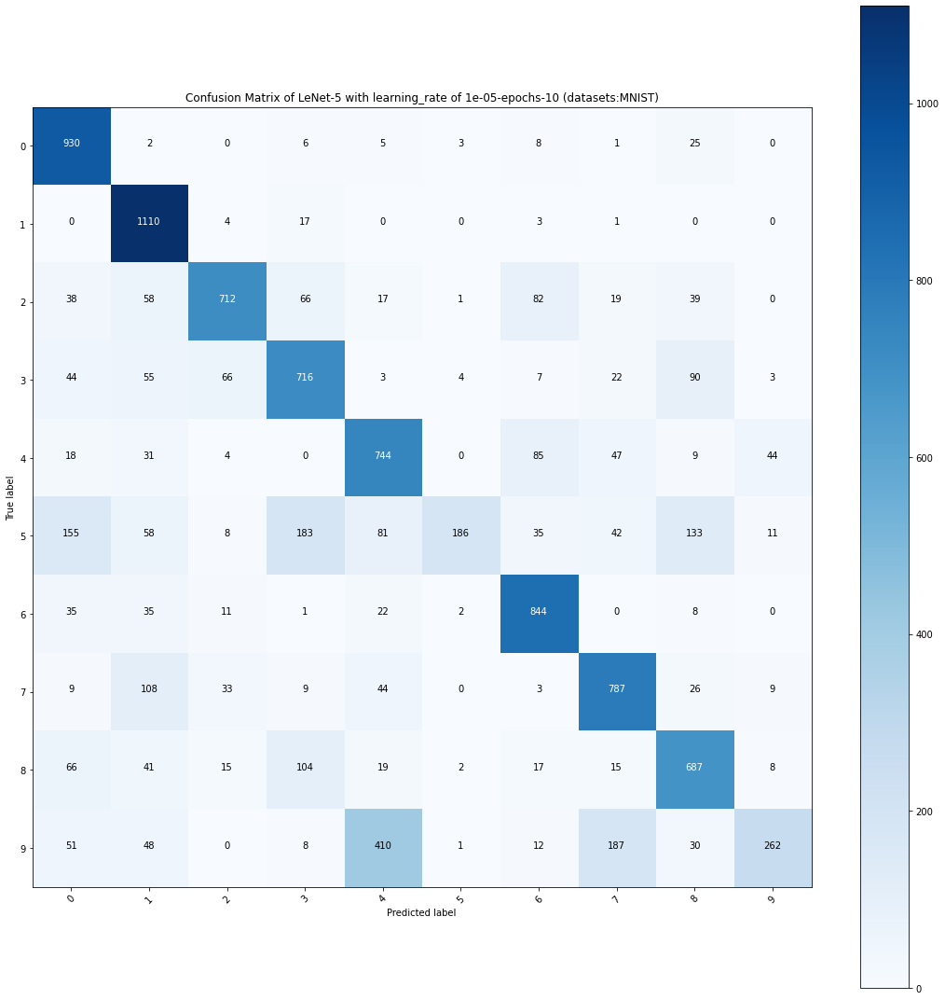

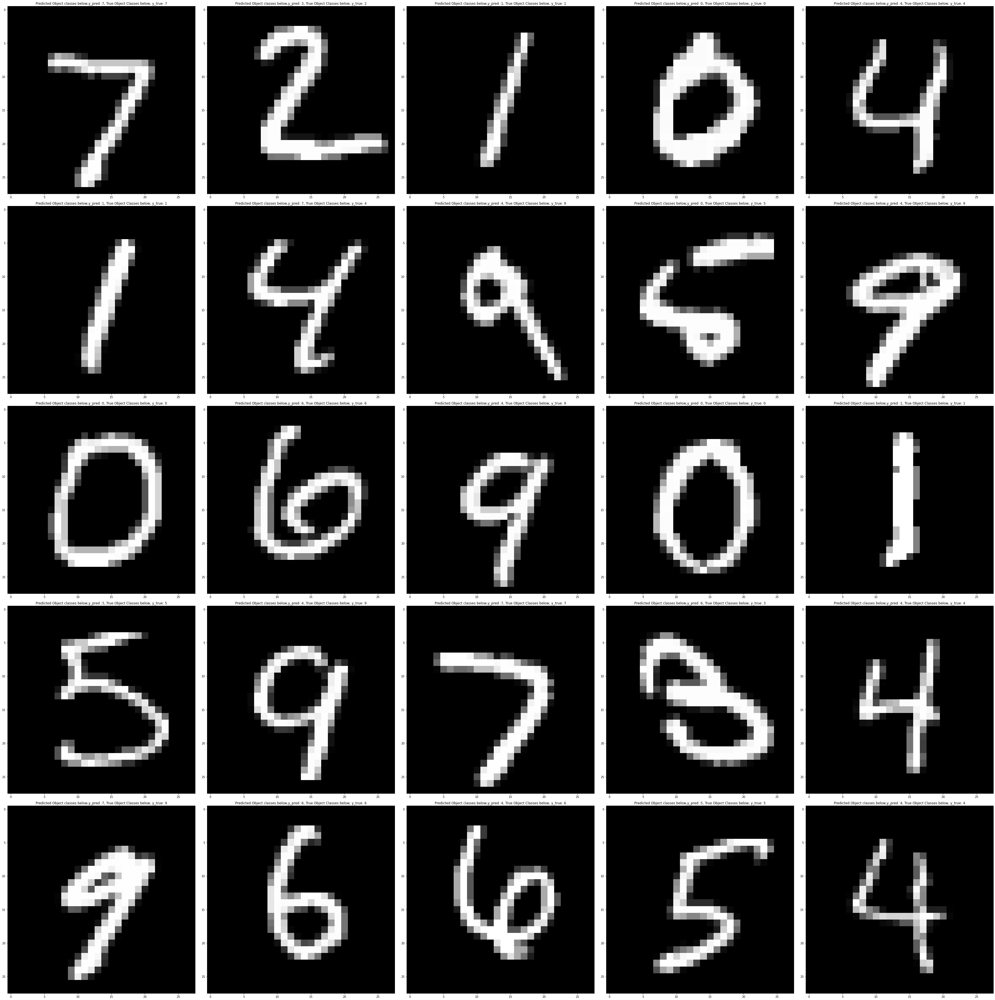

In [28]:
LEARNING_RATE = 0.00001
DATA_AUGMENTATION = False
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "LeNet-5"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_LeNet_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

## Model 12: CNN WITHOUT DATA AUGMENTATION (LEARNING RATE = 1E-5)
* learning rate = 0.00001
* Data Augmentation : False

x_train.shape = (58000, 28, 28, 3)
x_val.shape = (2000, 28, 28, 3)
x_test.shape = (10000, 28, 28, 3)
y_train.shape = (58000, 10)
y_val.shape = (2000, 10)
y_test.shape = (10000, 10)


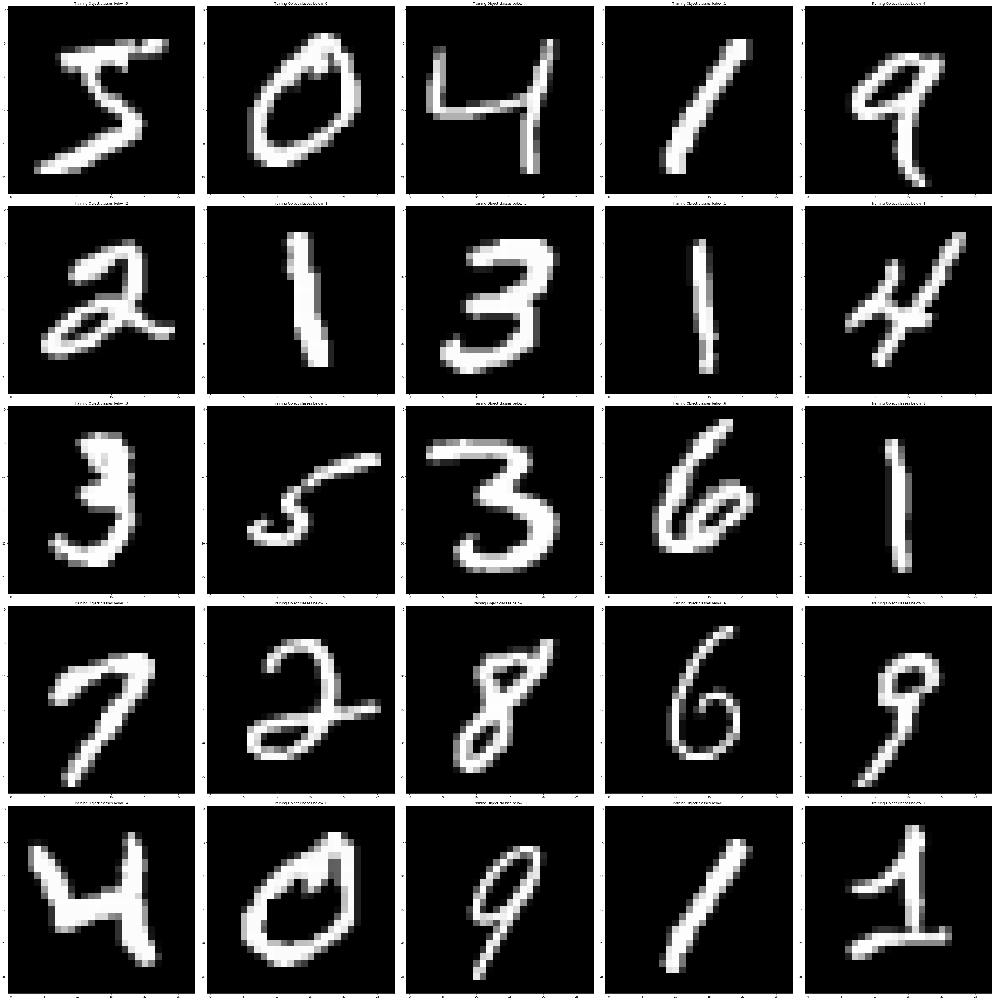

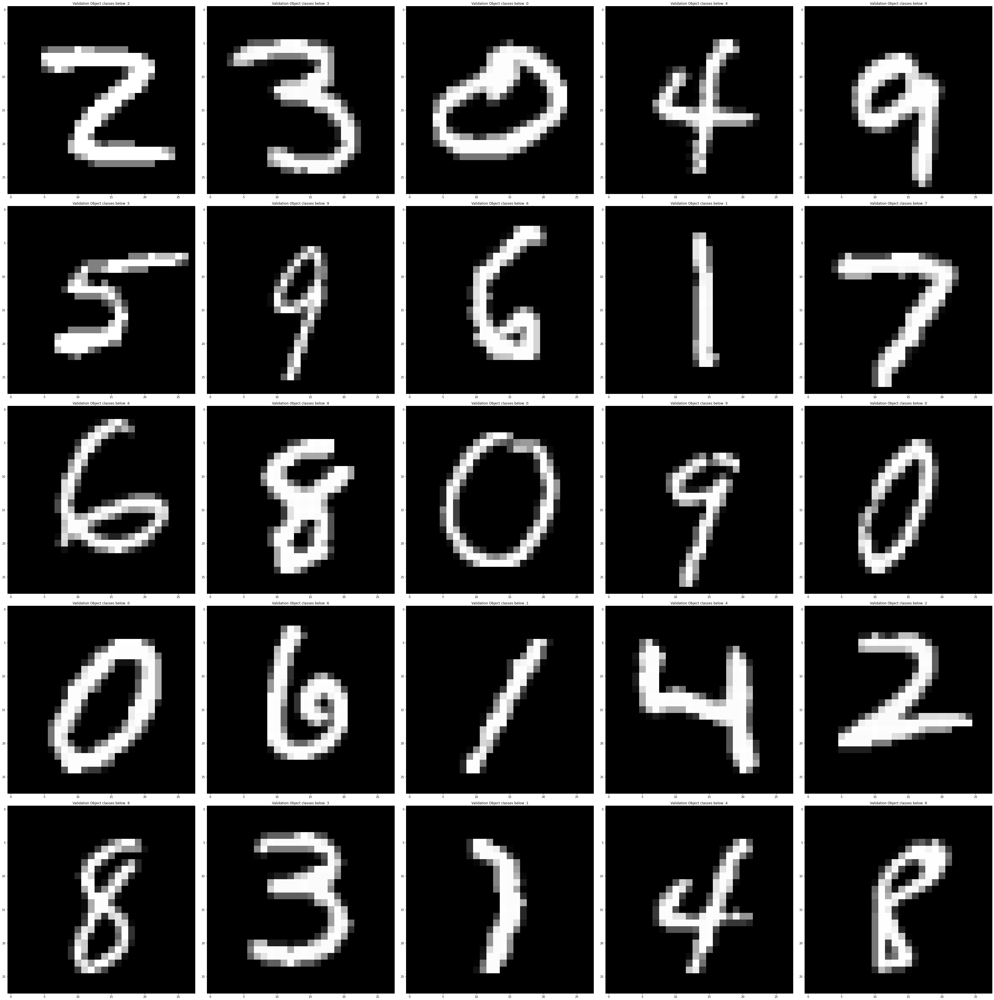

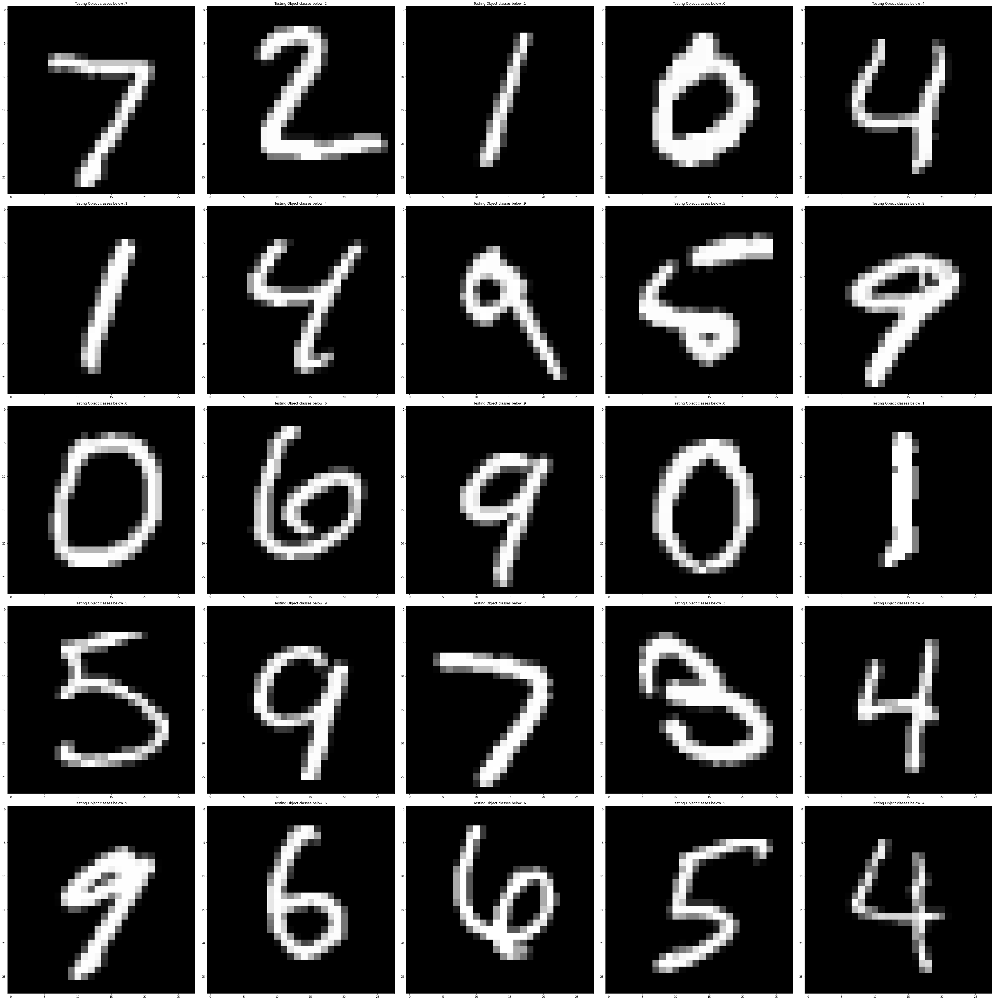

Is data augmentation applied : False
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 32, 32, 3)         0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 6)         456       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 14, 14, 6)        0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 10, 10, 16)        2416      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 5, 5, 16)         0         
 2D)                                                             
                                                                 
 flatten (Flatten) 

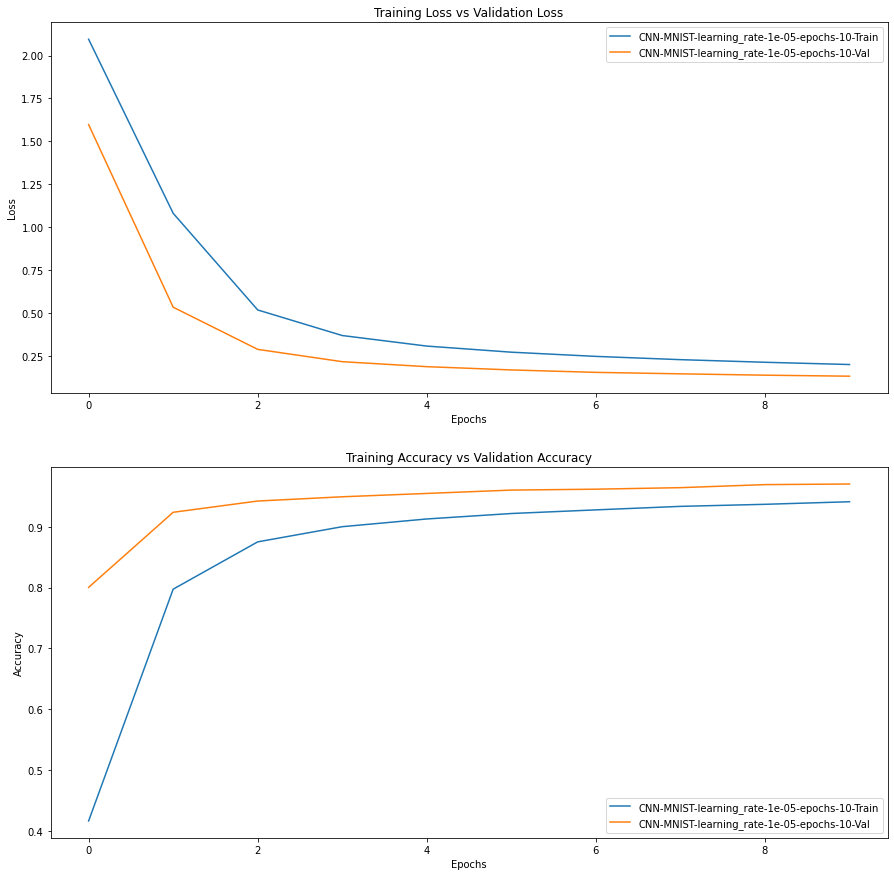

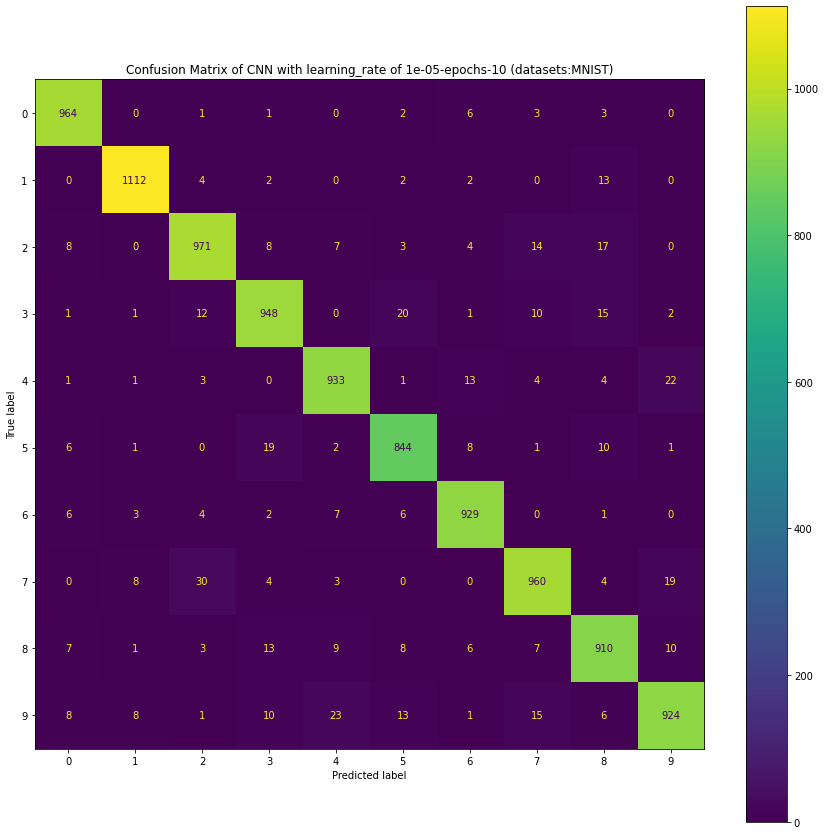

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:155: DeprecationWarning: scipy.interp is deprecated and will be removed in SciPy 2.0.0, use numpy.interp instead


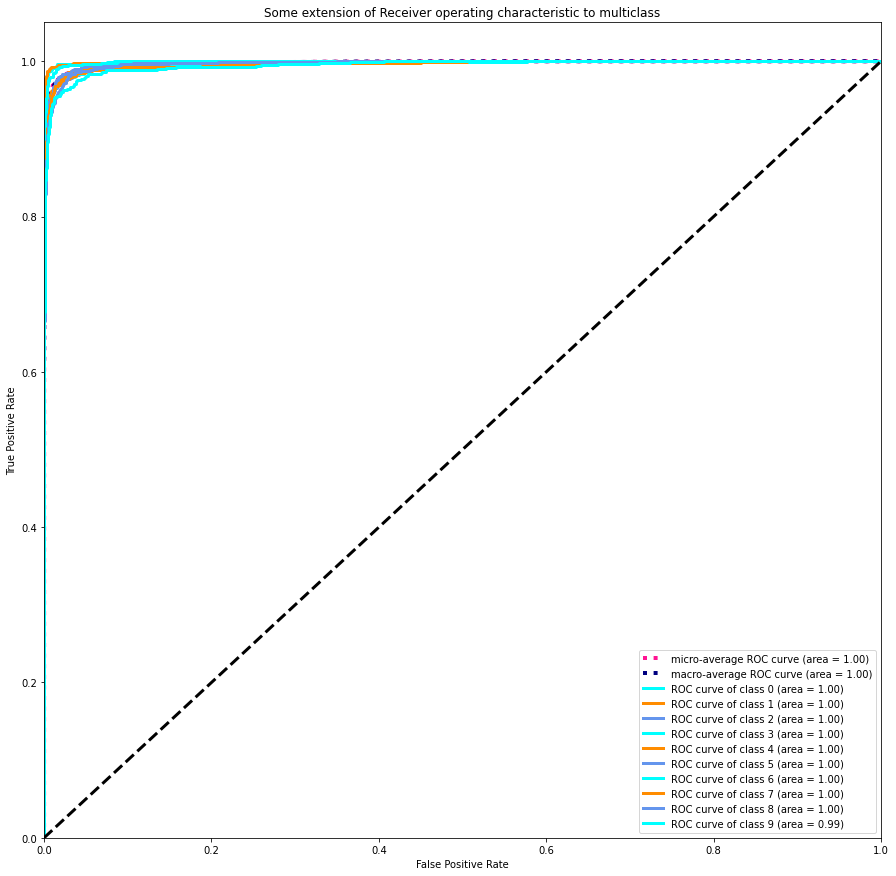

Confusion matrix, without normalization
[[ 964    0    1    1    0    2    6    3    3    0]
 [   0 1112    4    2    0    2    2    0   13    0]
 [   8    0  971    8    7    3    4   14   17    0]
 [   1    1   12  948    0   20    1   10   15    2]
 [   1    1    3    0  933    1   13    4    4   22]
 [   6    1    0   19    2  844    8    1   10    1]
 [   6    3    4    2    7    6  929    0    1    0]
 [   0    8   30    4    3    0    0  960    4   19]
 [   7    1    3   13    9    8    6    7  910   10]
 [   8    8    1   10   23   13    1   15    6  924]]


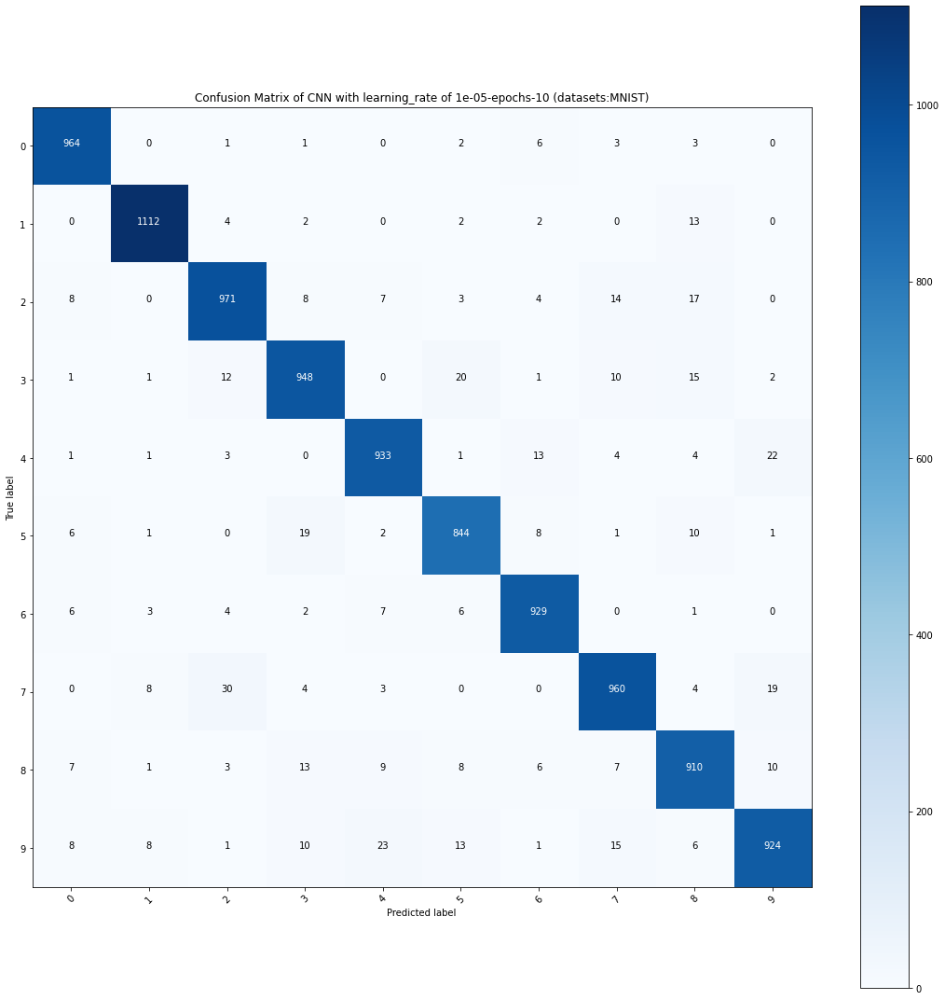

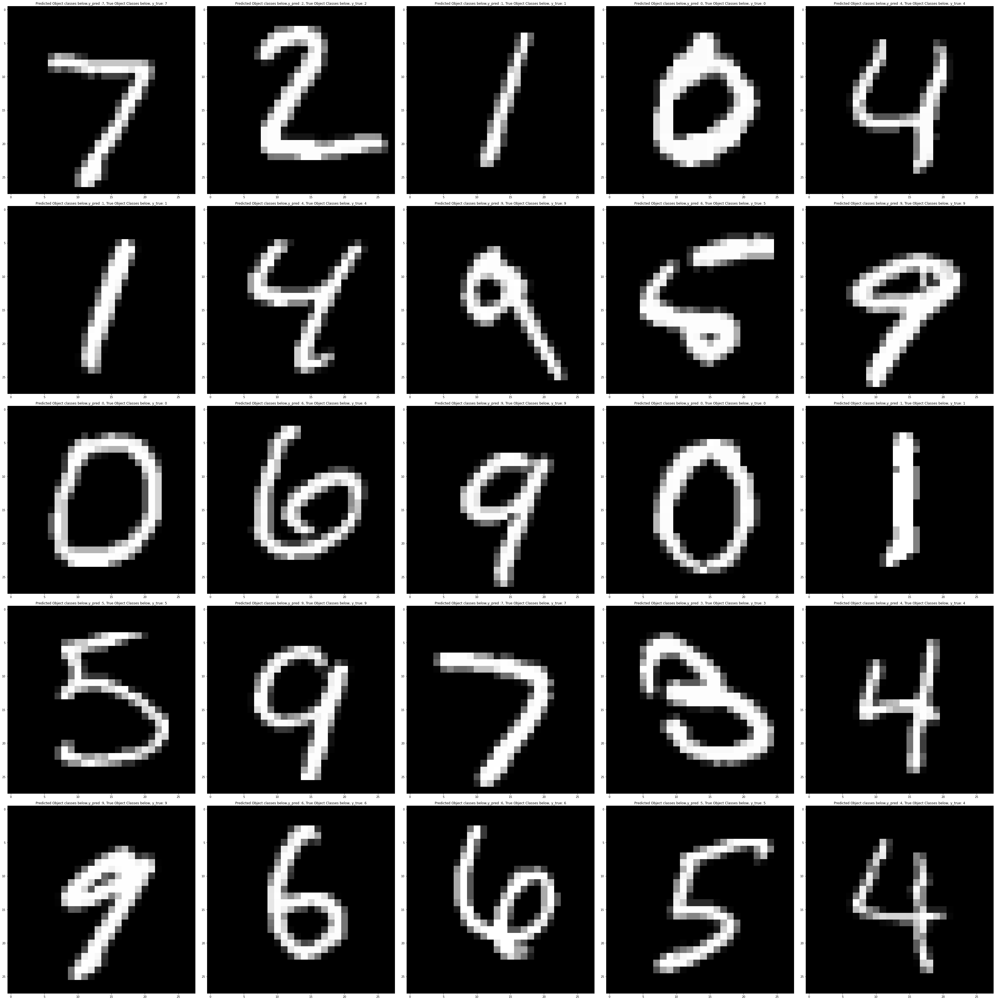

In [29]:
LEARNING_RATE = 0.00001
DATA_AUGMENTATION = False
EPOCHS = 10
BATCH_SIZE = 64
MODEL = "CNN"
DATASETS = "MNIST"
 # Declare Saved Model filename in h5py
SAVED_MODEL = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-model.h5"

  # Declare Saved Weight filename in h5py
SAVED_WEIGHT = f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-trained-weight.h5"

  # Declare logs directory to store the training and validation information
LOGS_DIR = f"logs/{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}"

  # Confusion Matrix title 
CONFUSION_MATRIX_TITLE = f"Confusion Matrix of {MODEL} with learning_rate of {LEARNING_RATE}-epochs-{EPOCHS} (datasets:{DATASETS})"

  # Plot graph title
PLOT_TITLE = [f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Train",f"{MODEL}-{DATASETS}-learning_rate-{LEARNING_RATE}-epochs-{EPOCHS}-Val"]

train_and_evaluate_CNN_mnist(learning_rate=LEARNING_RATE,
                               model = MODEL,                              
                               epochs = 10,
                               batch_size=64,
                               datasets = DATASETS,
                               n_valid = 2000,
                               logs_dir = LOGS_DIR,
                               data_augmentation = DATA_AUGMENTATION)

# Zip and Download File

In [30]:
%load_ext tensorboard
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [31]:
!zip -r "/content/LeNet-CNN-MNIST.zip" "/content/"

  adding: content/ (stored 0%)
  adding: content/.config/ (stored 0%)
  adding: content/.config/.last_update_check.json (deflated 24%)
  adding: content/.config/logs/ (stored 0%)
  adding: content/.config/logs/2022.05.03/ (stored 0%)
  adding: content/.config/logs/2022.05.03/13.42.27.306713.log (deflated 55%)
  adding: content/.config/logs/2022.05.03/13.42.06.910291.log (deflated 54%)
  adding: content/.config/logs/2022.05.03/13.41.39.801080.log (deflated 54%)
  adding: content/.config/logs/2022.05.03/13.41.59.446937.log (deflated 86%)
  adding: content/.config/logs/2022.05.03/13.41.17.129790.log (deflated 91%)
  adding: content/.config/logs/2022.05.03/13.42.28.055870.log (deflated 54%)
  adding: content/.config/active_config (stored 0%)
  adding: content/.config/.metricsUUID (stored 0%)
  adding: content/.config/.last_opt_in_prompt.yaml (stored 0%)
  adding: content/.config/config_sentinel (stored 0%)
  adding: content/.config/.last_survey_prompt.yaml (stored 0%)
  adding: content/.co

In [32]:
from google.colab import files

files.download('LeNet-CNN-MNIST.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>